# Workshop on the analysis and integration of scRNA-seq datasets



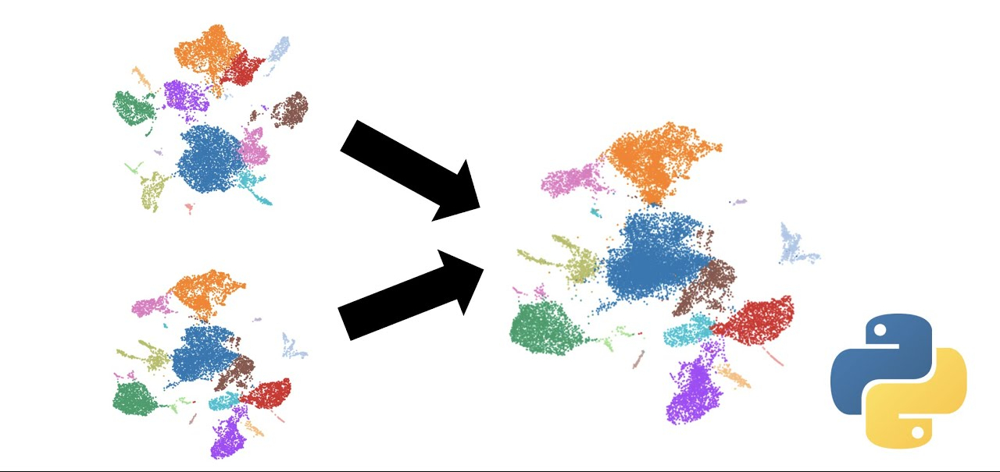

**Purpose:**

In this notebook, we will give an overview of scRNA-seq data analysis steps such as quality control, preprocessing, normalization, cell annotation. For a few selected integration methods, we will provide a hands-on application to show how multiple scRNA-seq datasets can be integrated.

In [1]:
#First we’ll need to import a bunch of useful tools.
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import scanpy
import os
import copy
import re
import seaborn as sns
from tqdm import tqdm, notebook
import scib as sc
from rpy2 import robjects
import re
import anndata2ri
from scipy import sparse
import warnings
import math
warnings.filterwarnings('ignore')
import time
from utils import *
import sys
s_entire_nb=time.time()

In [2]:
%load_ext rpy2.ipython

# 1 -  Dataset

### 1.1-- Load Dataset 

**The next step is to get some data to work with. To ease us into things we’ll start with the pancreas dataset**

* The data was downloaded from [scib's figshare repository](https://figshare.com/articles/dataset/Benchmarking_atlas-level_data_integration_in_single-cell_genomics_-_integration_task_datasets_Immune_and_pancreas_/12420968).
* If you are interested in how the dataset was collected, preprocessed and generated by [***Luecken et al.***](https://www.nature.com/articles/s41592-021-01336-8), you can check their reproducibility repository at https://github.com/theislab/scib-reproducibility/tree/main/notebooks/data_preprocessing/pancreas.
* In this notebook we will use AnnData objects that are a central data structure in Scanpy. It is a flexible data container that stores a matrix of gene expression counts or other data types, such as gene expression levels, binary gene presence/absence, or other high-dimensional data, along with annotations such as cell type or batch information. AnnData objects also store various preprocessed results, such as PCA or UMAP embeddings, clustering results, or differentially expressed genes, making it easy to explore and visualize scRNA-seq data using Scanpy's built-in plotting functions.



**Note** that our datasets are arranged as follows: rows correspond to cell IDs (cell names), and columns correspond to genes (features).
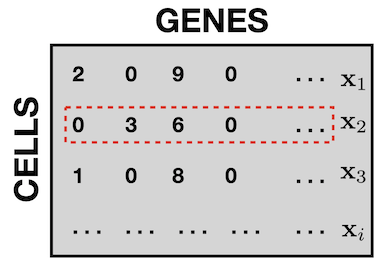

In [ ]:
#download the pancreas dataset
!pip install gdown
import gdown
'''
Since there are multiple datasets (e.g., Lung, Pancreas, etc.) in the Luecken et al. repository, 
it is necessary to define which data type we will be working on to distinguish 
between the outputs of the methods. 
In our case, we will focus solely on the pancreas dataset.
'''
data_type="pancreas"  
# Data file refers to the AnnData object that stores gene expression, batch, and cell type information.
input_dir="input/" #input folder
url="https://figshare.com/ndownloader/files/24539828"
# Data file refers to the AnnData object that stores gene expression, batch, and cell type information.
data_file_name="human_pancreas_norm_complexBatch.h5ad"
output = '{}/{}'.format(input_dir,data_file_name)
gdown.download(url, output, quiet=False)

Downloading...
From: https://figshare.com/ndownloader/files/24539828
To: /Volumes/DATA/Akd UNI/Sci_Prog/AI-scRNA-datasets-Workshop/input/human_pancreas_norm_complexBatch.h5ad
 78%|██████████████████████████████████████████████████████████████████████████████████▎                       | 245M/316M [01:54<00:32, 2.18MB/s]

In [ ]:
st_prep = time.time() #timer

# Create the necessary folders to store our outputs.
try:
    os.mkdir("output//{}/".format(data_type))
    os.mkdir("output/{}/workshop/".format(data_type))
except:
    pass

output_dir="output/{}/workshop/".format(data_type) #The location where we store the output of the methods.
r_input_dir="output/{}/workshop/R_input".format(data_type) #The location where we store the input dataset after preprocessing for R-based methods. 
try:
    os.mkdir(r_input_dir)
except:
    pass

In [ ]:
#Load dataset
organism="human" 
anndata=scanpy.read_h5ad("{}/{}.h5ad".format(input_dir,data_file_name))

In [5]:
anndata

AnnData object with n_obs × n_vars = 16382 × 19093
    obs: 'tech', 'celltype', 'size_factors'
    layers: 'counts'

**The main data structure in AnnData is the AnnData object, which consists of the following variables:**
*    **.X**: This variable contains the data matrix, which represents the expression levels of genes or other features across cells.


*    **.obs**: This variable contains the observations, or cell-level annotations, as a pandas DataFrame. This can include metadata such as cell type, sample ID, and experimental condition.

*    **.var**: This variable contains the variables, or gene-level annotations, as a pandas DataFrame. This can include metadata such as gene name, Entrez ID, and gene biotype.

*    **.obsm**: This variable contains the observation matrices, which store additional cell-level data, such as PCA or t-SNE embeddings, as numpy arrays.

*   **.varm**: This variable contains the variable matrices, which store additional gene-level data, such as gene loadings in PCA or gene scores in gene set enrichment analysis (GSEA), as numpy arrays.

*    **.uns**: This variable contains the unstructured annotations, which store additional information about the dataset, such as parameters used in preprocessing, clustering results, and differential expression analysis.

In [6]:
''' 
To access the normalized gene expression data, we can call anndata.X (for the NumPy-based matrix) 
or anndata.to_df() (for the pandas-based DataFrame).
'''
print("- There are {} cells.".format(anndata.X.shape[0]))
print("- There are {} features/genes.".format(anndata.X.shape[1]))
print("\n- Numpy Matrix: \n",anndata.X)
print("\n- Pandas DataFrame: ")
anndata.to_df().head()

- There are 16382 cells.
- There are 19093 features/genes.

- Numpy Matrix: 
 [[0.         0.         0.         ... 0.         0.         0.        ]
 [2.6120808  0.         0.         ... 0.         2.6120806  0.        ]
 [0.         3.311074   0.         ... 0.         0.         0.        ]
 ...
 [0.42996258 2.6206095  0.         ... 2.1124895  1.0953737  1.0403827 ]
 [3.4695568  0.64595073 0.         ... 0.         0.         0.        ]
 [0.4566651  0.5159923  0.         ... 0.         0.53929645 0.        ]]

- Pandas DataFrame: 


,A1BG,A1CF,A2M,A2ML1,A4GALT,A4GNT,AA06,AAAS,AACS,AACSP1,...,ZW10,ZWILCH,ZWINT,ZXDA,ZXDB,ZXDC,ZYG11B,ZYX,ZZEF1,ZZZ3
D101_5,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0
D101_43,2.612081,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,2.612081,0.0,0.0,3.269735,0.000000,0.0,2.612081,0.0
D101_93,0.000000,3.311074,0.0,0.000000,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.0,3.987740,0.000000,0.0,0.000000,0.0
D102_4,3.091586,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,3.091586,0.0,...,0.0,0.0,0.000000,0.0,0.0,3.763674,3.091586,0.0,3.091586,0.0
D172444_23,0.000000,3.292201,0.0,3.292201,0.0,0.0,0.0,0.0,0.000000,0.0,...,0.0,0.0,0.000000,0.0,0.0,0.000000,4.369601,0.0,0.000000,0.0


In [7]:
'''
let's explore the observations layer:
.obs: This variable contains the observations, or cell-level annotations, as a pandas DataFrame. 
This can include metadata such as cell type, sample ID, and experimental condition.
'''
anndata.obs.head()

,tech,celltype,size_factors
D101_5,celseq,gamma,0.028492
D101_43,celseq,gamma,0.079348
D101_93,celseq,gamma,0.037932
D102_4,celseq,gamma,0.047685
D172444_23,celseq,gamma,0.038683


In [8]:
'''
Batch information is stored in the observations layer (.obs), and in this specific dataset, it is stored
in the column "tech". However, this may vary from one dataset to another.
Therefore, we will assign a variable that stores the key in which the batch information is stored.
'''
batch_key="tech" 

'''
The cell type (label) information is stored in the (.obs) variable, and for this specific dataset, 
it is located in the "celltype" column. Again, this may differ among different datasets. 
Therefore, to accommodate for such differences, we will use a variable to store the key 
that represents the location of the cell type information.
'''
label_key="celltype" 

###  1.2 Select pairs of batches.

**Due to time restrictions and the long running time of some methods on the entire dataset, we will only focus on a subset of batch pairs. However, we will integrate multiple batches (or all batches) for some methods at the end of this notebook and provide outputs of some methods that have high time complexity and long running time.**

In [9]:
'''
List all batch (techs) IDs
'''
print(np.unique(anndata.obs[batch_key]))

['celseq' 'celseq2' 'fluidigmc1' 'inDrop1' 'inDrop2' 'inDrop3' 'inDrop4'
 'smarter' 'smartseq2']


Based on our previous experiments, we have decided to focus on two pairs of batches: **celseq/celseq2** and **inDrop2/inDrop4**. The reason for selecting these two pairs is due to the distribution of cell types (which we will explore later) and their performance in terms of evaluation scores on some methods. For some methods, **celseq/celseq2** show high integration scores, while **inDrop2/inDrop4** show low integration scores, and vice versa for other methods.

In [10]:
#Selected pairs for our analysis
selected_pairs=[("celseq","celseq2"),("inDrop2","inDrop4")]

#dictionary that holds our data objects for each pair
data_objects={}
for pair in selected_pairs:
    data_objects["{}_{}".format(pair[0],pair[1])]=anndata[list(anndata.obs[anndata.obs[batch_key].isin([pair[0],pair[1]])].index)]
    print("The shape of the data for {} is {}.".format(pair,data_objects["{}_{}".format(pair[0],pair[1])].to_df().shape))


The shape of the data for ('celseq', 'celseq2') is (3289, 19093).
The shape of the data for ('inDrop2', 'inDrop4') is (3027, 19093).


# 2 - Preprocessing

### 2.1 Highly Variable Genes (HVGs)

**Introduction:**

Highly variable genes (HVGs) are genes that exhibit significant variability in their expression levels across cells within a population. These genes are often identified as a preprocessing step in single-cell RNA sequencing (scRNA-seq) analysis to reduce the dimensionality of the data and to focus on the most informative genes. HVGs are typically selected based on their dispersion, or the difference between their variance and mean expression levels, and are used in downstream analyses such as clustering and cell type identification.

----------------------------
In this notebook, we can choose to either include all genes (features) in the original data or select highly variable genes (HVGs) using the scIB HVG selection method. To do so, we can set the value of the variable "**hvg_type**" to "***full***" for full features or "***hvg_scib***" to select the top HVG genes using the scIB method.

The variable **hvg** determines the number of highly variable genes to use (default is **2000**)

-----------
**Batch-aware highly variable gene selection (Cell ranger method)**

* Method to select HVGs based on mean dispersions of genes that are highly variable genes in all batches.
* Since the method is batch-aware, highly-variable genes are selected within each batch separately and merged.
* This simple process avoids the selection of batch-specific genes and acts as a lightweight batch correction method.
- Workflow:
    -  For each batch:
        * Genes were placed into 20 (default) bins based on their mean expression.
        * Normalized dispersion is calculated as the absolute difference between dispersion (variance/mean) and median dispersion of the expression mean, normalized by median absolute deviation within each bin.
        * Top n HVG selected based on normalized dispersion.
     
    * Sort genes by how often they selected as hvg within each batch and break ties with normalized dispersion across batches.
    * Select top *n* HVG.

**Parameters:**

* adata: ``anndata`` object
* batch_key: ``adata.obs`` column
* target_genes (default=2000):  Number of highly-variable genes to keep.
* n_bins (default=20): Number of bins for binning the mean gene expression.
* adataOut (default=False): Whether to return an ``anndata`` object or a list of highly variable genes


In [11]:
hvg_type="hvg_scib"
hvg=2000

In [59]:
print(" ⦿ Computing highly variable genes  ...")
adata=anndata.copy()
if hvg_type.lower()=="full":
    for pair in data_objects:
        print("   • {}".format(pair))
        data_objects[pair].var["highly_variable"]=data_objects[pair].var_names

elif hvg_type.lower()=="hvg_scib":
    for pair in data_objects:
        print("   • ",pair)
        data_objects[pair]=sc.preprocessing.hvg_batch(
                            data_objects[pair].copy(),
                            batch_key=batch_key,
                            target_genes=hvg,
                            adataOut=True
                        )
    
else:
    print("!!!! Please select either 'full' or 'hvg_scib'")
print("   • Computing highly variable genes is completed ... ")

 ⦿ Computing highly variable genes  ...
   •  celseq_celseq2
Using 1983 HVGs from full intersect set
Using 17 HVGs from n_batch-1 set
Using 2000 HVGs
   •  inDrop2_inDrop4
Using 1918 HVGs from full intersect set
Using 82 HVGs from n_batch-1 set
Using 2000 HVGs
   • Computing highly variable genes is completed ... 


### 2.2 Scaling

**Intorduction**

The purpose of scaling the gene expression data is to make the gene expression values comparable across cells by removing the differences in their means and variances. This is important because the magnitudes of gene expression values can vary greatly between cells, and this variation can be due to technical factors such as sequencing depth or biological factors such as differences in cell size or cell cycle stage. Scaling the data helps to remove these effects so that the gene expression values can be more accurately compared between cells. It also helps to reduce the influence of highly expressed genes on downstream analyses.

------
The idea is to scale counts to a mean of 0 and standard deviation of 1 using ``scanpy.pp.scale`` for each batch separately.

In [13]:
'''
scale: set to true to activate scaling
default, we set it to False, as it did not show good performance in 
the benchmarking studies
'''

scale=False
if scale:
    print(" ⦿ Data scaling ...")
    for pair in data_objects:
        print("   • {}".format(pair))
        data_objects[pair]=sc.preprocessing.scale_batch(data_objects[pair], batch_key)
    print("   • Data scaling is complete ... ")


### 2.3 Exporting the preprocessed data for R-based methods

In this step, we conver the Scanpy objects to a Seurat object, a data structure used in the R package Seurat, which is commonly used for single-cell RNA sequencing data analysis. It stores the preprocessed and normalized gene expression data, cell metadata information (such as cell type and batch information), dimensionality reduction results, and clustering results. The Seurat object can be used for downstream analysis such as differential gene expression analysis, cell type identification, and visualization.

In [14]:
print(" ⦿ Converting to Seurat objects ...")
for pair in data_objects:
    print("   • Exporting {}'s data".format(pair))
    filename="[{}_{}]_[{}_features]{}.h5ad".format(data_type,pair,hvg_type,"_[Scaled]" if scale else "")
    r_full_path="{}/{}".format(r_input_dir,filename)
                                          
    sc.preprocessing.save_seurat(data_objects[pair],r_full_path,batch_key)
    print("   • The R seurat object is saved at: ",r_full_path)

 ⦿ Converting to Seurat objects ...
   • Exporting celseq_celseq2's data

    consider that it could be called from a Python process. This
    results in a quasi-obligatory segfault when rpy2 is evaluating
    R code using it. On the hand, rpy2 is accounting for the
    fact that it might already be running embedded in a Python
    process. This is why:
    - Python -> rpy2 -> R -> reticulate: crashes
    - R -> reticulate -> Python -> rpy2: works

    The issue with reticulate is tracked here:
    https://github.com/rstudio/reticulate/issues/208
       • The R seurat object is saved at:  output/pancreas/workshop/R_input/[pancreas_celseq_celseq2]_[hvg_scib_features].h5ad
   • Exporting inDrop2_inDrop4's data
   • The R seurat object is saved at:  output/pancreas/workshop/R_input/[pancreas_inDrop2_inDrop4]_[hvg_scib_features].h5ad


In [15]:
et_prep = time.time() #timer
print("-------------\n ⦿ The preprocessing steps have been completed in : ",et_prep-st_prep," seconds\n-------------")

-------------
 ⦿ The preprocessing steps have been completed in :  34.739376068115234  seconds
-------------


# 2. Exploratory Data Analysis (EDA)

### 2.1 Umap Plots


In [16]:
st_eda = time.time() #timer
import collections
import matplotlib.pyplot as plt

#### 2.1.1 Introduction
High-dimensional data can be difficult to visualize and interpret, especially when the number of dimensions (features) exceeds three. 

**Reducing** the size of high-dimensional data to a lower dimension can help make it easier to visualize and interpret. By reducing the number of dimensions, we can create plots and visualizations that are easier to understand and interpret. For example, if we have data with 10 dimensions, reducing it to two or three dimensions can make it much easier to visualize and interpret.

There are several techniques that can be used to reduce the size of high-dimensional data, including principal component analysis (PCA), t-distributed stochastic neighbor embedding (t-SNE), Uniform Manifold Approximation and Projection (UMAP), and multidimensional scaling (MDS). These methods aim to preserve the most important information in the data while reducing its dimensionality.

------
UMAP (Uniform Manifold Approximation and Projection) is a dimensionality reduction technique that can be used to visualize high-dimensional data in a lower-dimensional space, such as a 2D or 3D plot. UMAP is particularly useful for visualizing large datasets, because it is able to capture the global structure of the data while still preserving local details. This makes it a popular choice for visualizing single-cell RNA sequencing data, which can have tens of thousands or even hundreds of thousands of cells. By using UMAP, we can get a sense of how the cells are related to each other and identify clusters of cells with similar gene expression patterns.

---------


In [17]:
scanpy.set_figure_params(figsize=(10,10)) # size of the scanpy-based figures

 ⦿ Plotting scatterplots for each dataset...


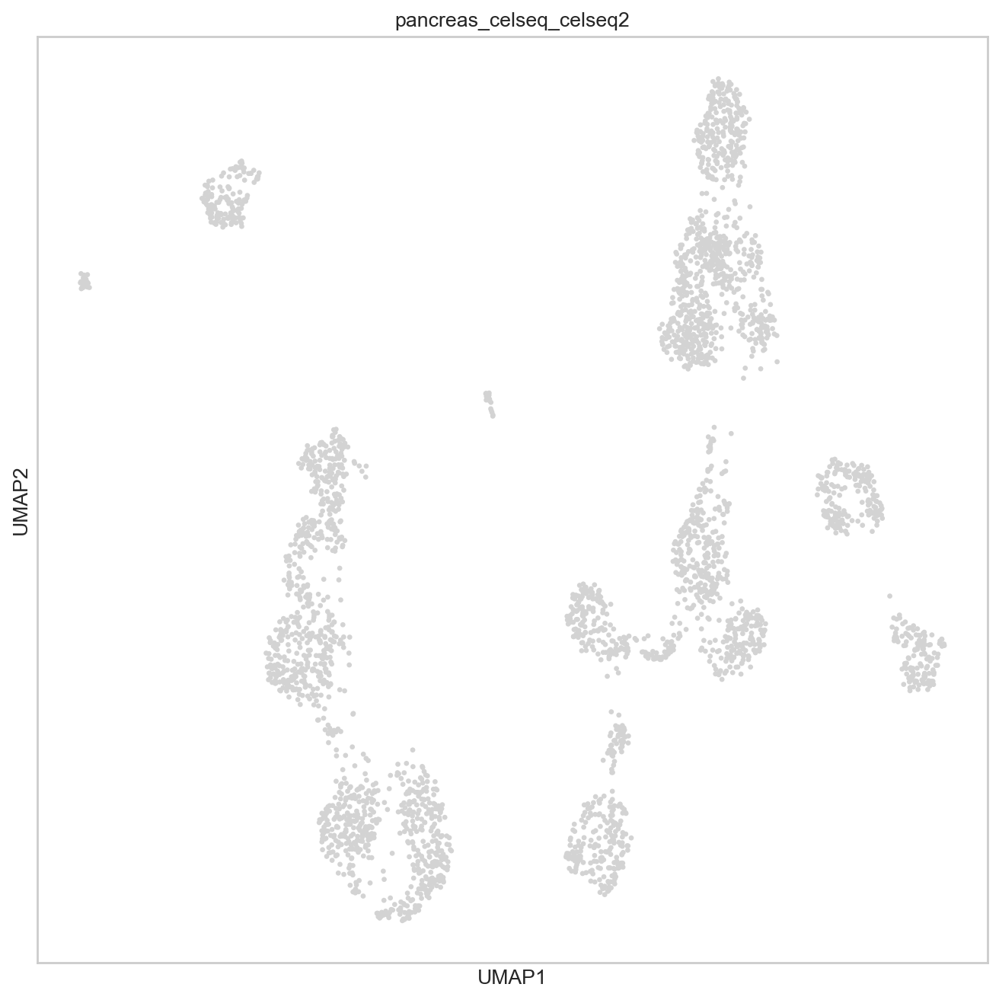

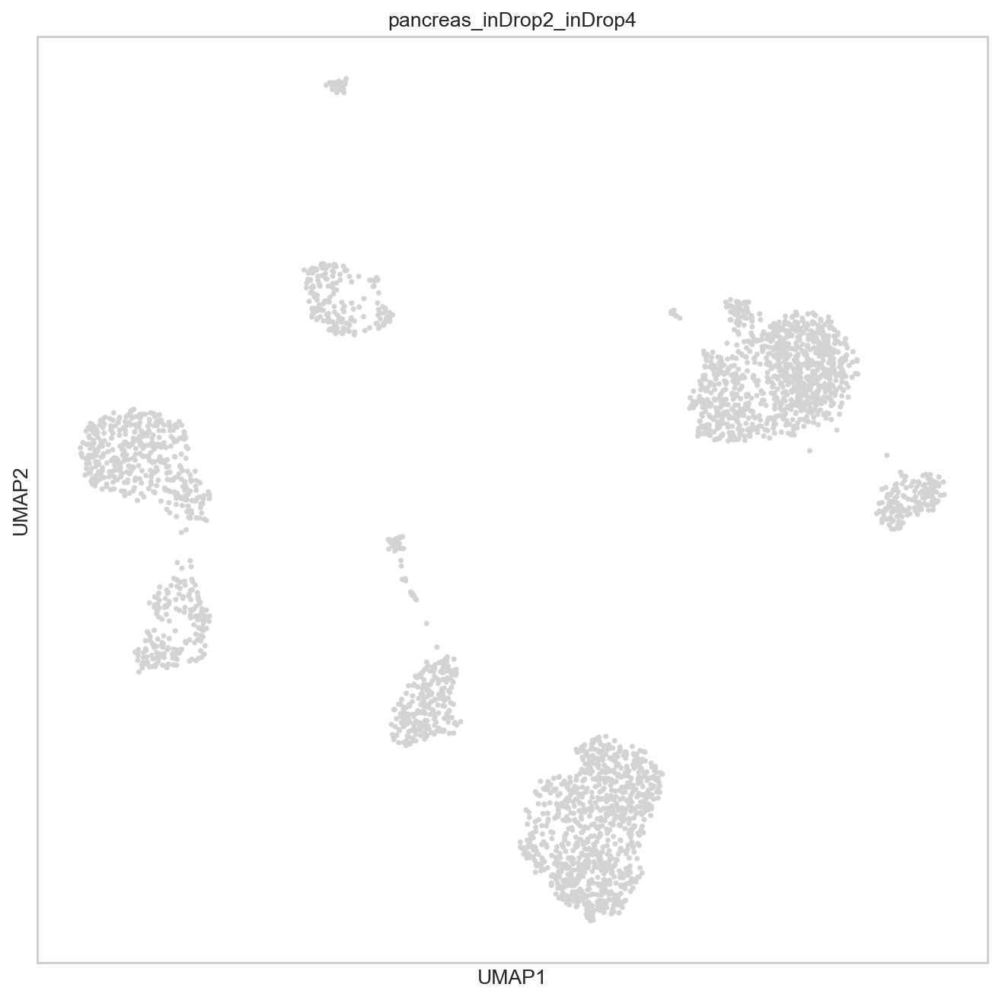

In [63]:
import copy
print(" ⦿ Plotting scatterplots for each dataset...")
for pair in data_objects:
    '''
    scanpy.pp.neighbors is a function in the Scanpy package that performs 
    the neighborhood graph construction for single-cell RNA sequencing (scRNA-seq) 
    data. The neighborhood graph is a graph representation of the scRNA-seq data, 
    where each cell is a node in the graph and edges connect cells that are close to
    each other in gene expression space.
    '''
    scanpy.pp.neighbors(data_objects[pair])
    
    '''
    scanpy.tl.umap is a function in the Scanpy package that performs UMAP
    on single-cell RNA sequencing (scRNA-seq) data.
    '''
    scanpy.tl.umap(data_objects[pair])
    
    '''
    scanpy.pl.umap is a function in the Scanpy package that creates a 2D scatter plot of cells 
    in the reduced dimensional space obtained from UMAP. 
    It takes a Scanpy AnnData object that has already been preprocessed and reduced 
    to lower dimensions using UMAP and generates a scatter plot of the cells in the 
    reduced dimensional space.
    '''
    scanpy.pl.umap(data_objects[pair],title="{}_{}".format(data_type,pair))
    plt.show()
    

#### 2.1.4 Using color to represent data categories in a scatterplot

he function ***scanpy.pl.umap*** allows the user to customize various aspects of the plot, such as the color of the points, the size of the points, and the labels. It can also be used to overlay additional information on the plot, such as gene expression levels or metadata associated with each cell. This can be done by passing the key in ***.obs*** that stores this information, for example, if coloring based on cell types, one can pass ***label_key***, and if based on batch information, one can pass ***batch_key***. The umap.plot.points function will color the data with a categorical colormap according to the labels provided.

#### 2.1.4.1 Using batch labels to assign colors to data Points

 ⦿ Plotting scatterplots for each dataset...


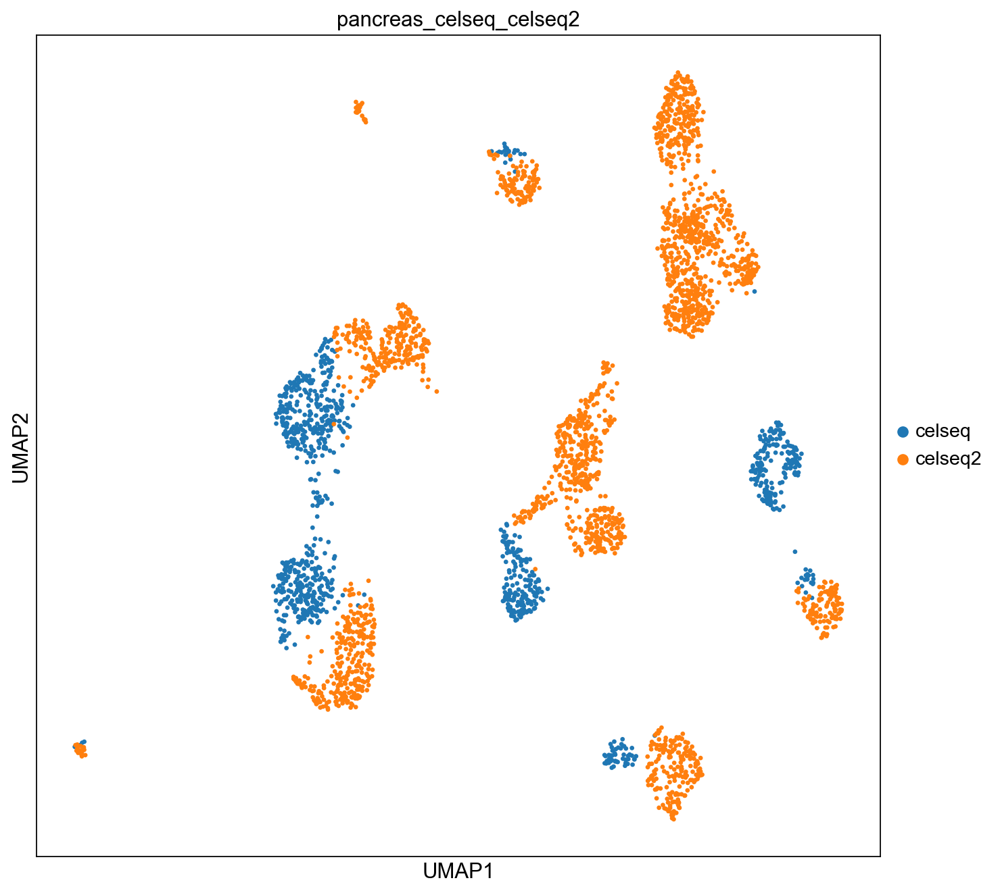

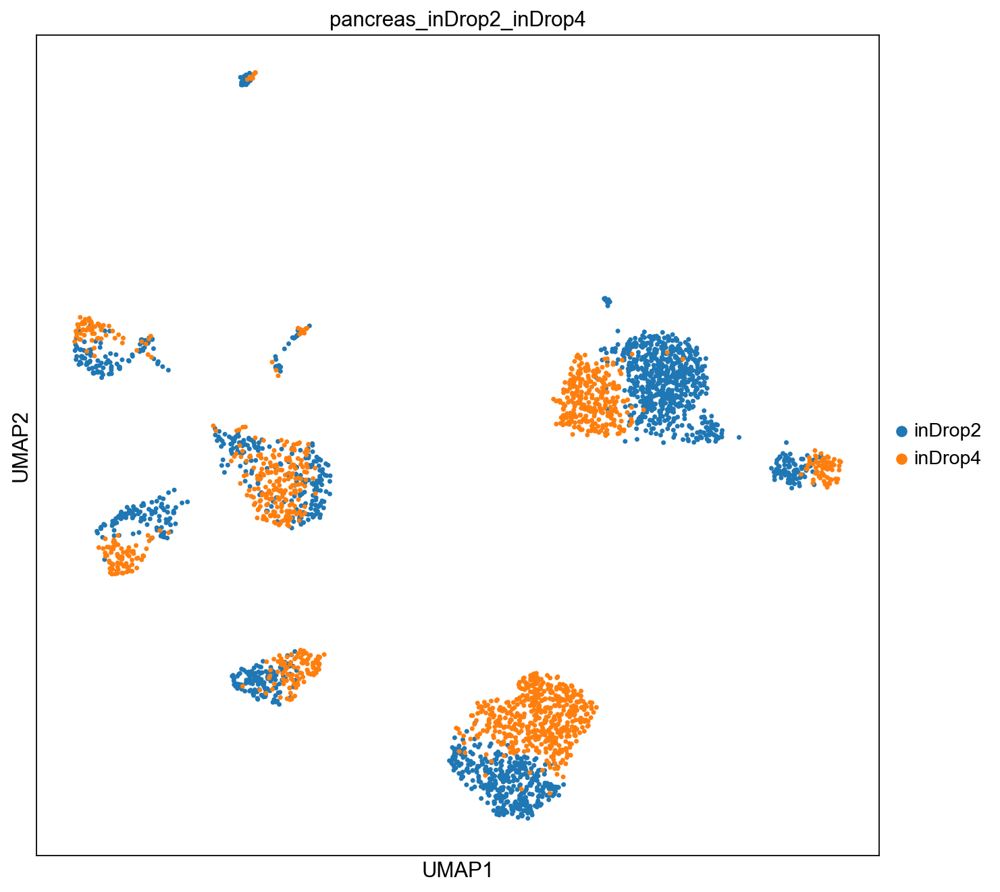

In [19]:
print(" ⦿ Plotting scatterplots for each dataset...")
for pair in data_objects:
        scanpy.pl.umap(data_objects[pair],title="{}_{}".format(data_type,pair),color=batch_key)
       

***Comment:*** Based on the UMAP plot of the single cell dataset colored based on batch information, it appears that the data points are grouped together based on their respective batches. This suggests that there may be batch effects present in the dataset, where variations in experimental conditions across different batches have influenced the expression levels of genes in the cells.

Batch effects can have a significant impact on downstream analysis, as they can lead to the identification of spurious biological signals or mask true biological variation. Therefore, it is important to carefully account for batch effects in the analysis of single cell datasets.

#### 2.1.4.2 Using cell types (labels) to assign colors to data Points

 ⦿ Plotting scatterplots for each dataset...


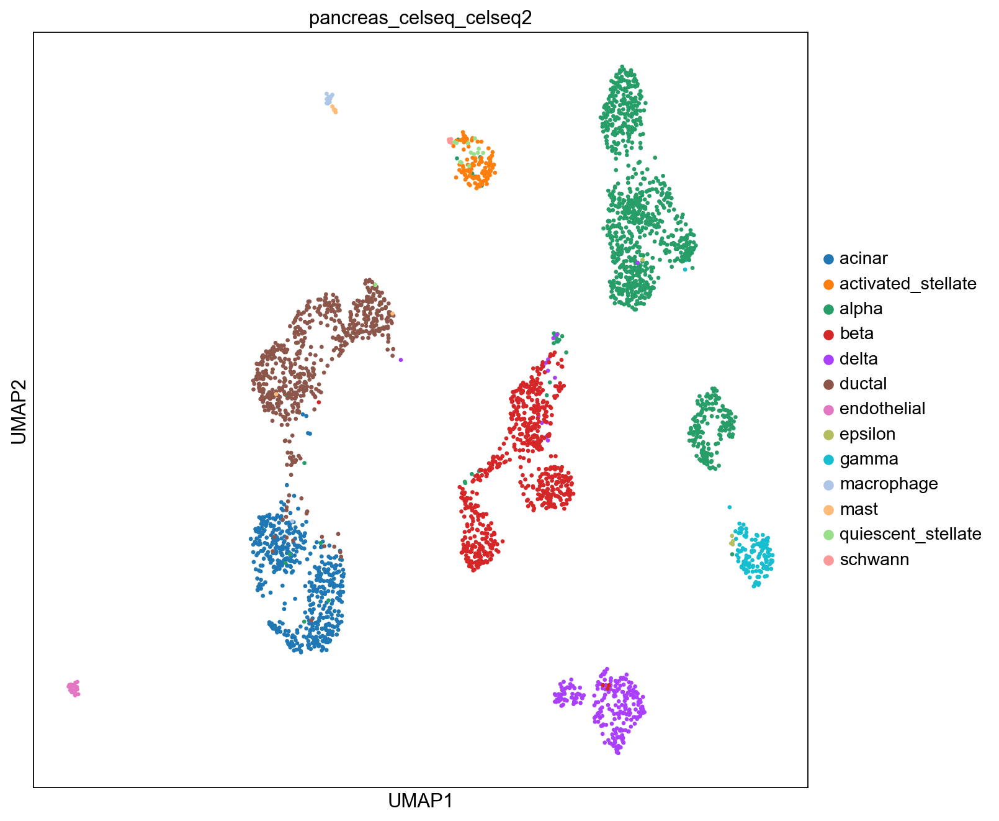

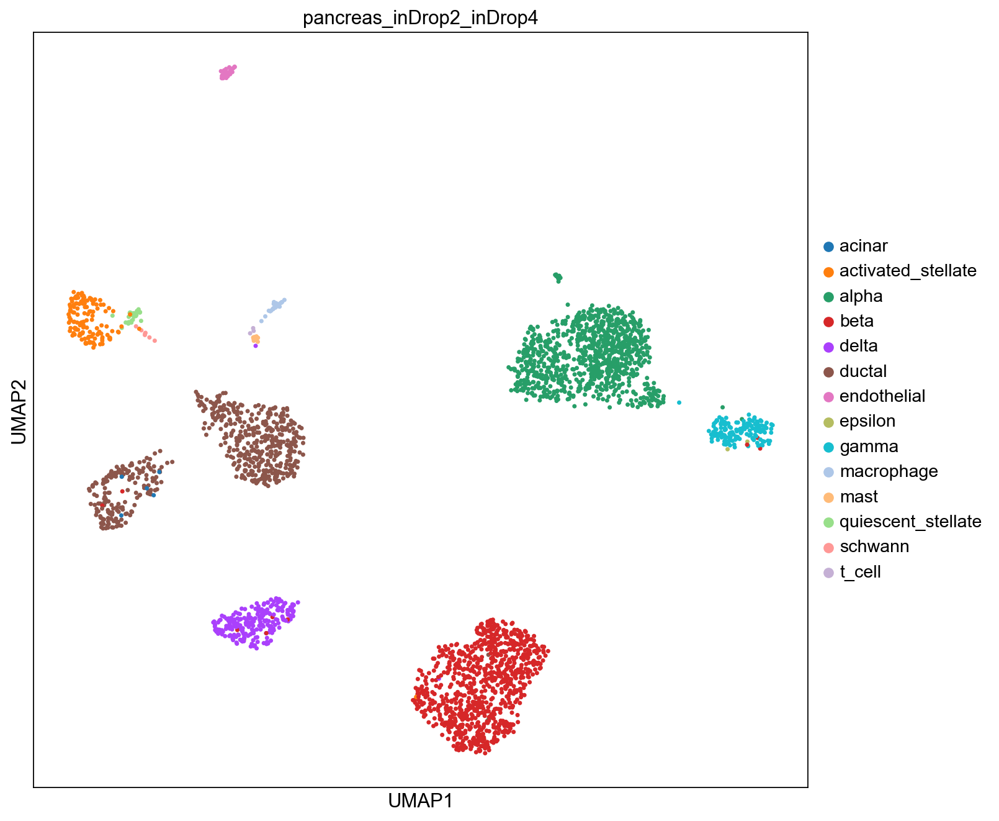

In [20]:
print(" ⦿ Plotting scatterplots for each dataset...")
for pair in data_objects:
        scanpy.pl.umap(data_objects[pair],title="{}_{}".format(data_type,pair),color=label_key)
       

***Comment:*** Based on the UMAP plot of the single cell dataset colored based on cell type information, it appears that the data points are grouped together based on their respective cell types. This suggests that there are distinct transcriptional programs associated with different cell types, which are reflected in the expression levels of genes in the cells.

### 2.5 Statistics

In this section, our goal is to gain insights into the distribution of cells or cell types across the selected batches in the dataset. Additionally, we can use this information to evaluate the quality of the dataset and ensure that the samples are well-balanced across batches.

#### 2.5.1 Batches vs. #cells


 ⦿ Distribution of cells in the celseq_celseq2's data ...


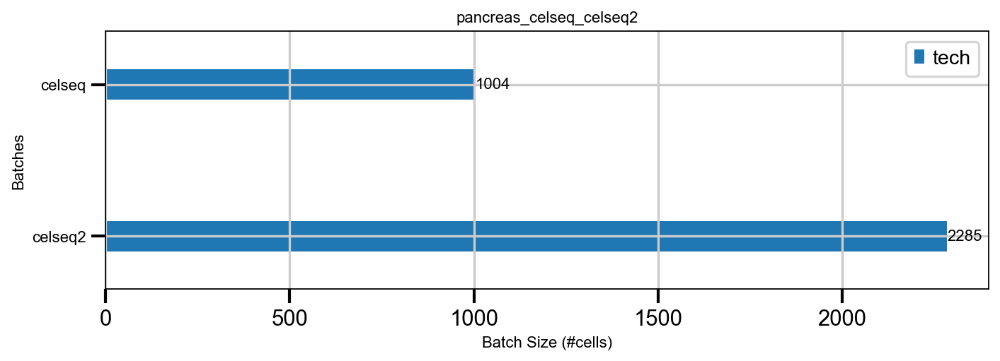

 ⦿ Distribution of cells in the inDrop2_inDrop4's data ...


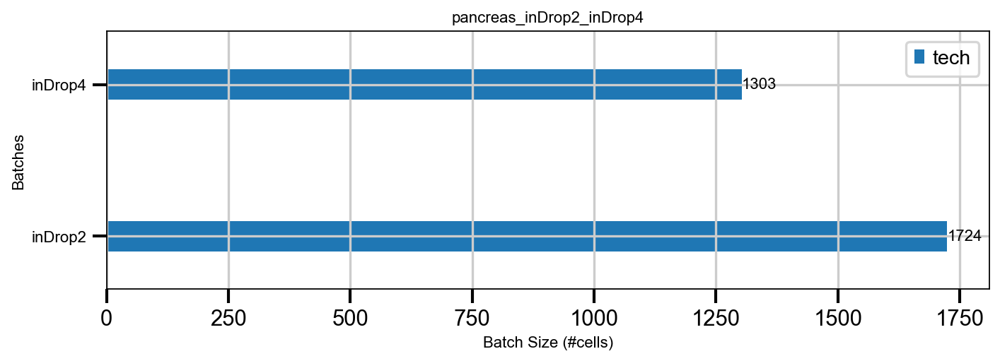

In [21]:
for pair in data_objects:
    
    print(" ⦿ Distribution of cells in the {}'s data ...".format(pair))

    bt_ncells=pd.DataFrame(data_objects[pair].obs[batch_key].value_counts())
    ax = bt_ncells.plot.barh(width=0.2,linewidth=1,figsize=(10, 3))
    for i in range(len(bt_ncells.columns)):
        ax.bar_label(ax.containers[i],fontsize=10)
    plt.yticks(fontsize=10)
    plt.ylabel("Batches", fontsize=10)
    plt.xlabel("Batch Size (#cells)", fontsize=10)
    plt.title("{}_{}".format(data_type,pair), fontsize=10)
    plt.show()

#### 2.5.1 Batch vs. Cell Types


 ⦿ Distribution of cell types in the celseq_celseq2's data ...


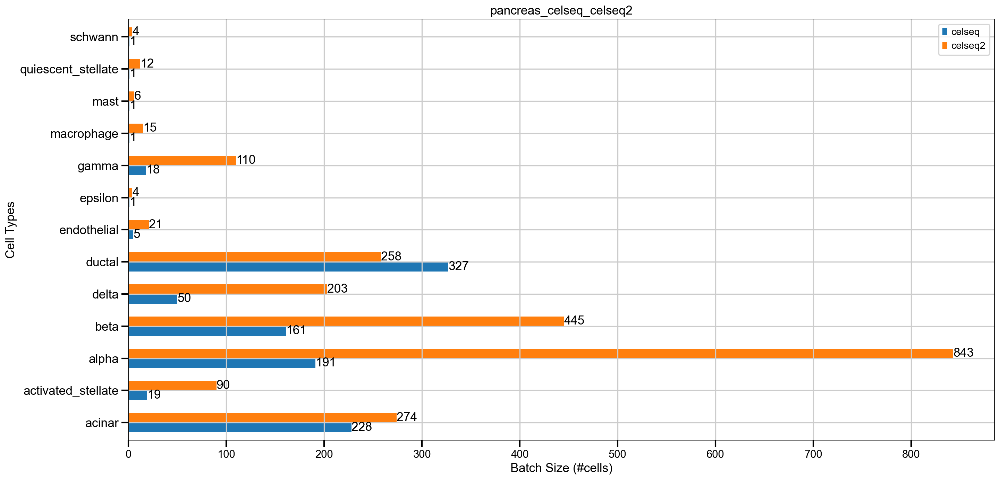

 ⦿ Distribution of cell types in the inDrop2_inDrop4's data ...


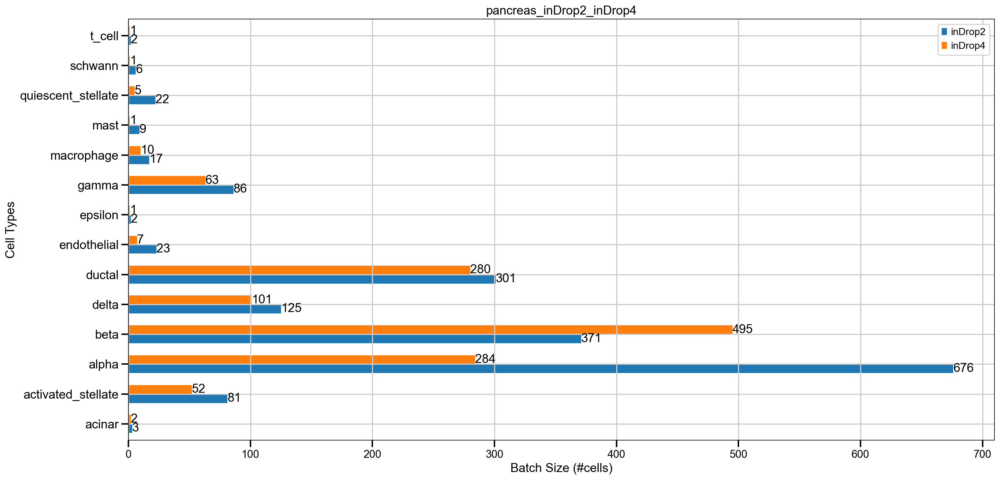

In [22]:
fontsize=16
for pair in data_objects:
    
    print(" ⦿ Distribution of cell types in the {}'s data ...".format(pair))
    bt_ct=pd.DataFrame(index=list(np.unique(data_objects[pair].obs[label_key])))
    
    for bt in np.unique(data_objects[pair].obs[batch_key]):
        bt_ct=pd.concat([bt_ct,pd.DataFrame(data_objects[pair][data_objects[pair].obs[batch_key]==bt].obs[label_key].value_counts()).rename(columns={label_key:bt})],axis=1)

    ax = bt_ct.plot.barh(width=0.6,linewidth=1,figsize=(20, 10))
    for i in range(len(bt_ct.columns)):
        ax.bar_label(ax.containers[i],fontsize=fontsize)
    plt.yticks(fontsize=fontsize)
    plt.ylabel("Cell Types", fontsize=fontsize)
    plt.xlabel("Batch Size (#cells)", fontsize=fontsize)
    plt.title("{}_{}".format(data_type,pair), fontsize=fontsize)
    plt.show()
       

***Comment:*** The bar plot for the single cell dataset, where the x-axis represents the number of cells in different batches for different cell types, provides a useful visualization of the distribution of cell types across the different experimental batches. This can be particularly helpful for identifying potential batch effects or batch-specific differences in cell type frequencies.

By examining the bar plot, one can quickly see how the distribution of cell types varies across the different batches. For example, one might observe that certain cell types are over-represented in certain batches, while others are under-represented. This could suggest that there are batch-specific effects on cell type frequencies, which may need to be accounted for in downstream analysis.

In [23]:
et_eda = time.time()
print("-------------\n ⦿ The EDA was completed in : ",et_eda-st_eda," seconds\n-------------")

-------------
 ⦿ The EDA was completed in :  20.890725135803223  seconds
-------------


# Integration Methods

# Methods

In [24]:
st_methods=time.time()
def metrics_eval(adata_int,adata,**kwargs):
    full_scores=None
    st = time.time()
    metrics={}
    precompute_pca = True
    recompute_neighbors = True
    full_scores=None
    st_full = time.time()
    
    #integrated=outpath + '[int]_[{}]_{}.h5ad'.format(hvg_type,method)
    
    empty_file = False

    #check if the number of genes in the integrated dataset is less than the desired number of HVG
    if (hvg is not None):
        if (adata_int.n_vars < hvg):
            raise ValueError("There are less genes in the corrected adata than specified for HVG selection")
            
    
    
    # check input files
    print(adata.n_obs)
    print(adata_int.n_obs)
    if adata.n_obs != adata_int.n_obs:
        message = "The datasets have different numbers of cells before and after integration."
        message += "Please make sure that both datasets match."
        raise ValueError(message)
        
    # check if the obsnames were changed and rename them in that case
    if len(set(adata.obs_names).difference(set(adata_int.obs_names))) > 0:
        print("Differences detected")
        # rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_int.obs_names]

        if len(set(adata.obs_names).difference(set(new_obs_names))) == 0:
            adata_int.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')
            
            
    
    # batch_key might be overwritten, so we match it to the pre-integrated labels
    adata_int.obs[batch_key] = adata_int.obs[batch_key].astype('category')
    batch_u = adata.obs[batch_key].value_counts().index
    batch_i = adata_int.obs[batch_key].value_counts().index
    if not batch_i.equals(batch_u):
        # pandas uses the table index to match the correct labels
        adata_int.obs[batch_key] = adata.obs[batch_key]
        
    if kwargs["method"]=="Harmony":
            types=["embed"]
    elif len(adata_int.obsm) > 0 and 'X_emb' in adata_int.obsm :
        types=["full","embed"]
    
    else:
        types=["full"]
    
    ## DATA REDUCTION
     
    for type_ in types:
        
        # distinguish between subsetted and full expression matrix
        # compute HVGs only if output is not already subsetted
        if type_=="full":
            embed = 'X_pca'
        
        # case 2: embedding output
        if (type_ == "embed"):
            n_hvgs = None
            embed = "X_emb"
            # legacy check
            if ('emb' in adata_int.uns) and (adata_int.uns['emb']):
                adata_int.obsm["X_emb"] = adata_int.obsm["X_pca"].copy()
                
        
        if not empty_file:
            sc.preprocessing.reduce_data(
                adata_int,
                n_top_genes=hvg,
                neighbors=recompute_neighbors,
                use_rep=embed,
                pca=precompute_pca,
                umap=False
            )
        
        print("computing metrics")
        # DEFAULT
        silhouette_ = True
        nmi_ = True
        ari_ = True
        pcr_ = True
        cell_cycle_ = True
        isolated_labels_ = True
        hvg_score_ = True
        graph_conn_ = True
        kBET_ = True
        lisi_graph_ = True
        # by output type
        if (type_ == "embed"):

            hvg_score_ = False
            
            
         # create cluster NMI output file
        file_stump = os.path.splitext("dgfdgdgfd")[0]
        cluster_nmi = f'{file_stump}_nmi.txt'
        
        
        results = sc.me.metrics(
            adata,
            adata_int,
            verbose=False,
            hvg_score_=hvg_score_,
            cluster_nmi=cluster_nmi,
            batch_key=batch_key,
            label_key=label_key,
            silhouette_=silhouette_,
            embed=embed,
            type_=type_,
            nmi_=nmi_,
            nmi_method='arithmetic',
            nmi_dir=None,
            ari_=ari_,
            pcr_=pcr_,
            cell_cycle_=cell_cycle_,
            organism=organism,
            isolated_labels_=isolated_labels_,
            n_isolated=None,
            graph_conn_=graph_conn_,
            kBET_=kBET_,
            #lisi_=lisi_,
            lisi_graph_=False,
            trajectory_=False
        )
        
        
        %R library(lisi)
        if type_=="full":
            integrated_df=adata_int.obsm["X_pca"]
        else:
            integrated_df=adata_int.obsm["X_emb"] #'X_emb' in adata_int.obsm
        celltypes_df=pd.DataFrame(adata_int.obs[label_key])
        batches_df=pd.DataFrame(adata_int.obs[batch_key])
        %R -i integrated_df,celltypes_df,batches_df

        %R cLISI=lisi::compute_lisi(integrated_df, data.frame(celltypes_df), colnames(celltypes_df))
        %R iLISI=lisi::compute_lisi(integrated_df, data.frame(batches_df), colnames(batches_df))
        %R -o cLISI,iLISI
        %R print(cLISI)
        
        #normalizing ilisi scores
        ilisi=np.mean(iLISI)
        nbatches = adata.obs[kwargs["batch_key"]].nunique()
        ilisi = (ilisi - 1) / (nbatches - 1)
        
        #normalizing clisi scores
        clisi=np.mean(cLISI) 
        nlabs = adata.obs[kwargs["label_key"]].nunique()
        clisi = (nlabs - clisi) / (nlabs - 1)
        
        results[0]["iLISI"]=ilisi
        results[0]["cLISI"]=clisi 
        
        
        
        
        
        method_name="{}_{}_[{}]_[{}]{}".format(kwargs["method"],type_,kwargs["custom_title"],kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
        
        if full_scores is None:
            full_scores=results.rename(columns={0:method_name})
        else:
            full_scores=pd.concat([full_scores,results.rename(columns={0:method_name})],axis=1)
    return full_scores

In [25]:
'''
A method that plots the metrics and scores for the results of a given method. 
This plot will allow us to easily compare the performance of different methods and evaluate
their effectiveness. In addition to the metrics and scores, we may also include other relevant
information such as the algorithm used, the dataset, and any hyperparameters that were tuned by editing
variable "custom_title" in **kwargs.
'''
def visualize_metrics(metrics,data_id,filename,**kwargs):
    '''
    metrics (dataframe object): Metrics are presented as a dataframe object, with columns representing the different methods used, and rows representing the metrics measured. 
    data_id (str): The data_id is the name or ID assigned to the passed dataset. This information is important to include in the output plot so that we can easily identify which dataset the results correspond to.
    filename (str): The filename is the name of the file to be used to output the plot. 
    '''
    print("   • Visualize '{}' after integration".format(data_id))
    ax = metrics.plot.barh(width=0.6,linewidth=1,figsize=(20, 10))
    for i in range(len(metrics.columns)):
        ax.bar_label(ax.containers[i],fontsize=13)

    plt.legend(metrics.columns,fontsize=15)
    plt.yticks(fontsize=15)
    plot_title="{}_[{}_{}]_[{}]_[{}]{}".format(kwargs["method"],kwargs["data_type"],data_id,kwargs["custom_title"],kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
    plt.title(plot_title,fontsize=20)
    plt.savefig("{}/{}_metrics_plot.pdf".format(kwargs["output_dir"],filename), format="pdf", bbox_inches="tight")
    plt.show()
    
    metrics.to_csv("{}/{}_metrics.csv".format(kwargs["output_dir"],filename))
    

In [26]:
'''
A method to visualize the integrated dataset using scatter plots generated with UMAP. 
Scatter plots are a powerful tool for exploring and interpreting high-dimensional datasets, 
and UMAP is a popular technique for reducing dimensionality while preserving the global structure of the data.
We may also include other relevant information such as the algorithm used, the dataset, and any hyperparameters
that were tuned by editing variable "custom_title" in **kwargs.
'''
def visualize_data(data_id,adata_int,filename,**kwargs):
    '''
    data_id (str): The data_id is the name or ID assigned to the passed dataset. This information is important to include in the output plot so that we can easily identify which dataset the results correspond to.
    adata_int (anndata object): The anndata object after integration.
    filename (str): The filename is the name of the file to be used to output the plot. 
    '''
    
    #check if the seurat object contains both "corrected features" output and the joint embeddings output
    if kwargs["method"]=="Harmony":
        output_options=["embed"]
    
    elif len(adata_int.obsm) > 0 and 'X_emb' in adata_int.obsm:
        output_options=["full","embed"]
    
    else:
        output_options=["full"]
        
    anndata_i=adata_int.copy()
    scanpy.pp.neighbors(anndata_i)
    scanpy.tl.umap(anndata_i)
    
    for option in output_options:
        plot_title="{}_{}_[{}_{}]_[{}]_[{}]{}".format(kwargs["method"],option,kwargs["data_type"],data_id,kwargs["custom_title"],kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
        umap_plots["{}_{}".format(kwargs["method"],kwargs["custom_title"])][data_id][option]=copy.deepcopy(anndata_i)
        #color based on batch information
        if option=="full": #corrected features
            with plt.rc_context():  # Use this to set figure params like size and dpi
                scanpy.pl.umap(anndata_i,color=[kwargs["batch_key"],kwargs["label_key"]],title=[plot_title+"_Batches",plot_title+"_Cell Types"],show=False)
                plt.savefig("{}/{}_{}_UMAP_plot.pdf".format(kwargs["output_dir"],filename,option), bbox_inches="tight")
                
                plt.show()
                #scanpy.pl.umap(anndata_i,color=kwargs["label_key"],title=plot_title,show=False)
                #plt.savefig("{}/{}_{}_UMAP_plot_ct.pdf".format(kwargs["output_dir"],filename,option), bbox_inches="tight")
                #plt.show()

        else: #joint embeddings
            with plt.rc_context():  # Use this to set figure params like size and dpi
                var_key="X_emb"
                scanpy.pl.embedding(anndata_i,var_key,color=[kwargs["batch_key"],kwargs["label_key"]],title=[plot_title+"_Batches",plot_title+"_Cell Types"],show=False)
                plt.savefig("{}/{}_{}_UMAP_plot.pdf".format(kwargs["output_dir"],filename,option), bbox_inches="tight")
                plt.show()
                #scanpy.pl.embedding(anndata_i,var_key,color=kwargs["label_key"],title=plot_title,show=False)
                #plt.savefig("{}/{}_{}_UMAP_plot_ct.pdf".format(kwargs["output_dir"],filename,option), bbox_inches="tight")
                #plt.show()

In [27]:
'''
A method to evaluate the performance of different integration methods and 
visualize the integrated dataset using appropriate metrics and visualization techniques.
'''
def run_evaluation(adata_ints,adata,**kwargs):
    '''
    We are using two anndata objects to store our data: adata_ints for the integrated datasets, 
    and adata for the original datasets before integration. The adata_ints object contains the 
    integrated data, which has been processed and merged from multiple datasets. This object may 
    contain additional attributes or annotations that were generated during the integration process.
    '''
    st_eva = time.time()
    print(" ⦿ Evaluating the results...")
    if "{}_{}".format(kwargs['method'],kwargs["custom_title"]) not in full_metrics:
        full_metrics["{}_{}".format(kwargs['method'],kwargs["custom_title"])]={}
    if "{}_{}".format(kwargs["method"],kwargs["custom_title"]) not in umap_plots:
        umap_plots["{}_{}".format(kwargs["method"],kwargs["custom_title"])]={}
    for data in adata_ints:
        
        print("   • Visualize '{}' after integration".format(data))
        umap_plots["{}_{}".format(kwargs["method"],kwargs["custom_title"])][data]={}
        
        fig_file="{}_{}_[{}_{}]_[{}_features]{}".format(kwargs["method"],kwargs["custom_title"],kwargs["data_type"],data,kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
        print(fig_file)
        st_umap = time.time()
        visualize_data(data,adata_ints[data],fig_file,**kwargs)
        et_umap = time.time()
        print("   • The scatterplot of {}'s was generated in {} seconds.".format(data,round(et_umap-st_umap,2)))
        with HiddenPrints():
            st_metrics = time.time()
            metrics=metrics_eval(adata_ints[data],adata[data],**kwargs)
            full_metrics["{}_{}".format(kwargs["method"],kwargs["custom_title"])][data]=metrics
            visualize_metrics(metrics,data,fig_file,**kwargs)
            et_metrics = time.time()
        print("   • The metrics evaluation of {}'s was completed in {} seconds.".format(data,round(et_metrics-st_metrics,2)))
            

In [28]:
'''
A method to log and store information about the hyperparameters used during integration, 
as well as the location of the stored outputs. Hyperparameters are variables that are set
before running each method.
'''
def logger (**kwargs):
    log_file="{}/{}_{}_[{}]_[{}_features]{}_log".format(kwargs["output_dir"],kwargs["method"],kwargs["custom_title"],kwargs["data_type"],kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
    with open(log_file,"w") as ofile:
        ofile.write("{}'s results are saved at {}\n".format(kwargs["method"],kwargs["output_dir"]))
        ofile.write("The used parameters are: \n")
        for arg in kwargs:
            ofile.write("{}: {}\n".format(arg,str(kwargs[arg])))


In [29]:
global full_metrics,umap_plots
full_metrics={}
umap_plots={}

### 3.1 Seurat (Hao, et al., ***Cell, 2021***)
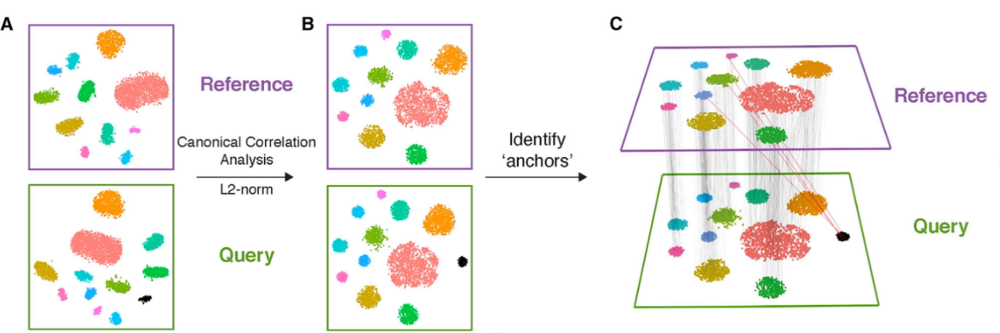
**https://doi.org/10.1016/j.cell.2021.04.048**

#### 3.1.1 Introduction
Seurat is a widely used method for single cell integration that allows for the integration of multiple datasets into a single, unified dataset. The method involves several key steps (described in the next cell). Seurat uses a **graph-based approach** to identify cell similarity across different datasets and integrates the datasets using a shared nearest neighbor (SNN) graph. The resulting integrated dataset can be used for downstream analyses such as cell type identification, differential expression analysis, and cell trajectory inference. Seurat has been widely used in various fields, including neuroscience, immunology, and cancer research, and has contributed to many important discoveries in the field of single cell genomics.

#### 3.1.2 Workflow

**3.1.2.1 - Dataset preprocessing:**
Load in expression matrix and metadata. The metadata file contains the technology (batch information) and cell type annotations (cell type information) for each cell in the datasets.

-------
**3.1.2.2 - Identifying anchors using the FindIntegrationAnchors function** 
Identifyin anchors are done as follows:

* The assumption is that there are correspondences between cells in different datasets, and that these cells represent a shared biological state.
* To identify correspondences, a modified version of the mutual nearest neighbor (MNN) approach is used, which considers each cell in a given dataset and finds its nearest neighbor in the other datasets.
* To integrate the datasets, first jointly reduce the dimensionality of both datasets using a technique called diagonalized canonical correlation analysis (CCA).
* Then search for shared nearest neighbors (SNNs) between cells in the reduced-dimensional space. These SNNs are referred to as anchors and are used as reference points for aligning the datasets.
* Obtaining an accurate set of anchors is crucial for successful integration, as errors can propagate throughout the integrated dataset.
* SNN graphs are commonly used to identify anchors, where the similarity between two cells is assessed by the overlap in their local neighborhoods.

***Here we use the default parameters for identifying anchors, including the 'dimensionality' parameter which is set to 30. However, you may experiment with varying this parameter over a wider range, such as between 10 and 50, to see how it affects the integration results. More information about the function's parameters can be found below.***

--------

**3.1.2.3 -** We then pass these anchors to the IntegrateData function, which returns a Seurat object.

* The returned object will contain a new Assay, which holds an integrated (or ‘batch-corrected’) expression matrix for all cells, enabling them to be jointly analyzed.

* After running IntegrateData, the Seurat object will contain a new Assay with the integrated expression matrix. Note that the original (uncorrected values) are still stored in the object in the “RNA” assay, so you can switch back and forth.

**3.1.3 Parameters**

-------
**Find integration anchors**
Find a set of anchors between a list of Seurat objects. These anchors are used to integrate the objects using the IntegrateData function.
* object.list: A list of Seurat objects between which to find anchors for downstream integration.
* assay: A vector of assay names specifying which assay to use when constructing anchors. ***If NULL, the current default assay for each object is used***.
* reference: A vector specifying the object/s to be used as a reference during integration. ***If NULL (default)***, all pairwise anchors are found (no reference/s). If not NULL, the corresponding objects in object.list will be used as references. When using a set of specified references, anchors are first found between each query and each reference. The references are then integrated through pairwise integration. Each query is then mapped to the integrated reference.
* anchor.features: Can be either:
    * A numeric value. This will call SelectIntegrationFeatures to select the provided number of features to be used in anchor finding
    * A vector of features to be used as input to the anchor finding process
    **Default: 2000**

* scale: Whether or not to scale the features provided. Only set to FALSE if you have previously scaled the features you want to use for each object in the object.list. **Default: scale = TRUE**

***Note that since we have defined another variable 'scale' in this notebook, we renamed this variable as scale_seurat for rpy2.***

* reduction: Dimensional reduction to perform when finding anchors. Can be one of:
    * cca: Canonical correlation analysis (**Default**)
    * rpca: Reciprocal PCA
* l2.norm: Perform L2 normalization on the CCA cell embeddings after dimensional reduction. **Default: l2.norm = TRUE**
* dims: Which dimensions to use from the CCA to specify the neighbor search space. **Default: dims = 1:30**
* k.anchor: How many neighbors (k) to use when picking anchors.***Default: k.anchor = 5*
* k.filter: How many neighbors (k) to use when filtering anchors.**Default: k.filter = 200**
* k.score:How many neighbors (k) to use when scoring anchors. **Default: k.score = 30**
* max.features: The maximum number of features to use when specifying the neighborhood search space in the anchor filtering. **Default: max.features = 200**
* eps: Error bound on the neighbor finding algorithm (from RANN/Annoy). **Default: eps = 0**


**Integrate data**
Perform dataset integration using a pre-computed AnchorSet
* k.weight: Number of neighbors to consider when weighting anchors. **Default: 100**

In [30]:
%%R
library(Seurat)
library(SingleCellExperiment)

In [63]:
class Seurat:
    def __init__(self,**kwargs):
        self.method="Seurat"
        self.data_type=None
        self.running_type=None
        self.data_ids=None
        self.batch_key=None
        self.hvg_type=None
        self.output_dir=None
        self.r_input_dir=None
        self.custom_title=None
        
        
        self.k_filter=200
        self.hvg=2000
        self.scale_seurat=True
        self.l2_norm=True
        self.max_features=200
        self.eps=0
        self.k_anchor=5
        self.k_score=30
        self.k_weight=100
        self.reduction="cca"
        self.scale=scale #from our preprocessing
        self.verbose=False
        
        
        self.__dict__.update(kwargs)
        try:
            os.mkdir(self.output_dir)
        except:
            pass
            
        self.corrected_datasets={}
        self.run_seurat()
        
        
    def run_seurat(self):
        st_seurat= time.time()
        for data_id in self.data_ids:
            st_seurat_d= time.time()
            self.custom_title="_" if self.custom_title=="" else "_{}".format(self.custom_title)
            
            print(" ⦿ Running {} for {}".format(self.method,data_id))
            
            self.corrected_datasets[data_id]=self.Seurat( data_id,
                                                        
                                                        self.data_type,
                                                        self.running_type,
                                                        self.output_dir,
                                                        self.batch_key,
                                                        self.hvg_type,
                                                        self.r_input_dir,
                                                        self.scale, #from our preprocessing
                                                        self.custom_title,
                                                        self.method,
                                                        
                                                       
                                                        self.k_filter,
                                                        self.hvg,
                                                        self.scale_seurat,
                                                        self.l2_norm,
                                                        self.max_features,
                                                        self.eps,
                                                        self.k_anchor,
                                                        self.k_score,
                                                        self.k_weight,
                                                        self.reduction,
                                                         self.verbose)
            et_seurat_d= time.time()
            print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,self.method,round((et_seurat_d-st_seurat_d),2)))
        et_seurat= time.time()
        print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(self.method,round((et_seurat-st_seurat),2)))
            
    def Seurat(self,data_id,
                    data_type,
                    running_type,
                    output_dir,
                    batch_key,
                    hvg_type,
                    r_input_dir,
                    scale, #from our preprocessing
                    custom_title,
                    method,

                    k_filter,
                    hvg,
                    scale_seurat,
                    l2_norm,
                    max_features,
                    eps,
                    k_anchor,
                    k_score,
                    k_weight,
                    reduction,
                    verbose):
        
        
        filename="[{}_{}]_[{}_features]{}.h5ad".format(data_type,data_id,self.hvg_type,"_[Scaled]" if scale else "")
        
        %R -i method,custom_title,filename,r_input_dir,batch_key,data_type,hvg,output_dir,k_filter,hvg,scale_seurat,l2_norm,max_features,eps,k_anchor,k_score,k_weight,reduction,running_type,verbose

        seurat_output=robjects.r(

        '''
        options(future.globals.maxSize = 1000 * 1024^2)
        require(Seurat)
        
        data=readRDS(paste(r_input_dir,"/",filename,sep=""))
        batch_list = SplitObject(data, split.by = batch_key)
        
        if (reduction=='rpca'){
            print(hvg)
              features <- SelectIntegrationFeatures(batch_list)
              batch_list <- lapply(X = batch_list, FUN = function(x) {
              x  <- ScaleData(x, features = hvg)
              x <- RunPCA(x, features = hvg)
              return(x)
          })
        }
        
        
        
        anchors = FindIntegrationAnchors(
              reduction = reduction,
              object.list = batch_list,
              anchor.features = hvg,
              scale = scale_seurat,
              l2.norm = l2_norm,
              dims = 1:30,
              k.anchor = k_anchor,
              k.filter = k_filter,
              k.score = k_score,
              max.features = max_features,
              eps = eps,
              verbose=verbose)


        integrated = IntegrateData(
               anchorset = anchors,
               new.assay.name = "integrated",
               features = NULL,
               features.to.integrate = NULL,
               dims = 1:30,
               k.weight = k_weight,
               weight.reduction = NULL,
               sd.weight = 1,
               sample.tree = NULL,
               preserve.order = F,
               do.cpp = T,
               eps = eps,
               verbose = verbose)
        
        
        saveRDS(integrated, file=paste(output_dir,method,custom_title,"_",filename,sep=""))
        ''')
        
        
        print("   • Convert from R object to Python.... ")
        return convert_r_object_to_scannpy(self.output_dir+"/"+method+self.custom_title+"_"+filename)
        

#### 3.1.4 Test Seurat


‣ Running Seurat------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running Seurat for celseq_celseq2
   • Convert from R object to Python.... 
   • The integration of celseq_celseq2 has been completed by Seurat in 17.64 seconds.
 ⦿ Running Seurat for inDrop2_inDrop4
   • Convert from R object to Python.... 
   • The integration of inDrop2_inDrop4 has been completed by Seurat in 14.07 seconds.
 ✔️ The integration of all tasks has been completed by Seurat in 31.71 seconds.
 ⦿ Evaluating the results...
   • Visualize 'celseq_celseq2' after integration
Seurat_default_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


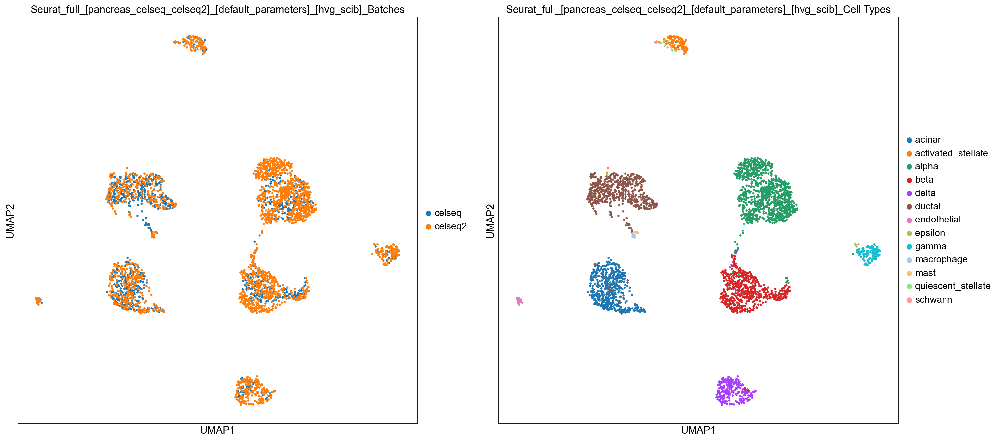

   • The scatterplot of celseq_celseq2's was generated in 9.07 seconds.


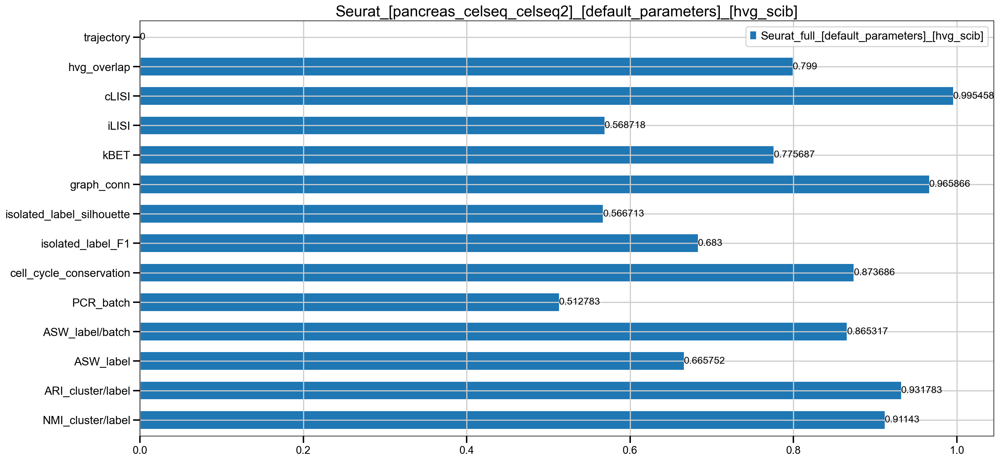

   • The metrics evaluation of celseq_celseq2's was completed in 87.35 seconds.
   • Visualize 'inDrop2_inDrop4' after integration
Seurat_default_parameters_[pancreas_inDrop2_inDrop4]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


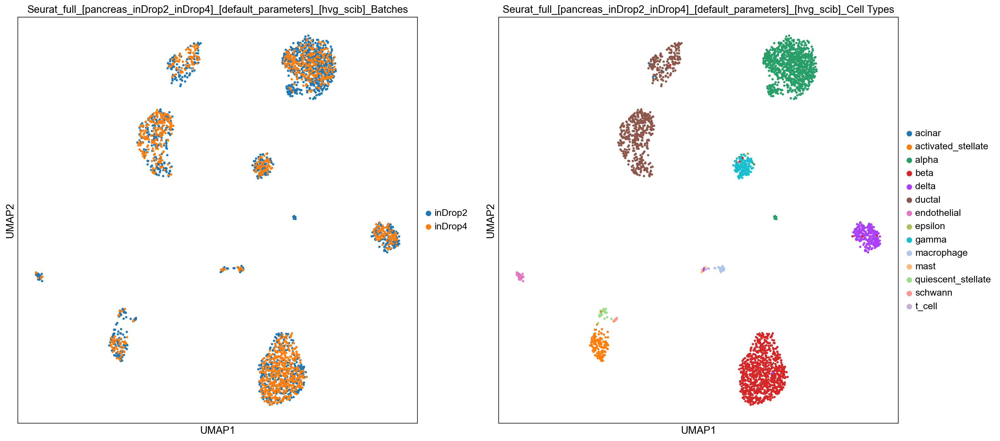

   • The scatterplot of inDrop2_inDrop4's was generated in 8.14 seconds.


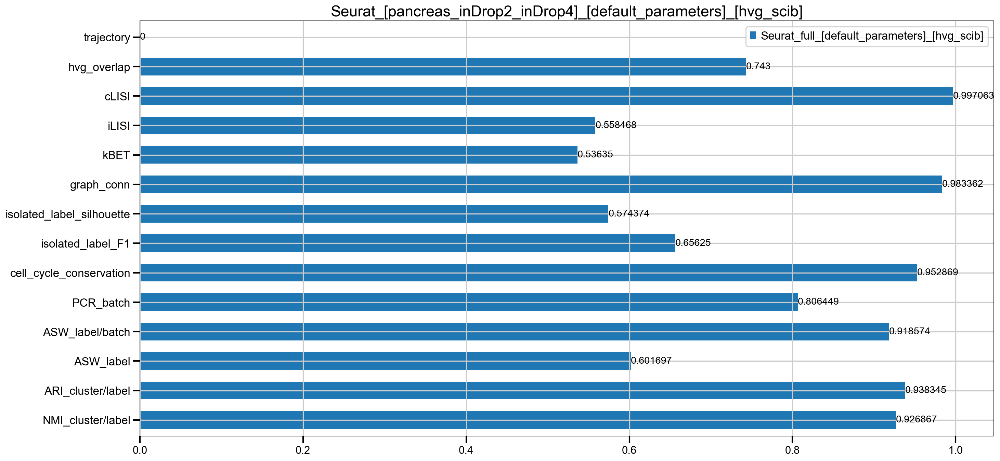

   • The metrics evaluation of inDrop2_inDrop4's was completed in 72.19 seconds.


In [31]:
print("‣ Running Seurat------ ")
print("‣‣‣ Using Default Prameters------ ")

kwargs={
        'method':"Seurat",
        'label_key':label_key,
        'running_type':"default",
        'data_type':data_type,
        'data_ids':list(data_objects),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"Seurat"),
        'r_input_dir':r_input_dir,
        
        #Seurat parameters
        "k_filter":200, # How many neighbors (k) to use when filtering anchors
        'hvg':2000, # 
        'scale_seurat':True, #
        'l2_norm':True, #
        'max_features':200,# equivalent to max.features
        'eps':0, #  Error bound on the neighbor finding algorithm (from RANN/Annoy)
        'k_anchor':5,# How many neighbors (k) to use when picking anchors
        'k_score':30,# How many neighbors (k) to use when scoring anchors
        'k_weight':100, # Number of neighbors to consider when weighting anchors
        'reduction':"cca", # Dimensional reduction
        #####################################
        # please update this variable
        'custom_title':"default_parameters".format(hvg_type), #title to be displayed in figures and output's filename to distinguish betweeen differnt versions of your runnings
        #####################################
        'verbose':False #
}
seurat_corrected_datasets=Seurat (**kwargs).corrected_datasets
run_evaluation(seurat_corrected_datasets,data_objects,**kwargs)
logger (**kwargs)



### Here are some hints on how to interpret UMAP plots:

* Mixing of cells from different datasets: If the UMAP plot shows cells from different datasets mixed together, this is a good indication that the integration was successful. Conversely, if cells from different datasets are clearly separated from each other, this suggests that the integration may not have worked as well.

* Consistency of cell clustering: If the UMAP plot shows consistent clustering of cells by cell type or condition across different datasets, this is a good indication that the integration was successful. On the other hand, if the clustering patterns are inconsistent or unclear, this suggests that the integration may not have worked as well.

* Distribution of cells: If the UMAP plot shows a uniform distribution of cells across the plot, this is a good indication that the integration was successful. On the other hand, if there are clusters of cells in certain regions of the plot, this suggests that the integration may have some bias or artifacts.

***It's worth noting that the interpretation of UMAP plots can be subjective and may require expertise in the specific biological system being studied. Additionally, visual examination alone may not provide a complete picture of integration quality, and additional metrics such as LISI, CLISI, and other quality control measures should be used to evaluate the integration performance.***

**Example:**

***celseq - celseq2***: 
- LISI: The UMAP plot where cells are colored based on the batch after integration (correction) provides valuable insights into the effectiveness of the batch correction method used in the analysis of the single cell dataset. The fact that the data points from mixed batches are now grouped together in the same cluster suggests that the batch correction has been successful in removing technical variation and reducing the impact of batch effects on the data.

However, it is important to note that the low diversity score observed in the UMAP plot, with data points from "celseq2" mostly grouped together, could potentially lead to a small or low Lisi score. The Lisi score measure the diversity within a group.

- cLISI: On the other hand, when the UMAP plot is colored based on cell type information, we observe that the data points are mostly grouped based on their cell types. This is a good sign of integration, as it suggests that the batch correction method has effectively removed batch effects while preserving biological variation. Although there may be some miss-grouped data points, the overall pattern of cell type clustering suggests that we can expect a high CLISI score.

- kBET (k-nearest neighbor Batch Effect Test): a statistical method for detecting and quantifying batch effects in single-cell RNA sequencing (scRNA-seq) datasets. The KBET method is based on the idea that batch effects can cause systematic differences in the distribution of nearest neighbors between cells from different batches, even after normalization and batch correction., to detect these differences, KBET calculates a "batch distance" score that measures the distance between cells from the same batch compared to cells from different batches. This score is then used to calculate a p-value that quantifies the statistical significance of the batch effect.

  - kBET determines whether the label composition of a k nearest neighborhood of a cell is similar to the expected (global) label composition and it is used here to confirm the iLISI score where: as score of 0 meaning low batch mixing and 1 meaning optimal batch mixing.

  

- Rand Index (RI, ARI) measures the similarity between the cluster assignments by making pair-wise comparisons. A higher score signifies higher similarity.

- Mutual Information (MI, NMI, AMI): measures the agreement between the cluster assignments. A higher score signifies higher similarity. 

  Bothe NMI and ARI return values between 0 and 1, with 0 indicating no agreement between the two clusterings and 1 indicating perfect agreement. Intermediate values indicate partial agreement between the two clusterings.

- Average Silhouette Width (ASW) is a measure of the quality of a clustering solution, particularly in cases where the ground truth labels are unknown. It quantifies the degree of separation between clusters, and provides a measure of the cohesion and separation of data points within each cluster.

- Graph Connectivity: The graph connectivity metric evaluates whether all cells with the same cell identity label are directly connected in the kNN graph representation of the integrated data, G

- The HVG conservation score is a proxy for the preservation of the biological signal

### 3.2 Harmony ***(Korsunsky, et al., Nat Methods, 2019)***

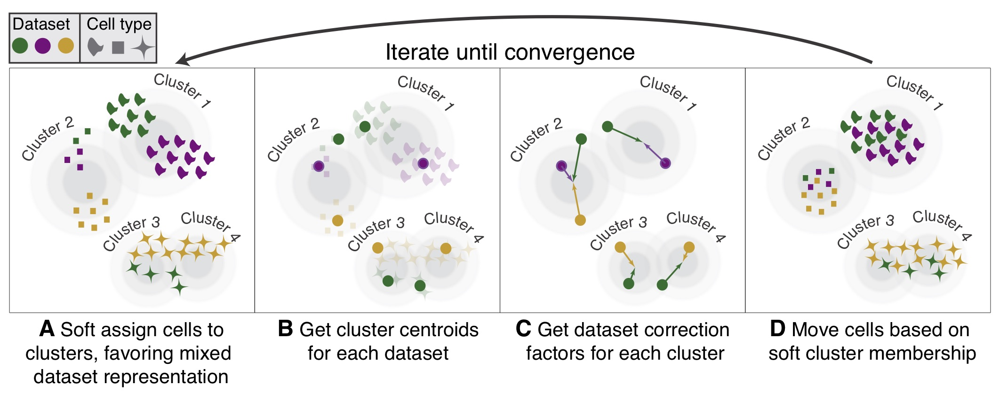
Image credit: Korsunsky, I., Millard, N., Fan, J. et al. Fast, sensitive and accurate integration of single-cell data with Harmony. Nat Methods 16, 1289–1296 (2019). https://doi.org/10.1038/s41592-019-0619-0

#### 3.2.1 Introduction
The Harmony method is a popular algorithm used for single-cell integration of gene expression data. It is based on the principle of finding a low-dimensional representation of the data that captures the sources of variation across cells, and then using this representation to correct for batch effects and other sources of technical variation.

The Harmony algorithm begins by constructing a graph of cells based on their similarity in gene expression space. The graph is then used to identify clusters of cells that are likely to belong to the same biological cell type or state. Next, the algorithm computes a low-dimensional representation of the data using principal component analysis (PCA) or a related method, and projects each cell onto this representation. Finally, the cell embeddings are adjusted to correct for technical variation using a linear regression model.

#### 3.2.2 Workflow

- Normalizing Dataset
- Find highly variable featuers
- Scale Dataset
- Dimension reduction
   * Instead of using CCA, Harmony applies a transformation to the principal component (PCs),
- Run Harmony
   * Harmony uses k-means clustering to delineate clusters, seeking to define clusters with maximum “diversity”.
   * The diversity of each cluster reflects whether it contains balanced amounts of cells from each of the batches (donor, condition, tissue, technolgy…) we seek to integrate on, as should be observed in a well-integrated dataset.
   * After defining diverse clusters, Harmony determines how much a cell’s batch identity impacts on its PC coordinates, and applies a correction to “shift” the cell towards the centroid of the cluster it belongs to.
   * Cells are projected again using these corrected PCs, and the process is repeated iteratively until convergence.

#### 3.2.3 Parameters
 * reduction = 'pca': reduction Name of dimension reduction to use. Default is PCA.
 * dims.use = NULL: Which PCA dimensions to use for Harmony. By default, use all.
 * sigma = 0.1: Width of soft kmeans clusters. Default sigma=0.1. Sigma scales the distance from a cell to cluster centroids. Larger values of sigma result in cells assigned to more clusters. Smaller values of sigma make sof  kmeans cluster approach hard clustering.
 * nclust = NULL:  Number of clusters in model. nclust=1 equivalent to simple linear regression.
 * block.size = 0.05: What proportion of cells to update during clustering. Between 0 to 1, default 0.05. ***Larger values may be faster but less accurate.****
 * max.iter.harmony = 10: Maximum number of rounds to run Harmony. One round of Harmony involves one clustering and one correction step.
 * max.iter.cluster = 20: Maximum number of rounds to run clustering at each round of Harmony.
 * epsilon.cluster = 1e-5: Convergence tolerance for clustering round of Harmony. Set to -Inf to never stop early.
 * theta: Diversity clustering penalty parameter. Specify for each variable in group.by.vars. Default theta=2. theta=0 does not encourage any diversity. Larger values of theta result in more diverse clusters.
 * epsilon.harmony= 1e-04: Convergence tolerance for clustering round of Harmony Set to -Inf to never stop early.

In [31]:
class Harmony:
    def __init__(self, **kwargs):
        self.data_type=None
        self.running_type=None
        self.data_ids=None
        self.batch_key=None
        self.hvg_type=None
        self.output_dir=None
        self.r_input_dir=None
        self.custom_title=None
        self.scale=None #from our preprocessing
        

        self.block_size = 0.05
        self.max_iter_harmony = 10
        self.max_iter_cluster = 20
        self.epsilon_cluster = 1e-05
        self.epsilon_harmony = 1e-04
        self.sigma = 0.1
        self.nclust=None
        self.lambda_=None
        self.theta=None
        
        self.__dict__.update(kwargs)
        try:
            os.mkdir(self.output_dir)
        except:
            pass
        self.corrected_datasets={}
        
        self.run_harmony()
        
    def run_harmony(self):
        st_harmony= time.time()
        for data_id in self.data_ids:
            self.custom_title="_" if self.custom_title=="" else "_{}".format(self.custom_title)
            st_harmony_d= time.time()
            print(" ⦿ Running {} for {}".format(self.method,data_id))
            self.corrected_datasets[data_id]=self.Harmony(data_id,
                                                        self.data_type,
                                                        self.running_type,
                                                        self.output_dir,
                                                        self.batch_key,
                                                        self.hvg_type,
                                                        self.r_input_dir,
                                                        self.scale, #from our preprocessing
                                                        self.custom_title,
                                                        self.method,
                                                        
                                                        self.block_size,
                                                        self.max_iter_harmony,
                                                        self.max_iter_cluster,
                                                        self.epsilon_cluster,
                                                        self.epsilon_harmony,
                                                        self.sigma,
                                                        self.nclust,
                                                        self.lambda_,
                                                        self.theta)
            et_harmony_d= time.time()
            print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,self.method,round((et_harmony_d-st_harmony_d),2)))
        et_harmony= time.time()
        print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(self.method,round((et_harmony-st_harmony),2)))
            
        
            
    def Harmony (self,data_id,
                        data_type,
                        running_type,
                        output_dir,
                        batch_key,
                        hvg_type,
                        r_input_dir,
                        scale, #from our preprocessing
                        custom_title,
                        method,

                        block_size,
                        max_iter_harmony,
                        max_iter_cluster,
                        epsilon_cluster,
                        epsilon_harmony,
                        sigma,
                        nclust,
                        lambda_,
                        theta):
        
        
       

        filename="[{}_{}]_[{}_features]{}.h5ad".format(data_type,data_id,self.hvg_type,"_[Scaled]" if scale else "")
        %R -i method,custom_title,filename,r_input_dir,hvg,output_dir,block_size,max_iter_harmony,max_iter_cluster,epsilon_cluster,epsilon_harmony,sigma,nclust,scale,lambda_,theta
        
        harmony_output=robjects.r(
            '''
            print(block_size)
            if (nclust==-1){nclust=NULL}
            if (lambda_==-1){lambda_=NULL}
            if (theta==-1){theta=NULL}

            require(harmony)
            require(Seurat)
            sobj=readRDS(paste(r_input_dir,"/",filename,sep=""))
            sobj <- ScaleData(sobj)
            sobj <- RunPCA(sobj, features=rownames(sobj@assays$RNA))
            sobj <- RunHarmony(sobj, batch_key,sigma=sigma,nclust=nclust,lambda=lambda_,theta=theta,block.size=block_size,max.iter.harmony=max_iter_harmony,max.iter.cluster=max_iter_cluster,epsilon.cluster=epsilon_cluster,epsilon.harmony=epsilon_harmony)
            sobj[['X_emb']] <- sobj[['harmony']]
            saveRDS(sobj, file=paste(output_dir,method,custom_title,"_",filename,sep=""))
        ''')
        
        
        print("   • Convert from R object to Python.... ")
        return convert_r_object_to_scannpy(self.output_dir+"/"+method+self.custom_title+"_"+filename)

#### 3.2.4 Test Harmony 

‣ Running Harmony------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running Harmony for celseq_celseq2
[1] 0.05
   • Convert from R object to Python.... 
   • The integration of celseq_celseq2 has been completed by Harmony in 10.44 seconds.
 ⦿ Running Harmony for inDrop2_inDrop4
[1] 0.05
   • Convert from R object to Python.... 
   • The integration of inDrop2_inDrop4 has been completed by Harmony in 8.79 seconds.
 ✔️ The integration of all tasks has been completed by Harmony in 19.23 seconds.
 ⦿ Evaluating the results...
   • Visualize 'celseq_celseq2' after integration
Harmony_default_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]


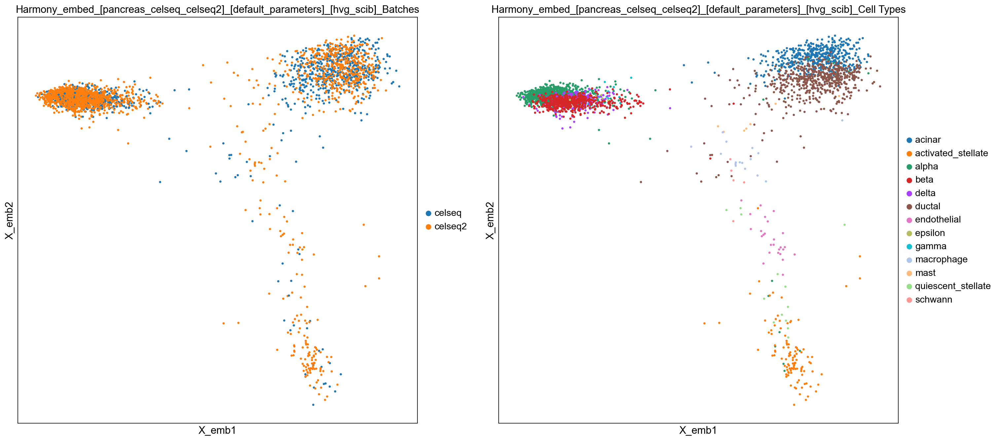

   • The scatterplot of celseq_celseq2's was generated in 7.5 seconds.


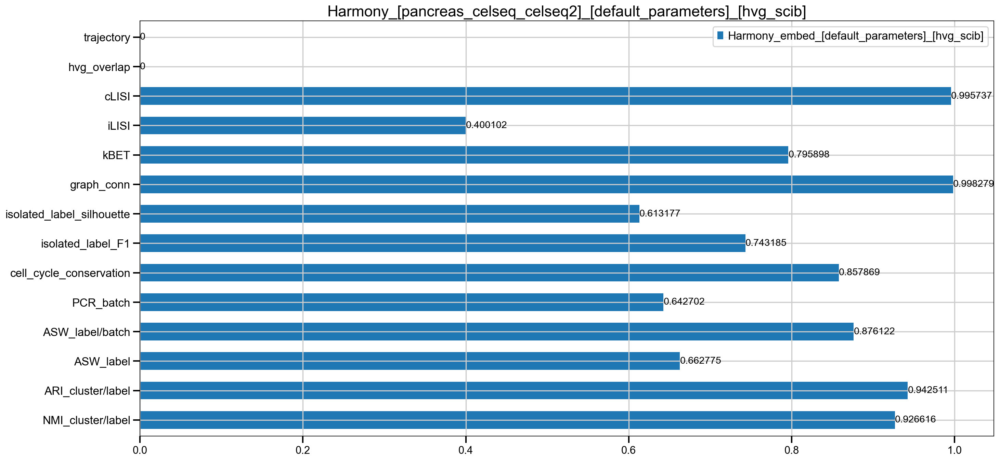

   • The metrics evaluation of celseq_celseq2's was completed in 79.76 seconds.
   • Visualize 'inDrop2_inDrop4' after integration
Harmony_default_parameters_[pancreas_inDrop2_inDrop4]_[hvg_scib_features]


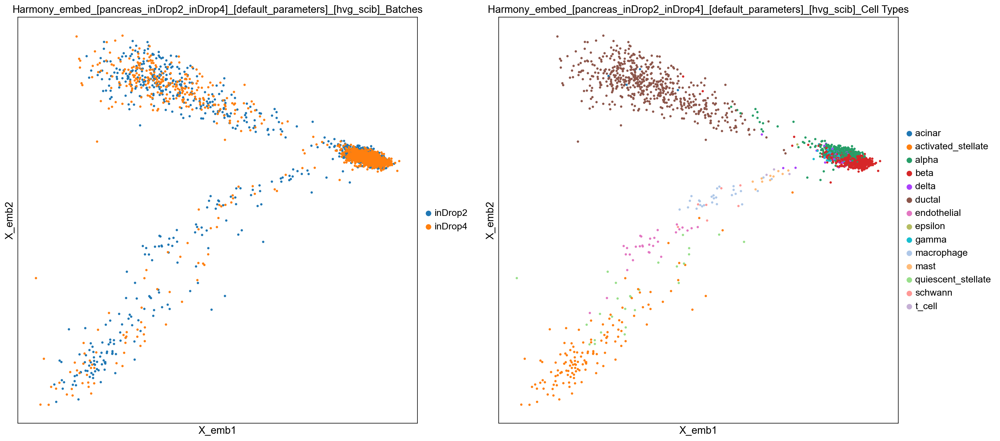

   • The scatterplot of inDrop2_inDrop4's was generated in 6.57 seconds.


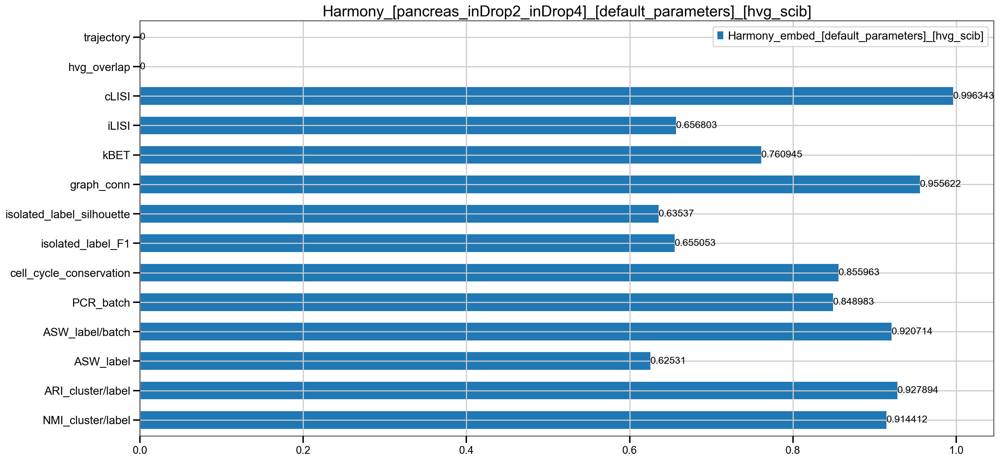

   • The metrics evaluation of inDrop2_inDrop4's was completed in 80.28 seconds.


In [32]:
print("‣ Running Harmony------ ")
print("‣‣‣ Using Default Prameters------ ")
running_type="default"
kwargs={
        'method':"Harmony",
        'label_key':label_key,
        'running_type':running_type,
        'data_type':data_type,
        'data_ids':list(data_objects),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"Harmony"),
        'r_input_dir':r_input_dir,
        
        #Harmony parameters
        'block_size' :0.05, #
        'max_iter_harmony' : 10, #
        'max_iter_cluster' : 20, #
        'epsilon_cluster' : 1e-05, #
        'epsilon_harmony' : 1e-04, #
        'sigma' : 0.1, #
        'nclust':-1, # -1 equivalent to NULL in R
        'lambda_':-1, # -1 equivalent to NULL in R
        'theta':-1, # -1 equivalent to NULL in R
        #####################################
        # please update this variable
        'custom_title':"default_parameters",
        #####################################

}
harmony_integrated_datasets=Harmony(**kwargs).corrected_datasets
run_evaluation(harmony_integrated_datasets,data_objects,**kwargs)
logger (**kwargs)

***Comments:***
- **celseq-celseq2**

  - Since Harmony is an embedding-based method (output is not features/genes), we will only analyze the embedded output produced by Harmony. The UMAP plot can be difficult to interpret, as reducing the size of the data to only 2 or 3 dimensions may not always accurately reflect the underlying structure of the data. While some groups appear to be mixed, we can still observe that many data points are not well-clustered, which may result in a low Lisi score. However, the majority of Celseq2 data points are still clustered together.

  - On the other hand, in the second UMAP plot (colored by cell type), we can see that our data points are mostly grouped by their respective cell types.

  - Assuming that the data in the UMAP plot is grouped into three clusters, we can observe that it may result in a high kBET score.
  
  - In terms of clustering, we could easily expect close values to Seurat's output.
  - In terms of graph connectivity, again we expect high value, since most datapoints from the same cell type C are close to each other.

- **inDrop2-inDrop4**

  - As mentioned before, interpreting the UMAP plot can be challenging. Although some groups appear mixed, we can still see that inDrop2/inDrop4 data points are better clustered than celseq/celseq2, resulting in a higher iLisi score.

  - As for the second UMAP plot (colored by cell type), we can observe that our data points are mostly grouped by their respective cell types.

  - Regarding clustering, we can expect values similar to Seurat's output.

  - Lastly, in terms of graph connectivity, we can expect high values since most data points from the same cell type C are close to each other.


### 3.3 [fastMNN](https://marionilab.github.io/FurtherMNN2018/theory/description.html)

FastMNN (Fast Mutual Nearest Neighbors) is a method for integrating single-cell RNA sequencing (scRNA-seq) data from multiple samples, which addresses the problem of batch effects. 
The FastMNN is an extension of the MNN method that identifyies mutual nearest neighbors (MNNs. FastMNN uses these MNNs to build a similarity matrix that reflects the relationships between cells across batches. This matrix is used to perform a batch correction that adjusts for the batch effects while preserving the biological variation.

One of the advantages of FastMNN is that it can be applied to scRNA-seq data that contains different cell types, without requiring prior knowledge of cell type identities. This makes it a versatile method that can be used in various biological contexts.

#### 3.3.1  Workflow:
- Performing an multi-batch PCA: 
First, perform a PCA across all cells in all batches to reduce dimensionality. This decreases the size of the data for further analysis - in particular, improving the speed of nearest-neighbour detection. 

- Identifying MNN pairs: MNNs will be identified between cells of the same type or state across batches, The only modification to the original MNN method is that nearest neighbour identification is now performed on the PC space rather than the original gene expression space.

    * The choice of k should be driven by the minimum subpopulation size in each batch, with a default of k=20. 
    * For each cell i1 in batch 1, we find the k cells in batch 2 with the smallest distances to i1, i.e., its k nearest neighbors in batch 2 and the same for each cell in batch 2 to find its k nearest neighbors in batch 1.
    * If a pair of cells from each batch is contained in each other’s set of nearest neighbors, those cells are considered to be mutual nearest neighbors .
    * any systematic differences in expression level between cells in MNN pairs should represent the batch effect.
    * t is (again) possible that MNNs are incorrectly identified between cells of different type or state across batches.
    
- For each MNN pair, a pair-specific batch-correction vector is computed as the vector difference between the expression profiles of the paired cells.
- Batch-correction vector is then calculated as a weighted average of these pair-specific vectors, The weighting is done using a tricube scheme, where the bandwidth is defined as ndist=3 times the median distance to the k neighbours.

- Cells in the target batch are then batch-corrected by subtracting the correction vector from the coordinates in the PC space.

- The newly corrected cells are merged with the reference batch, and the entire process is repeated with a new batch.







#### 3.3.2 Parameters

* k = 20: An integer scalar specifying the number of nearest neighbors to consider when identifying MNNs.

* cos.norm = TRUE: A logical scalar indicating whether cosine normalization should be performed on the input data prior to PCA.

* ndist = 3: A numeric scalar specifying the threshold beyond which neighbours are to be ignored when computing correction vectors. Each threshold is defined as a multiple of the number of median distances.

* d = 50: Numeric scalar specifying the number of dimensions to use for dimensionality reduction in multiBatchPCA. If NA, no dimensionality reduction is performed and any matrices in ... are used as-is.

* subset.row = NULL: A vector specifying which features to use for correction.

* correct.all = NULL: Logical scalar indicating whether corrected expression values should be computed for genes not in subset.row. Only relevant if subset.row is not NULL.

* assay.type = "logcounts": A string or integer scalar specifying the assay containing the log-expression values. Only used for SingleCellExperiment inputs.

* deferred = TRUE: Logical scalar indicating whether to defer centering/scaling, see multiBatchPCA for details.
* prop.k=NULL: A numeric scalar in (0, 1) specifying the proportion of cells in each dataset to use for mutual nearest neighbor searching. If set, the number of nearest neighbors used for the MNN search in each batch is redefined as max(k, prop.k*N) where N is the number of cells in that batch.
* restrict = NULL: A list of length equal to the number of objects in .... Each entry of the list corresponds to one batch and specifies the cells to use when computing the correction.
* weights = NULL: Further arguments to pass to multiBatchPCA.
* get.variance = FALSE: An integer vector containing the linear merge order of batches in .... Alternatively, a list of lists representing a tree structure specifying a hierarchical merge order.

In [32]:
class fastMNN:
    def __init__(self,**kwargs):
        self.method="fastMNN"
        
        self.data_type=None
        self.running_type=None
        self.data_ids=None
        self.batch_key=None
        self.hvg_type=None
        self.output_dir=None
        self.r_input_dir=None
        self.custom_title=None
        self.scale=None #from our preprocessing
        
        
        
        self.prop_k = -1
        self.restrict = -1
        self.cos_norm = True
        self.ndist = 3
        self.d = 50
        self.deferred = True
        self.weights = -1
        self.get_variance = False
        self.merge_order = -1
        self.auto_merge = False
        self.min_batch_skip = 0
        self.subset_row = -1
        self.correct_all = False
        self.assay_type = "logcounts"
        
        
        
        
        self.__dict__.update(kwargs)
        try:
            os.mkdir(self.output_dir)
        except:
            pass
        self.corrected_datasets={}
        self.run_fastMNN()
        
        '''
        
        '''
    def run_fastMNN(self):
        st_fastmnn= time.time()
        for data_id in self.data_ids:
            st_fastmnn_d= time.time()
            self.custom_title="_" if self.custom_title=="" else "_{}".format(self.custom_title)
            print(" ⦿ Running {} for {}".format(self.method,data_id))
            self.corrected_datasets[data_id]=self.fastMNN(data_id,
                                                        
                                                        self.data_type,
                                                        self.running_type,
                                                        self.output_dir,
                                                        self.batch_key,
                                                        self.hvg_type,
                                                        self.r_input_dir,
                                                        self.scale, #from our preprocessing
                                                        self.custom_title,
                                                        self.method,

                
                                                        self.prop_k,
                                                        self.restrict,
                                                        self.cos_norm,
                                                        self.ndist,
                                                        self.d,
                                                        self.deferred,
                                                        self.weights,
                                                        self.get_variance ,
                                                        self.merge_order,
                                                        self.auto_merge,
                                                        self.min_batch_skip,
                                                        self.subset_row,
                                                        self.correct_all,
                                                        self.assay_type)
            et_fastmnn_d= time.time()
            print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,self.method,round((et_fastmnn_d-st_fastmnn_d),2)))
        et_fastmnn= time.time()
        print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(self.method,round((et_fastmnn-st_fastmnn),2)))
    def fastMNN(self,data_id,
                                                        
                                                        data_type,
                                                        running_type,
                                                        output_dir,
                                                        batch_key,
                                                        hvg_type,
                                                        r_input_dir,
                                                        scale, #from our preprocessing
                                                        custom_title,
                                                        method,
                
                                                        prop_k,
                                                        restrict,
                                                        cos_norm,
                                                        ndist,
                                                        d,
                                                        deferred,
                                                        weights,
                                                        get_variance ,
                                                        merge_order,
                                                        auto_merge,
                                                        min_batch_skip,
                                                        subset_row,
                                                        correct_all,
                                                        assay_type):
        
        
       
        filename="[{}_{}]_[{}_features]{}.h5ad".format(data_type,data_id,self.hvg_type,"_[Scaled]" if scale else "")
        %R -i method,custom_title,filename,r_input_dir,batch_key,data_type,hvg,output_dir,hvg,prop_k,restrict,cos_norm,ndist,d,deferred,weights,get_variance,merge_order,auto_merge,min_batch_skip,subset_row,correct_all,assay_type,running_type
        
        fasmnn_output=robjects.r(
        '''
        if (prop_k==-1){prop_k=NULL}
        if (restrict==-1){restrict=NULL}
        if (weights==-1){weights=NULL}
        if (merge_order==-1){merge_order=NULL}
        if (subset_row==-1){subset_row=NULL}
        
        sobj=readRDS(paste(r_input_dir,"/",filename,sep=""))
        suppressPackageStartupMessages({
        require(batchelor)
          })

          if (is.null(sobj@assays$RNA)) {
            # Seurat v4
            expr <- GetAssayData(sobj, slot = "data")
          } else {
            # Seurat v3
            expr <- sobj@assays$RNA@data
          }

          sce <- fastMNN(expr, batch = sobj@meta.data[[batch_key]],prop.k=prop_k,restrict=restrict,cos.norm=cos_norm,ndist=ndist,d=d,deferred=deferred,weights=weights,get.variance=get_variance,merge.order=merge_order,auto.merge=auto_merge,min.batch.skip=min_batch_skip,subset.row=subset_row,correct.all=correct_all,assay.type=assay_type)
          corrected_data <- assay(sce, "reconstructed")

          if (is.null(sobj@assays$RNA)) {
            # Seurat v4
            sobj <- SetAssayData(sobj, slot = "data", new.data = as.matrix(corrected_data))
            sobj@reductions['X_emb'] <- CreateDimReducObject(reducedDim(sce, "corrected"), key = 'fastmnn_')
          } else {
            # Seurat v3
            sobj@assays$RNA <- CreateAssayObject(corrected_data)
            sobj[['X_emb']] <- CreateDimReducObject(reducedDim(sce, "corrected"), key = 'fastmnn_')
          }
  
        saveRDS(sobj, file=paste(output_dir,method,custom_title,"_",filename,sep=""))
        ''')
        
        
        print("   • Convert from R object to Python.... ")
        return convert_r_object_to_scannpy(self.output_dir+"/"+method+self.custom_title+"_"+filename)
        
    


#### 3.3.4 Test fastMNN

‣ Running fastMNN------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running fastMNN for celseq_celseq2
   • Convert from R object to Python.... 
   • The integration of celseq_celseq2 has been completed by fastMNN in 14.01 seconds.
 ⦿ Running fastMNN for inDrop2_inDrop4
   • Convert from R object to Python.... 
   • The integration of inDrop2_inDrop4 has been completed by fastMNN in 12.86 seconds.
 ✔️ The integration of all tasks has been completed by fastMNN in 26.87 seconds.
 ⦿ Evaluating the results...
   • Visualize 'celseq_celseq2' after integration
fastMNN_default_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


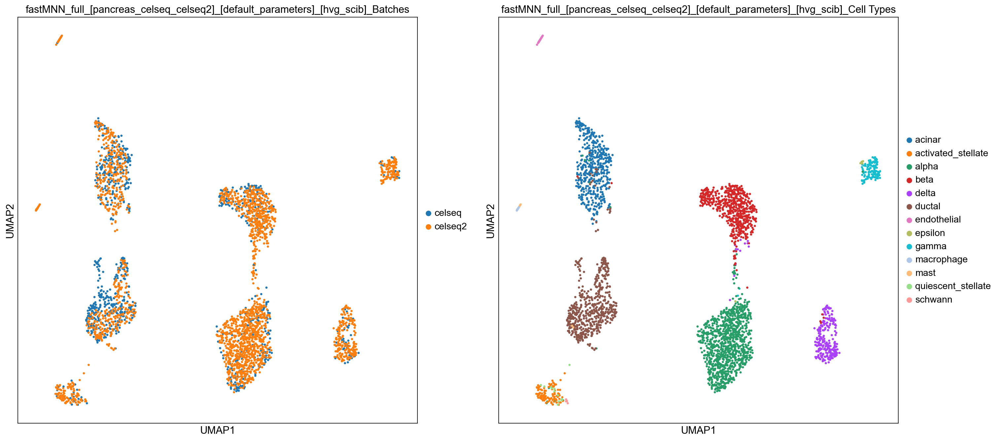

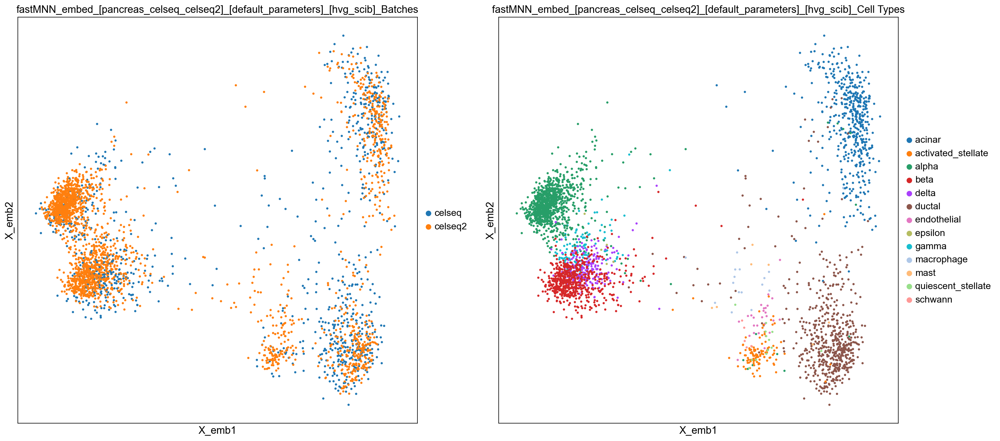

   • The scatterplot of celseq_celseq2's was generated in 10.68 seconds.


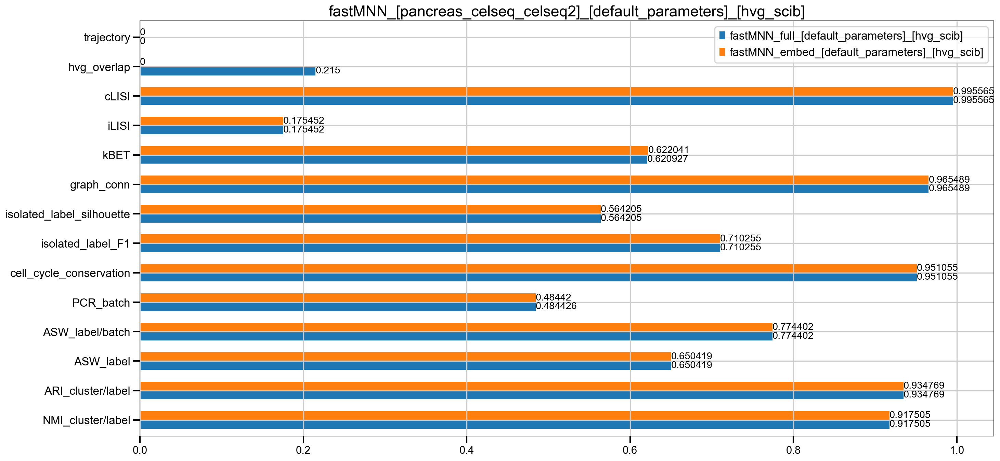

   • The metrics evaluation of celseq_celseq2's was completed in 162.75 seconds.
   • Visualize 'inDrop2_inDrop4' after integration
fastMNN_default_parameters_[pancreas_inDrop2_inDrop4]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


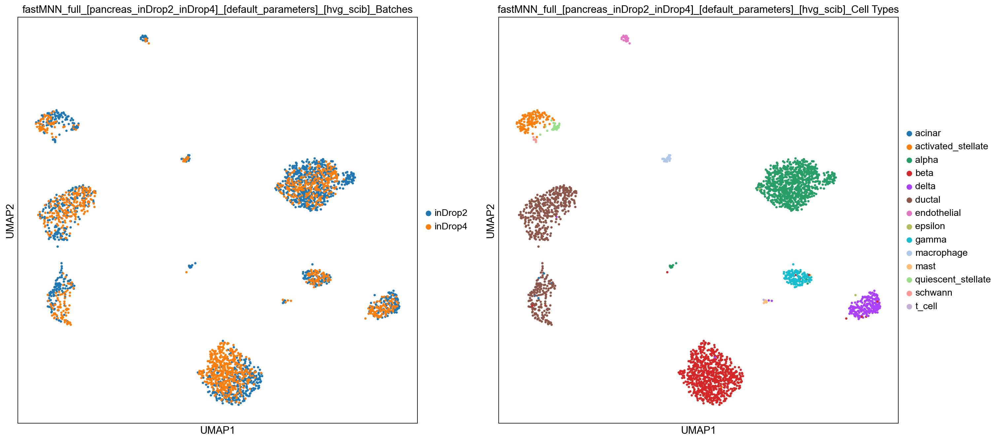

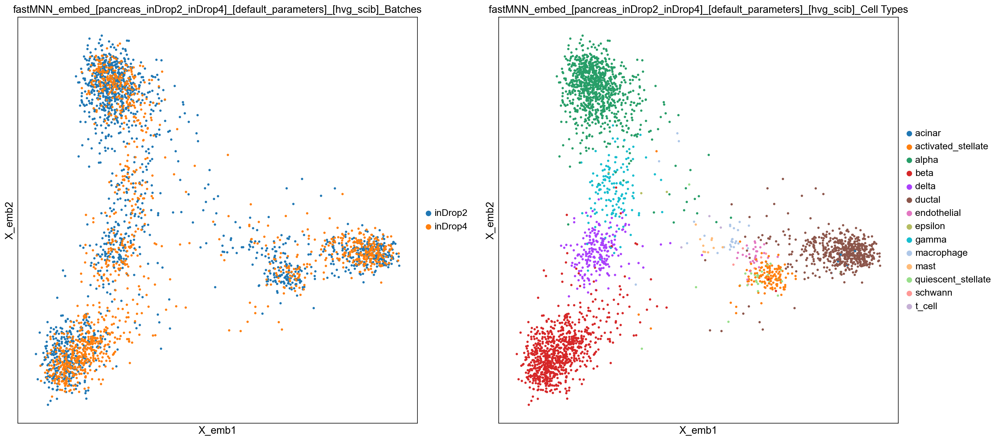

   • The scatterplot of inDrop2_inDrop4's was generated in 10.21 seconds.


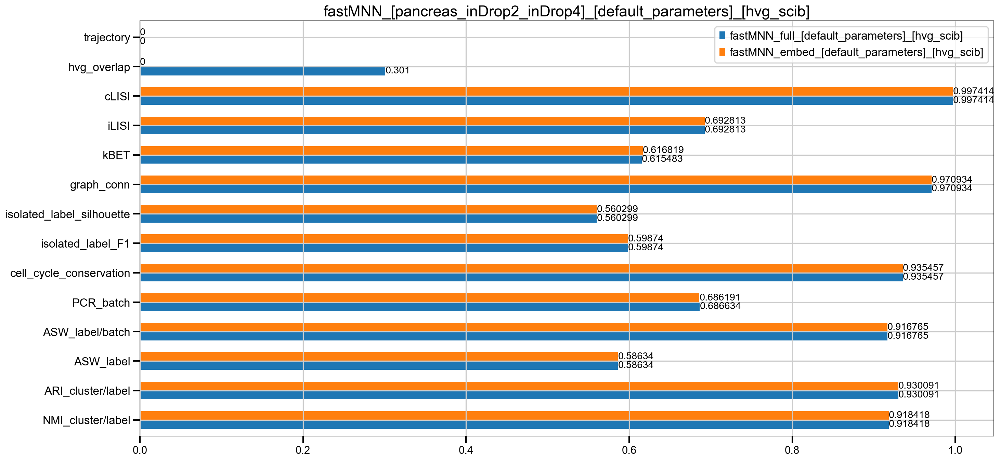

   • The metrics evaluation of inDrop2_inDrop4's was completed in 172.62 seconds.


In [33]:
print("‣ Running fastMNN------ ")
print("‣‣‣ Using Default Prameters------ ")
kwargs={
        'method':"fastMNN",
        'label_key':label_key,
        'running_type':"default",
        'data_type':data_type,
        'data_ids':list(data_objects),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"fastMNN"),
        'r_input_dir':r_input_dir,
        
        #fastMNN parameters
        'prop_k': -1, #
        'restrict': -1,
        'cos_norm': True,
        'ndist': 3,
        'd': 50,
        'deferred': True,
        'weights': -1,
        'get_variance': False,
        'merge_order': -1,
        'auto_merge': False,
        'min_batch_skip': 0,
        'subset_row': -1,
        'correct_all': False,
        'assay_type': "logcounts",
        #####################################
        # please update this variable
        'custom_title':"default_parameters",
        #####################################

    }
fastMNN_integrated_datasets=fastMNN(**kwargs).corrected_datasets
run_evaluation(fastMNN_integrated_datasets,data_objects,**kwargs)
logger (**kwargs)

***Comments:***
 - According to the umap plots (colored by batch information), we can observe that datapoints in celseq/celseq2 are not well mixed compared to inDrop2/inDrop4, this indicates that inDrop2/inDrop4 represents more diversity in each group compared to the other pair of batches, which is reflected in the ilisi score. 
 
 - In terms of cell-types-based metrics, we can easily observe that both dataset should result in a high score, as their umap plots show that data points are grouped based on their cell types information.
 
 - However, silhouette score show a low score for inDrop2/inDrop4 compared to celseq/celseq2
 

### 3.4 Scanorama (Brian, et al., ***Nature Biotechnology, 2019***)


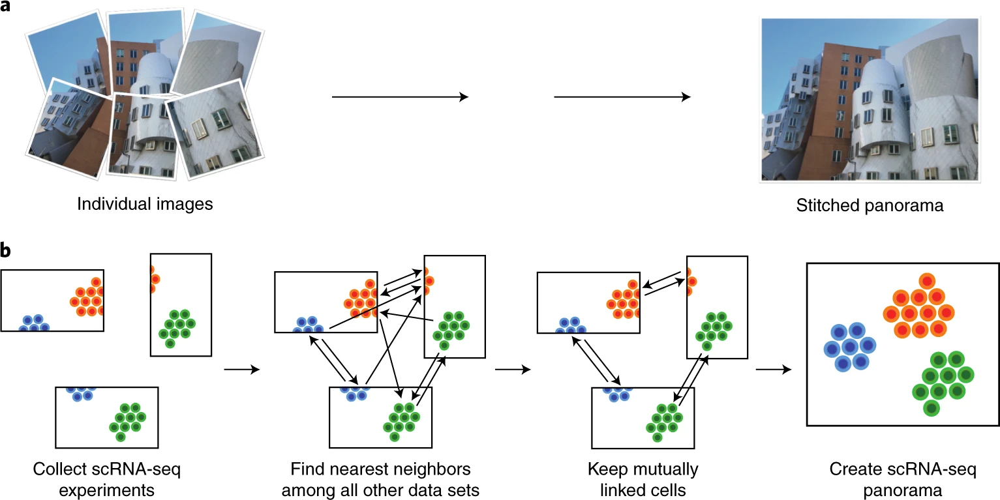
Credit: https://doi.org/10.1038/s41587-019-0113-3

#### 3.4.1 Workflow

- Dimensionality reduction using randomized SVD.
     * Compute a compressed, low-dimensional embedding of the gene expression values for each cell by taking the SVD of the combined cell-by-gene expression matrix.
     * Dimensionality is reduced to 100.
     
- All-to-all dataset matching.
   
     * For each dataset, we queried for its cells’ nearest neighbors among the cells of all remaining datasets in the low-dimensional embedding space.
     * K=20
     
- Nonlinear dataset merging and panorama stitching.
     * After identifying mutual nearest neighbor matches between datasets, we merged connected components of datasets into larger panoramas. 
     * We built on the nonlinear batch-correction strategy of that maps one scRNA-seq dataset onto another by computing translation vectors in the full gene expression space for all cells in a dataset.
     * Translation vectors for each cell were obtained as a weighted average of the matching vectors (defined by the pairs of matched cells), where a Gaussian kernel function upweights matching vectors belonging to nearby points.





#### 3.4.2 Parameters

* datasets_full : `list` of `scipy.sparse.csr_matrix` or of `numpy.ndarray` Data sets to integrate and correct.
* alpha: `float`, optional (default: 0.10) Alignment score minimum cutoff.
* knn: `int`, optional (default: 20) Number of nearest neighbors to use for matching.
* genes_list: `list` of `list` of `string` List of genes for each data set.
* return_dimred: `bool`, optional (default: `False`) In addition to returning batch corrected matrices, also returns integrated low-dimesional embeddings.

* dimred: `int`, optional (default: 100) Dimensionality of integrated embedding.
* sigma: `float`, optional (default: 15) Correction smoothing parameter on Gaussian kernel.

* hvg: `int`, optional (default: None) Use this number of top highly variable genes based on dispersion.

* seed: `int`, optional (default: 0) Random seed to use.

In [34]:
import scib.utils as utils

In [35]:
import sys
if sys.version_info.major == 3 and sys.version_info.minor >= 10:
    from collections.abc import MutableSet
    collections.MutableSet = collections.abc.MutableSet
else: 
    from collections import MutableSet
class scanorama:
    def __init__(self,**kwargs):
        self.corrected_datasets={}
        try:
            os.mkdir(kwargs["output_dir"])
        except:
            pass
        self.run_scanorama(**kwargs)
        
    
    def run_scanorama(self,**kwargs):
        st_scanorama= time.time()
        for data_id in kwargs["data_ids"]:
            st_scanorama_d= time.time()
            self.custom_title="_" if kwargs["custom_title"]=="" else "_{}".format(kwargs["custom_title"])
            print(" ⦿ Running {} for {}".format(kwargs["method"],data_id))
            dd=kwargs["adata"][data_id]
            self.corrected_datasets[data_id]=self.scanorama(data_id,**kwargs)
            et_scanorama_d= time.time()
            print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,kwargs["method"],round((et_scanorama_d-st_scanorama_d),2)))
        et_scanorama= time.time()
        print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(kwargs["method"],round((et_scanorama-st_scanorama),2)))
        

    def scanorama(self,data_id,**kwargs):
        adata=kwargs["adata"][data_id]
        """Scanorama wrapper function
        Based on `scanorama <https://github.com/brianhie/scanorama>`_ version 1.7.0
        :param adata: preprocessed ``anndata`` object
        :param batch: batch key in ``adata.obs``
        :param hvg: list of highly variables to subset to. If ``None``, the full dataset will be usedintegrated=runIntegration(adata.copy(), outpath, method,  hvgs=adata.var_names, batch="tech")
        :return: ``anndata`` object containing the corrected feature matrix as well as an embedding representation of the
            corrected data
        """
        try:
            import scanorama
        except ModuleNotFoundError as e:
            raise OptionalDependencyNotInstalled(e)

        utils.check_sanity(adata, kwargs["batch_key"], list(adata.var_names))
        split, categories = utils.split_batches(adata.copy(), kwargs["batch_key"],return_categories=True)
        corrected = scanorama.correct_scanpy(split, **kwargs["scanorama_parameters"])
        corrected = utils.merge_adata(
            *corrected, batch_key=kwargs["batch_key"], batch_categories=categories, index_unique=None
        )
        corrected.obsm["X_emb"] = corrected.obsm["X_scanorama"]
        #fastMNN_custom_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]
        filename="{}/{}_{}_[{}_{}]_[{}_features]{}.h5ad".format(kwargs["output_dir"],kwargs["method"],kwargs["custom_title"],kwargs["data_type"],data_id,kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
        scanpy.write(adata=corrected, filename=filename)
        return corrected

#### 3.4.3 Test Scanorama

‣ Running scanorama------ 
‣‣‣ Changing Default Prameters------ 
 ⦿ Running scanorama for celseq_celseq2
Found 2000 genes among all datasets
   • The integration of celseq_celseq2 has been completed by scanorama in 4.33 seconds.
 ⦿ Running scanorama for inDrop2_inDrop4
Found 2000 genes among all datasets
   • The integration of inDrop2_inDrop4 has been completed by scanorama in 4.36 seconds.
 ✔️ The integration of all tasks has been completed by scanorama in 8.69 seconds.
 ⦿ Evaluating the results...
   • Visualize 'celseq_celseq2' after integration
scanorama_default_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]


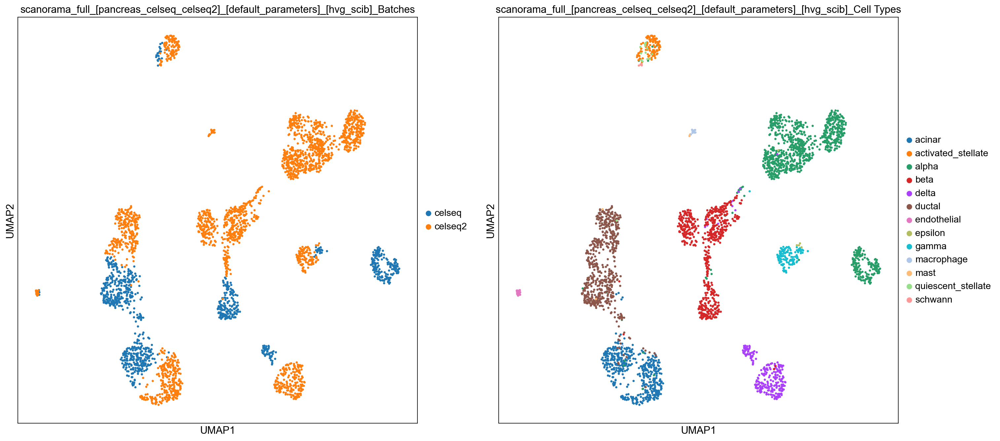

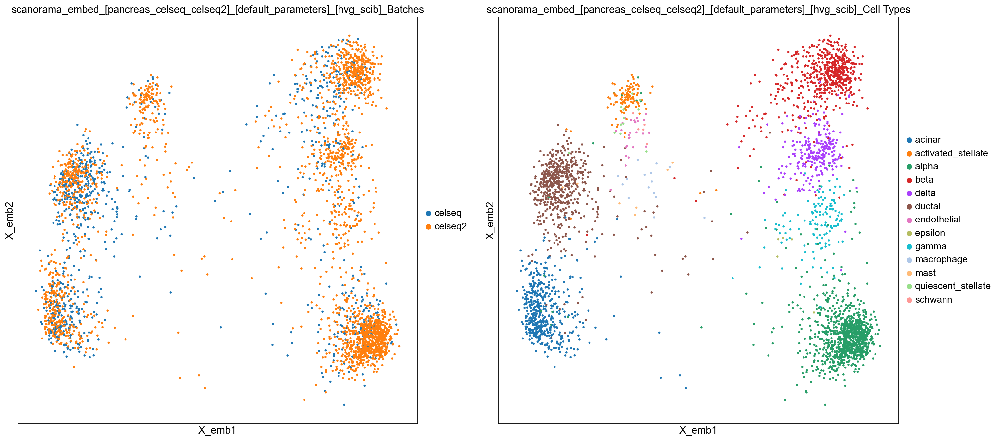

   • The scatterplot of celseq_celseq2's was generated in 8.82 seconds.


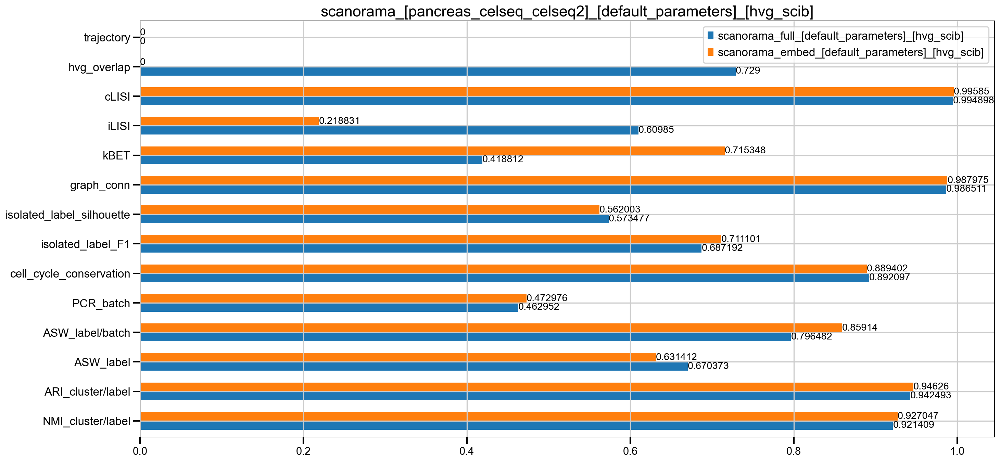

   • The metrics evaluation of celseq_celseq2's was completed in 157.93 seconds.
   • Visualize 'inDrop2_inDrop4' after integration
scanorama_default_parameters_[pancreas_inDrop2_inDrop4]_[hvg_scib_features]


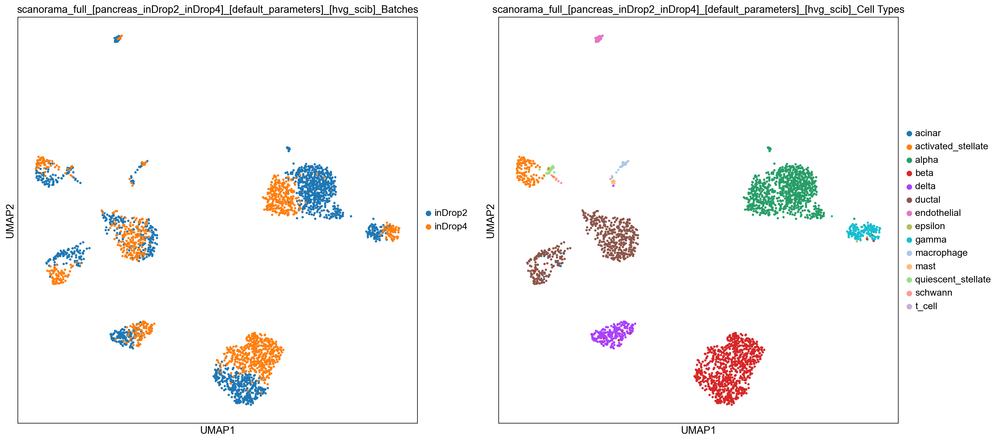

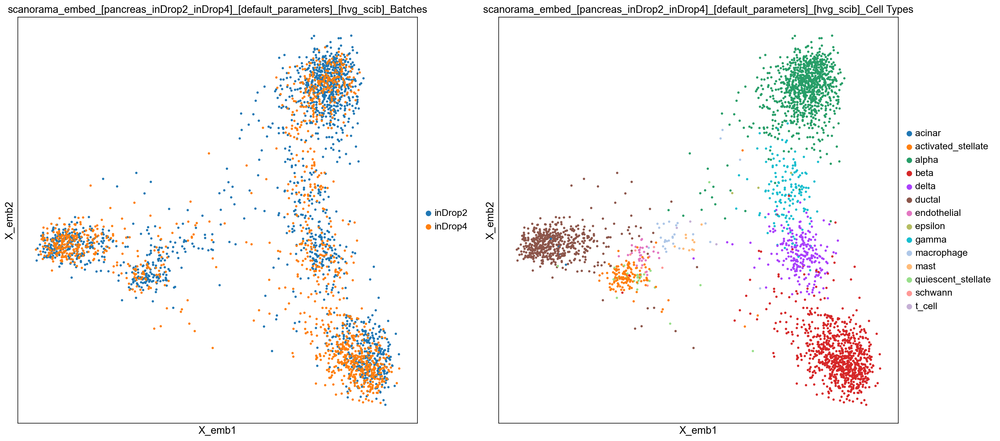

   • The scatterplot of inDrop2_inDrop4's was generated in 7.19 seconds.


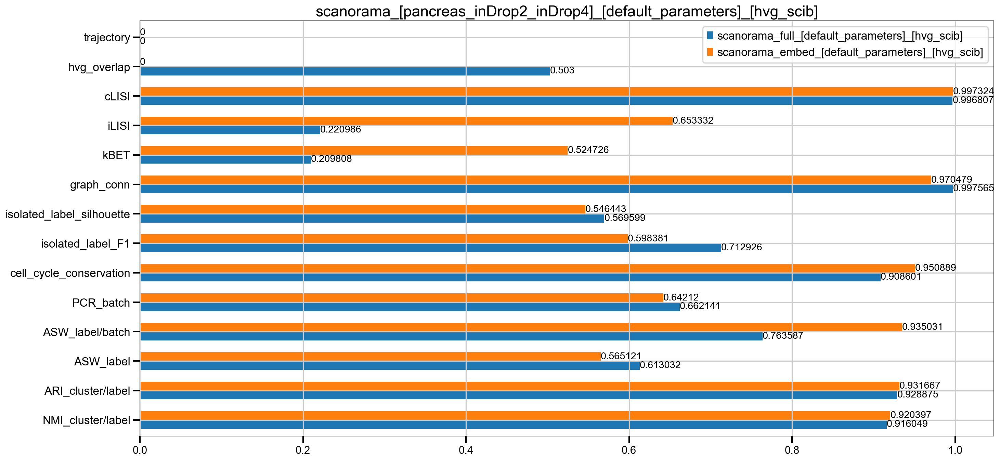

   • The metrics evaluation of inDrop2_inDrop4's was completed in 136.3 seconds.


In [36]:
print("‣ Running scanorama------ ")
print("‣‣‣ Changing Default Prameters------ ")

running_type="default"
kwargs={
    'label_key':label_key,
    'method':"scanorama",
    'running_type':running_type,
    'data_type':data_type,
    'data_ids':list(data_objects),
    'adata':data_objects,
    'batch_key':batch_key,
    'hvg_type': hvg_type,
    'scale': scale,
    'output_dir':"{}/{}/".format(output_dir,"scanorama"),
    'r_input_dir':r_input_dir,
     # Default parameters.
    'scanorama_parameters':{
   
        'return_dimred':True, 
        'ds_names':None, #`list` of `string`, optional When `verbose=True`, reports data set names in logging output.
        'return_dense':False, #bool`, optional (default: `False`). Return `numpy.ndarray` matrices instead of `scipy.sparse.csr_matrix`.
        'hvg':None,  #`int`, optional (default: None). Use this number of top highly variable genes based on dispersion.
        'union':False, # 
        'seed':0, # `int`, optional (default: 0). Random seed to use.
        'alpha' : 0.10, # `float`, optional (default: 0.10). Alignment score minimum cutoff.
        'approx' : True, #`bool`, optional (default: `True`). Use approximate nearest neighbors, greatly speeds up matching runtime.
        'batch_size' : 5000, # `int`, optional (default: `5000`).The batch size used in the alignment vector computation. Useful whencorrecting very large (>100k samples) data sets. Set to large value that runs within available memory.
        'dimred' : 100, # `int`, optional (default: 100). Dimensionality of integrated embedding.
        'knn' : 20, #`int`, optional (default: 20). Number of nearest neighbors to use for matching.
        'sigma' : 15, #`float`, optional (default: 15). Correction smoothing parameter on Gaussian kernel.
        'verbose' : 0},
    #####################################
    # please update this variable
    'custom_title':"default_parameters",
    #####################################
}

scanorama_integrated_datasets=scanorama(**kwargs).corrected_datasets
run_evaluation(scanorama_integrated_datasets,**kwargs)
logger (**kwargs)

***Comments***
- Scanorama is a good example that demonstrates the biggest difference between the feature/genes-based output and the embedded version. 

- According to the UMAP plot (colored based on batch information), we observe that the feature/genes-based output suffers from batch effects, where data points are grouped based on their batch, while we observe mixed batches in the embedded version. This results in a high iLisi score for the embedded version compared to the feature/genes-based version.

- In terms of cLisi score, we can easily observe that data points are grouped according to their cell type information, resulting in a high cLisi score for both versions.

- kBET confirms our observation as well.

- In terms of graph connectivity, we observe that the original dataset shows a higher score compared to the embedded version.
 

### 3.5 scANVI  (Chenling, el al., ***Molecular Systems Biology, 2021***)

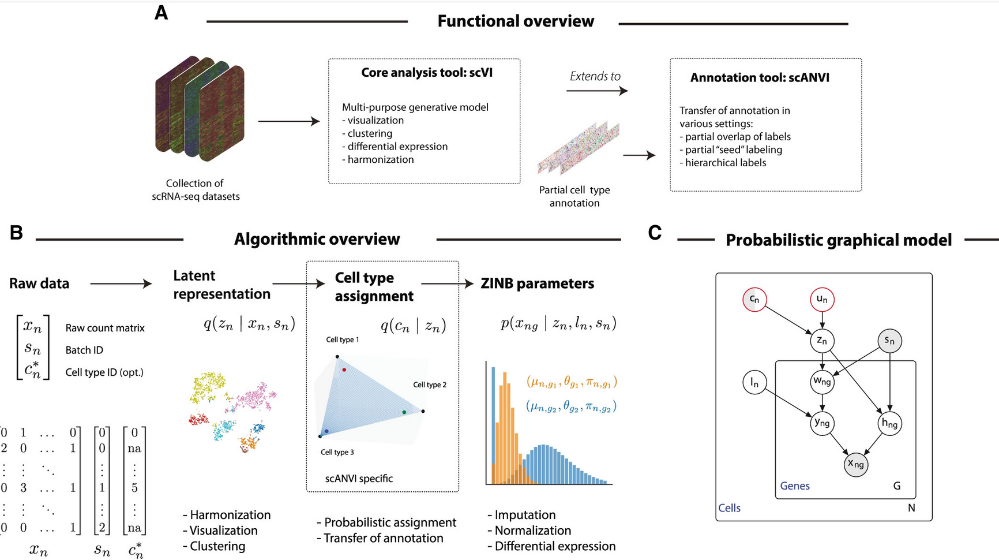
https://doi.org/10.15252/msb.20209620

#### 3.5.1 Introduction
SCANVI (Single-Cell ANnotation using Variational Inference) is a computational method for single-cell RNA sequencing (scRNA-seq) analysis that integrates cell type annotation and gene expression variability. 

SCANVI is a probabilistic model that learns a joint representation of cell types and gene expression from scRNA-seq data. The model is based on a variational autoencoder (VAE) that learns a low-dimensional latent representation of the scRNA-seq data, which is used to predict cell type annotations.

SCANVI leverages prior knowledge about cell types to improve cell type annotation accuracy and can handle missing data, batch effects, and rare cell types. The method also provides a measure of uncertainty for cell type annotation.

Overall, SCANVI is a powerful method for scRNA-seq analysis that can improve cell type annotation accuracy and aid in understanding gene expression variability.

#### 3.5.2 Workflow
* Normalization Dataset
- Harmonization
    * Integration of two or more transcriptomics datasets into a single dataset on which any downstream analysis can be applied.

* Preprocess the data to remove, for example, genes that are very lowly expressed and other outliers.
* Perform feature selection, to reduce the number of features 
- Visualization without batch correction
    * Demonstrate the presence of nuisance variation with respect to nuclei/whole cell, age group, and donor by plotting the UMAP results of the top 30 PCA components for the raw count data.
* Clustering on the scVI latent space
* Differential expression


#### 3.5.3 Parameters
* n_latent: Dimensionality of the latent space.
* n_hidden: The number of nodes per hidden layer
* n_layers: Number of hidden layers used for encoder and decoder NNs.
* gene_likelihood:
        * 'b' - Binomial distribution
        * 'nb' - Negative binomial distribution
* train_size: Size of train set. Need to be: 0 < train_size <= 1.
* max_epochs: Number of passes through the dataset.
* scvi_model: Pretrained scvi model
* unlabeled_category: Value used for unlabeled cells in `labels_key` used to setup AnnData with scvi.
* adata: preprocessed ``anndata`` object
* batch: batch key in ``adata.obs``
* celltype: label key in ``adata.obs``

In [37]:
def scvi(adata, batch,  n_latent,n_hidden,n_layers,return_model=False, max_epochs=None,hvg=None):
    
    """scVI wrapper function
    Based on scvi-tools version >=0.16.0 (available through `conda <https://docs.scvi-tools.org/en/stable/installation.html>`_)
    .. note::
        scVI expects only non-normalized (count) data on highly variable genes!
    :param adata: preprocessed ``anndata`` object
    :param batch: batch key in ``adata.obs``
    :param hvg: list of highly variables to subset to. If ``None``, the full dataset will be used
    :return: ``anndata`` object containing the corrected feature matrix as well as an embedding representation of the
        corrected data
    """
    n_latent = kwargs["n_latent"]
    n_hidden = kwargs["n_hidden"]
    n_layers = kwargs["n_layers"]
    try:
        from scvi.model import SCVI
    except ModuleNotFoundError as e:
        raise OptionalDependencyNotInstalled(e)

    # Check for counts data layer
    if "counts" not in adata.layers:
        raise TypeError(
            "Adata does not contain a `counts` layer in `adata.layers[`counts`]`"
        )

    # Defaults from SCVI github tutorials scanpy_pbmc3k and harmonization
    

    # copying to not return values added to adata during setup_anndata
    net_adata = adata.copy()
    if hvg is not None:
        net_adata = adata[:, hvg].copy()
    SCVI.setup_anndata(net_adata, layer="counts", batch_key=batch)

    vae = SCVI(
        net_adata,
        gene_likelihood="nb",
        n_layers=n_layers,
        n_latent=n_latent,
        n_hidden=n_hidden,
    )
    train_kwargs = {"train_size": 1.0}
    if max_epochs is not None:
        train_kwargs["max_epochs"] = max_epochs
    vae.train(**train_kwargs)
    adata.obsm["X_emb"] = vae.get_latent_representation()
    
    if not return_model:
        
        return adata
    else:
        return vae

In [38]:
def scanvi(**kwargs):
    """scANVI wrapper function
    Based on scvi-tools version >=0.16.0 (available through `conda <https://docs.scvi-tools.org/en/stable/installation.html>`_)
    .. note::
        Use non-normalized (count) data for scANVI!
    :param adata: preprocessed ``anndata`` object
    :param batch: batch key in ``adata.obs``
    :param celltype: label key in ``adata.obs``
    :param hvg: list of highly variables to subset to. If ``None``, the full dataset will be used
    :return: ``anndata`` object containing the corrected feature matrix as well as an embedding representation of the
        corrected data
        
    """
    
    running_type=kwargs["running_type"]
    data_type=kwargs["data_type"]
    scale= kwargs["scale"]
    output_dir=kwargs["output_dir"]
    r_input_dir=kwargs["r_input_dir"]


    adata=kwargs["data"]
        
    batch=kwargs["batch"]
    celltype=kwargs["celltype"]
    hvg_type=kwargs["hvg_type"]
    hvgs=kwargs["hvgs"]
    max_epochs=kwargs["max_epochs"]
    n_latent = kwargs["n_latent"]
    n_hidden = kwargs["n_hidden"]
    n_layers = kwargs["n_layers"]
    return_model=kwargs["return_model"]
    try:
        from scvi.model import SCANVI
    except ModuleNotFoundError as e:
        raise OptionalDependencyNotInstalled(e)

    # # Defaults from SCVI github tutorials scanpy_pbmc3k and harmonization
    # this n_epochs_scVI is now default in scvi-tools
    
    if max_epochs is None:
        n_epochs_scVI = int(np.min([round((20000 / adata.n_obs) * 400), 400]))  # 400
        n_epochs_scANVI = int(np.min([10, np.max([2, round(n_epochs_scVI / 3.0)])]))
    else:
        n_epochs_scVI = max_epochs
        n_epochs_scANVI = max_epochs
    vae = scvi(adata, batch,  n_latent,n_hidden,n_layers,max_epochs=n_epochs_scVI,hvg=hvgs, return_model=return_model)

    # STEP 2: RUN scVI to initialize scANVI
    scanvae = SCANVI.from_scvi_model(
        scvi_model=vae,
        labels_key=celltype,
        unlabeled_category="UnknownUnknown",  # pick anything definitely not in a dataset
    )
    scanvae.train(max_epochs=n_epochs_scANVI, train_size=1.0)
    adata.obsm["X_emb"] = scanvae.get_latent_representation()
    
    filename="{}/{}_{}_[{}_{}]_[{}_features]{}.h5ad".format(kwargs["output_dir"],kwargs["method"],kwargs["custom_title"],kwargs["data_type"],data_id,kwargs["hvg_type"],"_[Scaled]" if kwargs["scale"] else "")
    scanpy.write(adata=adata, filename=filename)

    return adata

‣ Running scANVI------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running scANVI for celseq_celseq2


Global seed set to 0
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 400/400: 100%|████████████████████████████████████████████████████████████████████| 400/400 [06:07<00:00,  1.09it/s, loss=1.43e+03, v_num=1]
INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 10/10: 100%|█████████████████████████████████████████████████████████████████████████| 10/10 [00:15<00:00,  1.53s/it, loss=1.5e+03, v_num=1]


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


   • The integration of celseq_celseq2 has been completed by scANVI in 389.07 seconds.
 ⦿ Running scANVI for inDrop2_inDrop4
Epoch 400/400: 100%|█████████████████████████████████████████████████████████████████████████| 400/400 [05:30<00:00,  1.21it/s, loss=635, v_num=1]
INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 10/10: 100%|█████████████████████████████████████████████████████████████████████████████| 10/10 [00:15<00:00,  1.56s/it, loss=708, v_num=1]
   • The integration of inDrop2_inDrop4 has been completed by scANVI in 347.28 seconds.
 ✔️ The integration of all tasks has been completed by scANVI in 736.35 seconds.
 ⦿ Evaluating the results...
   • Visualize 'celseq_celseq2' after integration
scANVI_default_parameters_[pancreas_celseq_celseq2]_[hvg_scib_features]


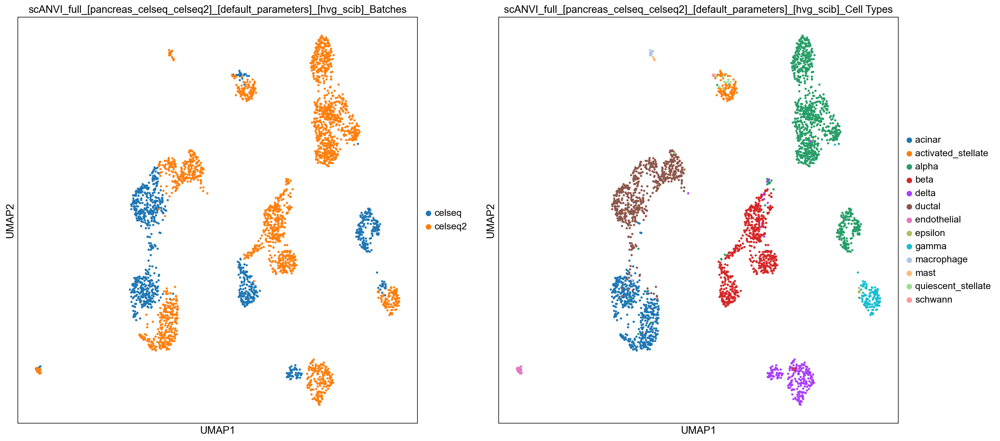

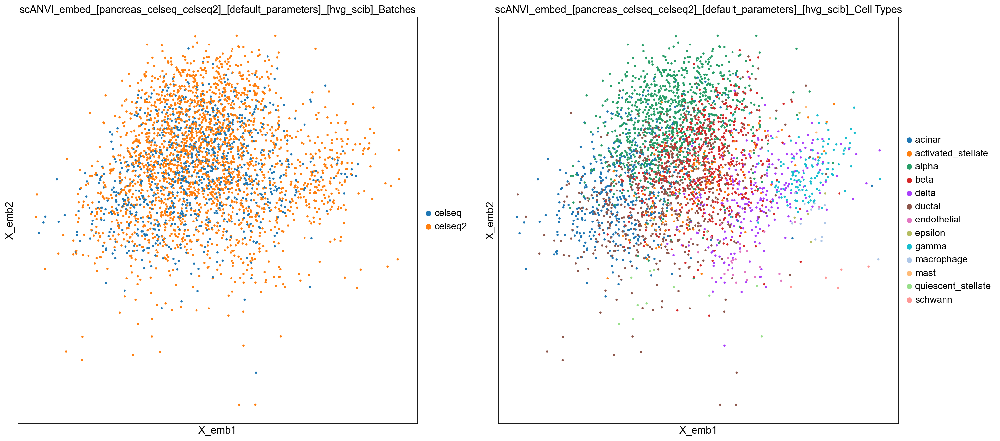

   • The scatterplot of celseq_celseq2's was generated in 7.13 seconds.


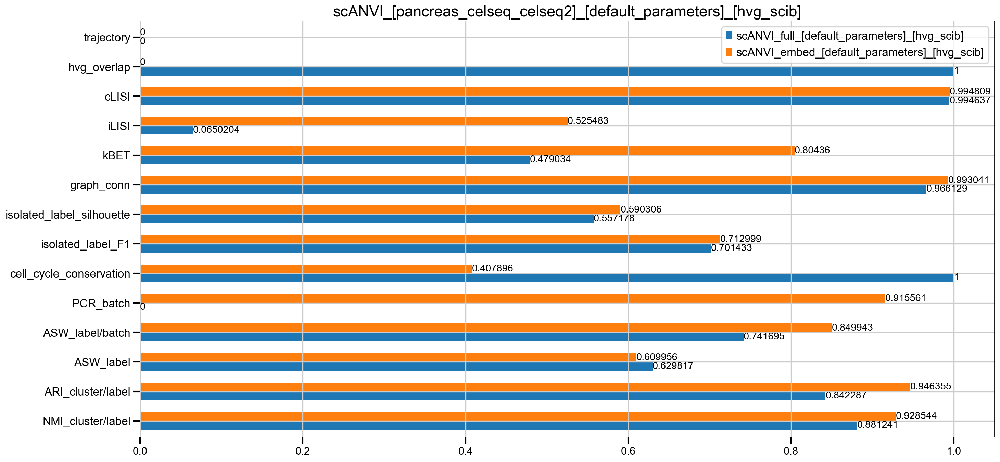

   • The metrics evaluation of celseq_celseq2's was completed in 150.97 seconds.
   • Visualize 'inDrop2_inDrop4' after integration
scANVI_default_parameters_[pancreas_inDrop2_inDrop4]_[hvg_scib_features]


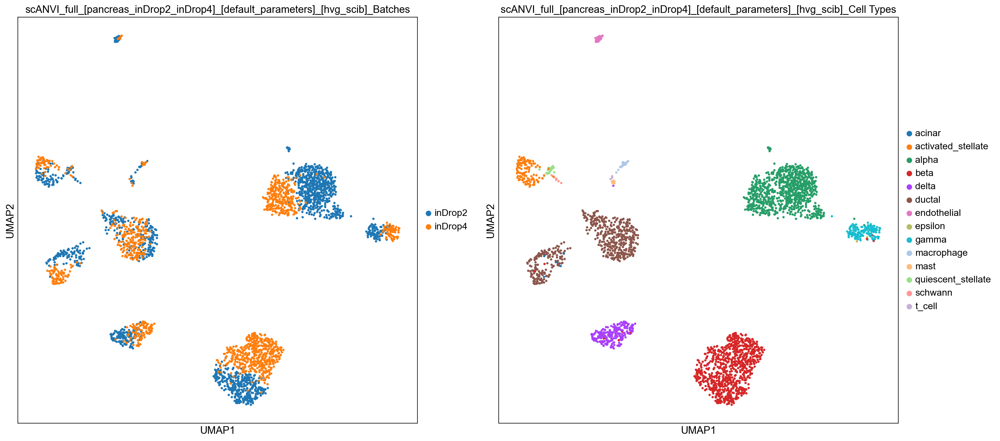

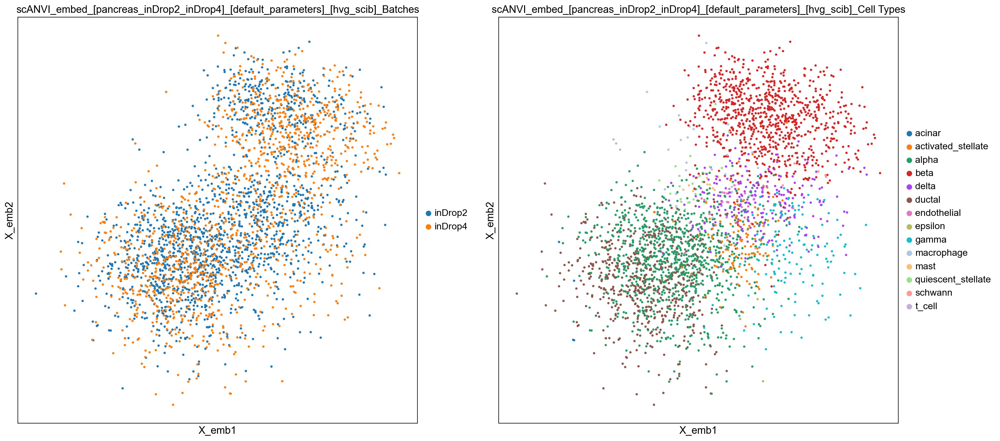

   • The scatterplot of inDrop2_inDrop4's was generated in 7.13 seconds.


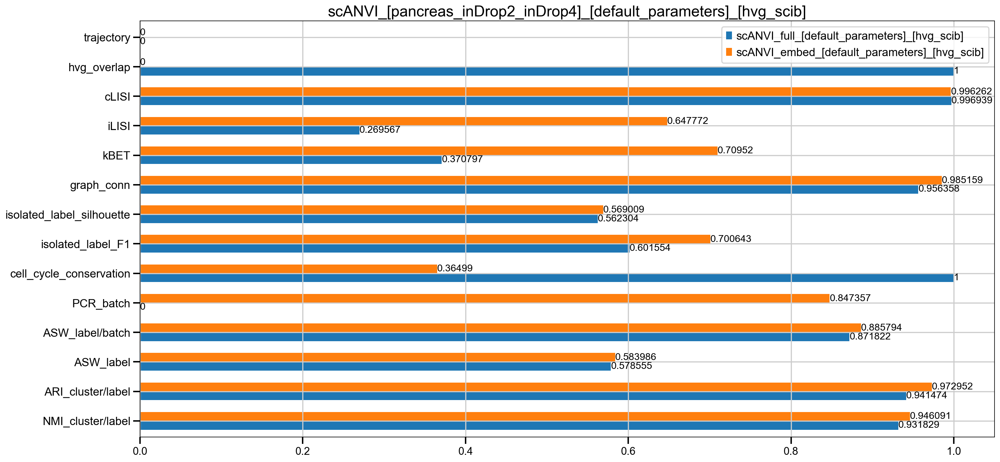

   • The metrics evaluation of inDrop2_inDrop4's was completed in 135.48 seconds.


In [39]:
print("‣ Running scANVI------ ")
print("‣‣‣ Using Default Prameters------ ")
scanvi_corrected_datasets={}
st_scanvi= time.time()
for data_id in data_objects:
    st_scanvi_d= time.time()
    print(" ⦿ Running {} for {}".format("scANVI",data_id))
    
    kwargs={
        
        'method':"scANVI",
        'label_key':label_key,
        'running_type':running_type,
        'data_type':data_type,
        'data_ids':list(data_objects),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"scANVI"),
        'r_input_dir':r_input_dir,
        

        "data":data_objects[data_id], 
        "batch":batch_key, 
        "celltype":label_key, 
        "hvg_type":hvg_type,
        "hvgs":None, 
        "max_epochs":None,
        'n_latent' : 30,
        'n_hidden' : 128,
        'n_layers' : 2,
        "return_model":True,
        "custom_title":"default_parameters"
        

    }
    try:
        os.mkdir(kwargs["output_dir"])
    except:
        pass
    scanvi_corrected_datasets[data_id]=scanvi(**kwargs)
    et_scanvi_d= time.time()
    print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,kwargs["method"],round((et_scanvi_d-st_scanvi_d),2)))
    
et_scanvi= time.time()
print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(kwargs["method"],round((et_scanvi-st_scanvi),2)))

run_evaluation(scanvi_corrected_datasets,data_objects,**kwargs)
logger (**kwargs)

***Comments***
- The UMAP plot for Celseq/Celseq2 is difficult to interpret and extract insights from. However, we can focus on InDrop2/InDrop4, and we can observe that the groups are mixed with multiple batches, which is a good indication of well-integrated data.

- Similarly, for cell types, the cells still retain the grouping based on their cell type information.

- kBET confirms our observation as well.

- In terms of graph connectivity, we observe that the integrated dataset shows a higher score compared to the original dataset.


In [40]:
et_methods = time.time()
print("-------------\n ⦿ The Integration part was completed in : ",(et_methods-st_methods)/60," minutes\n-------------")

-------------
 ⦿ The Integration part was completed in :  35.686730949083966  minutes
-------------


# 4. Compare all Methods

In [41]:
'''
The goal of this cell is to construct a dataframe for each data (pair of batches)
rows: represent metrics
columns: represent methods
'''
s_plot_all_methods=time.time() #timer
results={} #dict that stores all scores: methods vs. scores
for method in full_metrics:
    for data_ in full_metrics[method]: #for each data (pair of batches in ours case)
        if data_ not in results:
            results[data_]=full_metrics[method][data_]
        else:
            results[data_]=pd.concat([results[data_],full_metrics[method][data_]],axis=1)

In [42]:
set(results) #print the nemaes of datasets in the dictinoary

{'celseq_celseq2', 'inDrop2_inDrop4'}

In [43]:
results["inDrop2_inDrop4"]

,Seurat_full_[default_parameters]_[hvg_scib],Harmony_embed_[default_parameters]_[hvg_scib],fastMNN_full_[default_parameters]_[hvg_scib],fastMNN_embed_[default_parameters]_[hvg_scib],scanorama_full_[default_parameters]_[hvg_scib],scanorama_embed_[default_parameters]_[hvg_scib],scANVI_full_[default_parameters]_[hvg_scib],scANVI_embed_[default_parameters]_[hvg_scib]
NMI_cluster/label,0.926867,0.914412,0.918418,0.918418,0.916049,0.920397,0.931829,0.946091
ARI_cluster/label,0.938345,0.927894,0.930091,0.930091,0.928875,0.931667,0.941474,0.972952
ASW_label,0.601697,0.625310,0.586340,0.586340,0.613032,0.565121,0.578555,0.583986
ASW_label/batch,0.918574,0.920714,0.916765,0.916765,0.763587,0.935031,0.871822,0.885794
PCR_batch,0.806449,0.848983,0.686634,0.686191,0.662141,0.642120,0.000000,0.847357
cell_cycle_conservation,0.952869,0.855963,0.935457,0.935457,0.908601,0.950889,1.000000,0.364990
isolated_label_F1,0.656250,0.655053,0.598740,0.598740,0.712926,0.598381,0.601554,0.700643
isolated_label_silhouette,0.574374,0.635370,0.560299,0.560299,0.569599,0.546443,0.562304,0.569009
graph_conn,0.983362,0.955622,0.970934,0.970934,0.997565,0.970479,0.956358,0.985159
kBET,0.536350,0.760945,0.615483,0.616819,0.209808,0.524726,0.370797,0.709520


In [44]:
results["celseq_celseq2"].head() # display a subset of metrics for all applied algorithms

,Seurat_full_[default_parameters]_[hvg_scib],Harmony_embed_[default_parameters]_[hvg_scib],fastMNN_full_[default_parameters]_[hvg_scib],fastMNN_embed_[default_parameters]_[hvg_scib],scanorama_full_[default_parameters]_[hvg_scib],scanorama_embed_[default_parameters]_[hvg_scib],scANVI_full_[default_parameters]_[hvg_scib],scANVI_embed_[default_parameters]_[hvg_scib]
NMI_cluster/label,0.911430,0.926616,0.917505,0.917505,0.921409,0.927047,0.881241,0.928544
ARI_cluster/label,0.931783,0.942511,0.934769,0.934769,0.942493,0.946260,0.842287,0.946355
ASW_label,0.665752,0.662775,0.650419,0.650419,0.670373,0.631412,0.629817,0.609956
ASW_label/batch,0.865317,0.876122,0.774402,0.774402,0.796482,0.859140,0.741695,0.849943
PCR_batch,0.512783,0.642702,0.484426,0.484420,0.462952,0.472976,0.000000,0.915561


## 4.1 Let's create some plots....

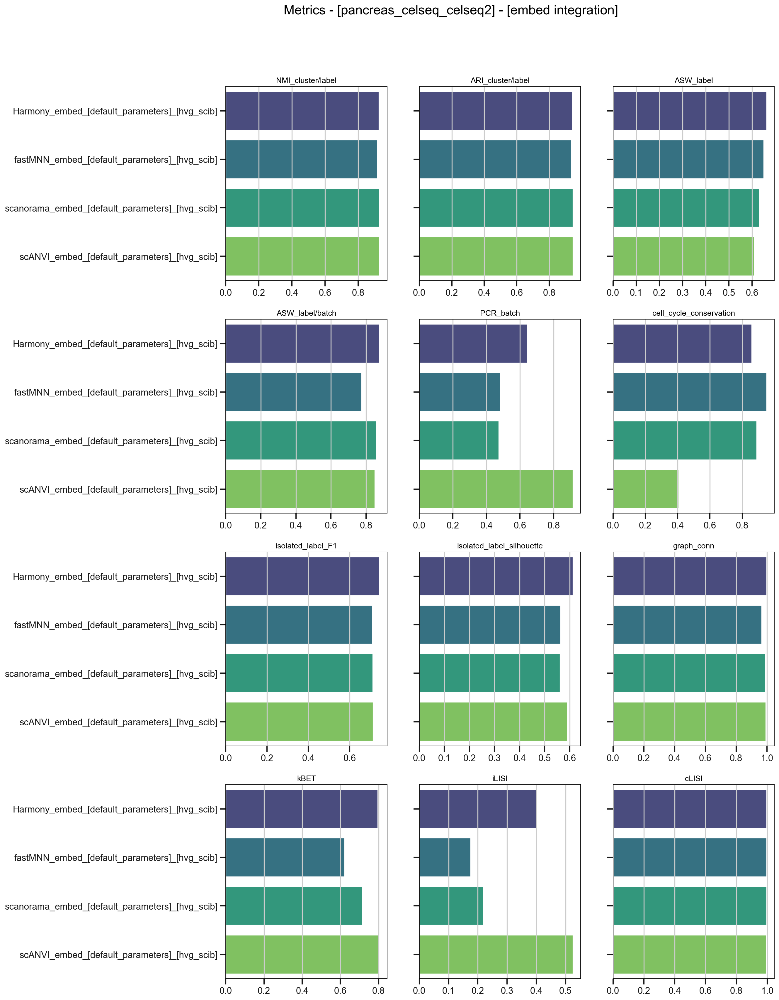

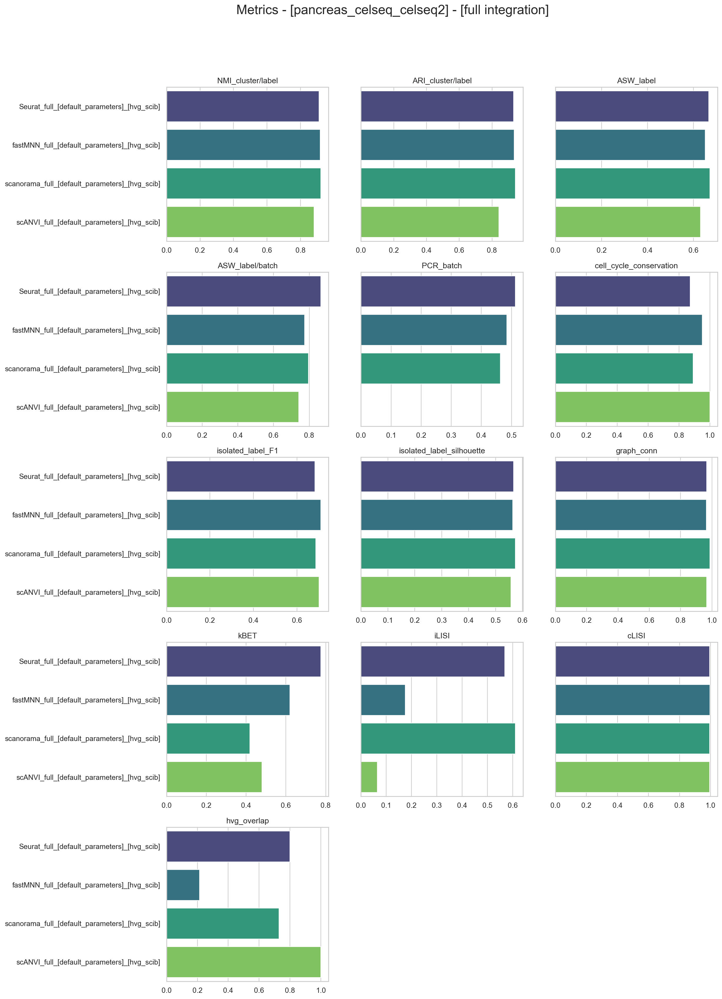

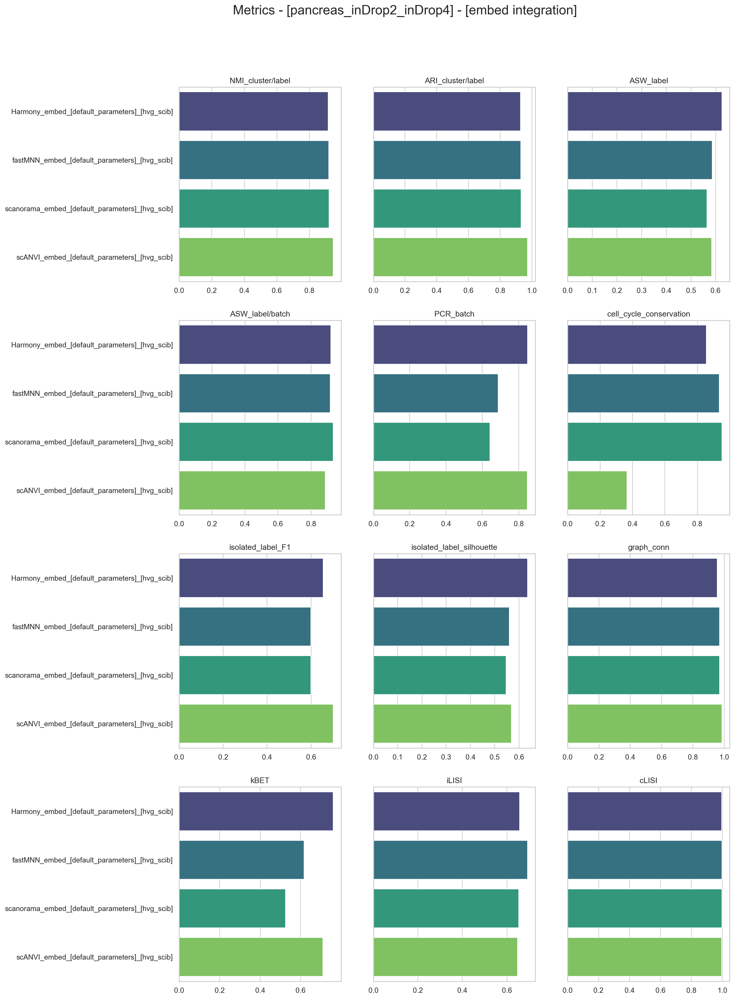

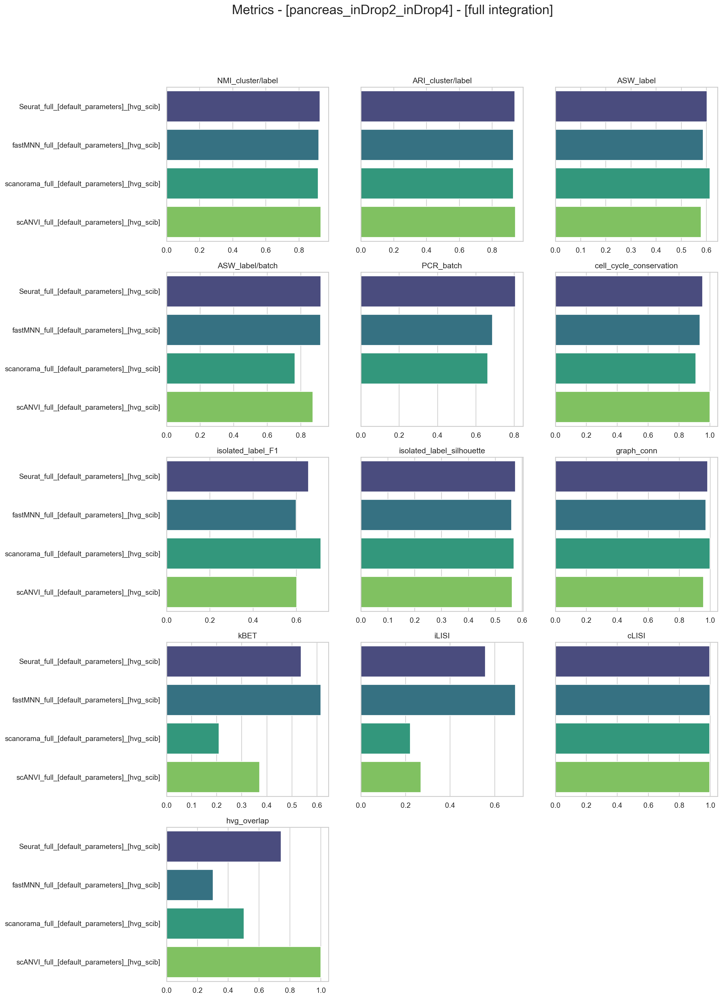

In [45]:
#for each dataset, and for each metric, plot a figure of a metric vs. methods.
for data_ in results:
    for integration_type in ["embed","full"]: #split dataframes, so we compare the embedded-based versions and features-based versions
        full_scores=results[data_].T.loc[[i for i in results[data_].T.index if i.split("_")[1]==integration_type]].dropna(axis=1)

        numberof_methods=math.ceil(full_scores.columns.values.size/3)

        fig, axes = plt.subplots(numberof_methods, 3, figsize=(15, 25), sharey=True)
        fig.suptitle('Metrics - [{}_{}] - [{} integration]'.format(data_type,data_,integration_type),fontsize=20)

        axes_counter_x=0
        axes_counter_y=0
        sns.set_theme(style='whitegrid')

        for i in range(full_scores.columns.values.size):
            if(axes_counter_x!=0 and axes_counter_x%3==0):
                axes_counter_y+=1
                axes_counter_x=0
            sns.barplot(ax=axes[axes_counter_y,axes_counter_x], y = full_scores.index.values,
                    x = full_scores.iloc[:,i], palette='viridis')
            axes[axes_counter_y,axes_counter_x].set_title(full_scores.columns.values[i])
            axes[axes_counter_y,axes_counter_x].set(xlabel=None)
            axes_counter_x+=1

        #delete empty subplots
        del_empty_plot=3-axes_counter_x
        for i in range(del_empty_plot,axes_counter_x-1,-1):
            axes[axes_counter_y,i].set_axis_off()
        plt.show()
        print("\n\n\n\n")

# 5. Integrating Multiple Batches

In the previous section of the Jupyter notebook, we ran all algorithms for a pair of batches. However, in real-world scenarios, we often encounter datasets with multiple batches, which can introduce batch effects and hinder downstream analysis. In this section, we will demonstrate how to integrate multiple batches.

***Note that this section may require a large running time, depending on the size of the dataset and the chosen normalization method. If you encounter any issues with running the code, you can try to run some methods, or alternatively, we are providing the output of the applied algorithms for all existing batches in the original dataset, which consists of 9 batches. You can skip to section 6 in the notebook to load the results and visualize them.***

## 5.1 Preprocessing 

In [46]:
s_full_int=time.time() #timer
adata=anndata # an object that contains the original dataset - you can also select only a subset of the dataset

In [47]:
multiple_batches={"all_batches":adata} # a dict that stores AnnData objects with multiple batchs, the key is the id of the data object
hvg_type=="hvg_scib" #either full or hvg_scib
#selct HVGs
if hvg_type=="hvg_scib": 
    for data_ in multiple_batches:
        multiple_batches[data_]=sc.preprocessing.hvg_batch(
                multiple_batches[data_].copy(),
                batch_key=batch_key,
                target_genes=hvg,
                adataOut=True)

Using 65 HVGs from full intersect set
Using 221 HVGs from n_batch-1 set
Using 274 HVGs from n_batch-2 set
Using 269 HVGs from n_batch-3 set
Using 349 HVGs from n_batch-4 set
Using 435 HVGs from n_batch-5 set
Using 387 HVGs from n_batch-6 set
Using 2000 HVGs


In [48]:
'''
scale: set to true to activate scaling
default, we set it to False, as it did not show good performance in 
the benchmarking studies
'''
scale=False
if scale:
    for data_i in multiple_batches:
        multiple_batches[data_i]=sc.preprocessing.scale_batch(multiple_batches[data_i], batch_key)

### 5.2 Exporting the preprocessed data for R-based methods

In [49]:
for data_i in multiple_batches:
    print("Saving {}'s data".format(data_i))
    filename="[{}_{}]_[{}_features]{}.h5ad".format(data_type,data_,hvg_type,"_[Scaled]" if scale else "")
    r_full_path="{}/{}".format(r_input_dir,filename)
                                          
    sc.preprocessing.save_seurat(multiple_batches[data_i],r_full_path,batch_key)
    print("The R seurat object is saved at: ",r_full_path)

Saving all_batches's data
The R seurat object is saved at:  output/pancreas/workshop/R_input/[pancreas_all_batches]_[hvg_scib_features].h5ad


### 5.3 EDA

#### 5.3.1 Batches vs. #cells


 ⦿ Distribution of cells in the all_batches's data ...


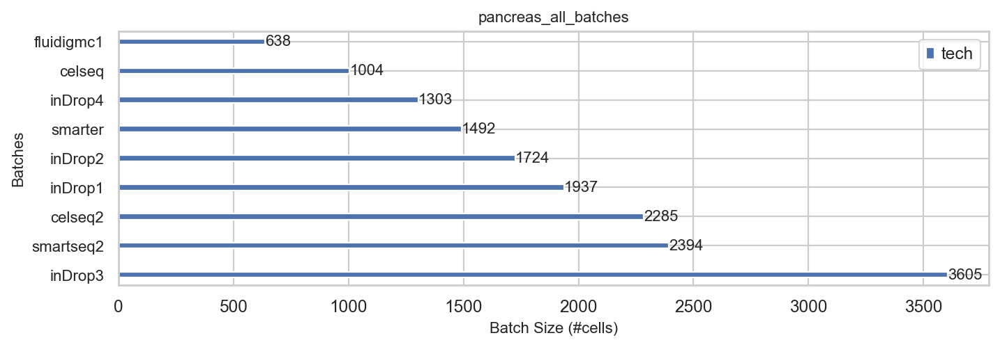

In [50]:
for data_i in multiple_batches:
    
    print(" ⦿ Distribution of cells in the {}'s data ...".format(data_i))

    bt_ncells=pd.DataFrame(multiple_batches[data_i].obs[batch_key].value_counts())
    ax = bt_ncells.plot.barh(width=0.2,linewidth=1,figsize=(10, 3))
    for i in range(len(bt_ncells.columns)):
        ax.bar_label(ax.containers[i],fontsize=10)
    plt.yticks(fontsize=10)
    plt.ylabel("Batches", fontsize=10)
    plt.xlabel("Batch Size (#cells)", fontsize=10)
    plt.title("{}_{}".format(data_type,data_i), fontsize=10)
    plt.show()

#### 5.3.2 UMAP


 ⦿ Plotting scatterplots for each dataset...
         Falling back to preprocessing with `sc.pp.pca` and default params.


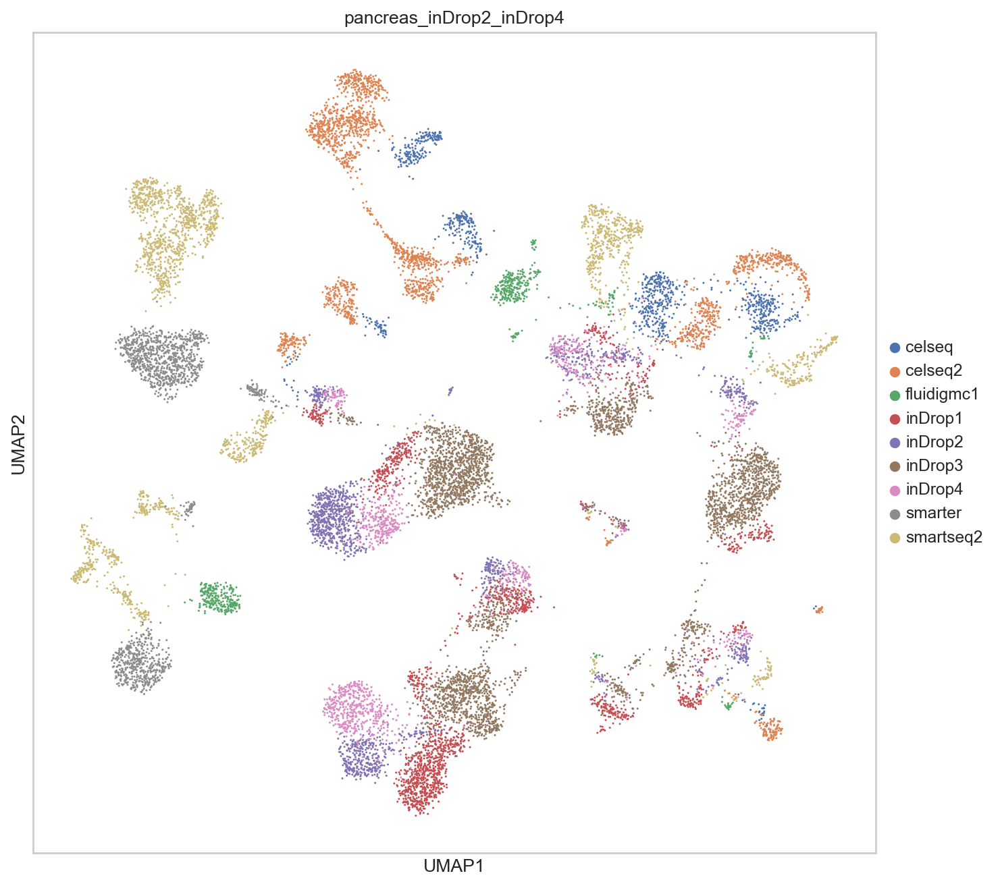

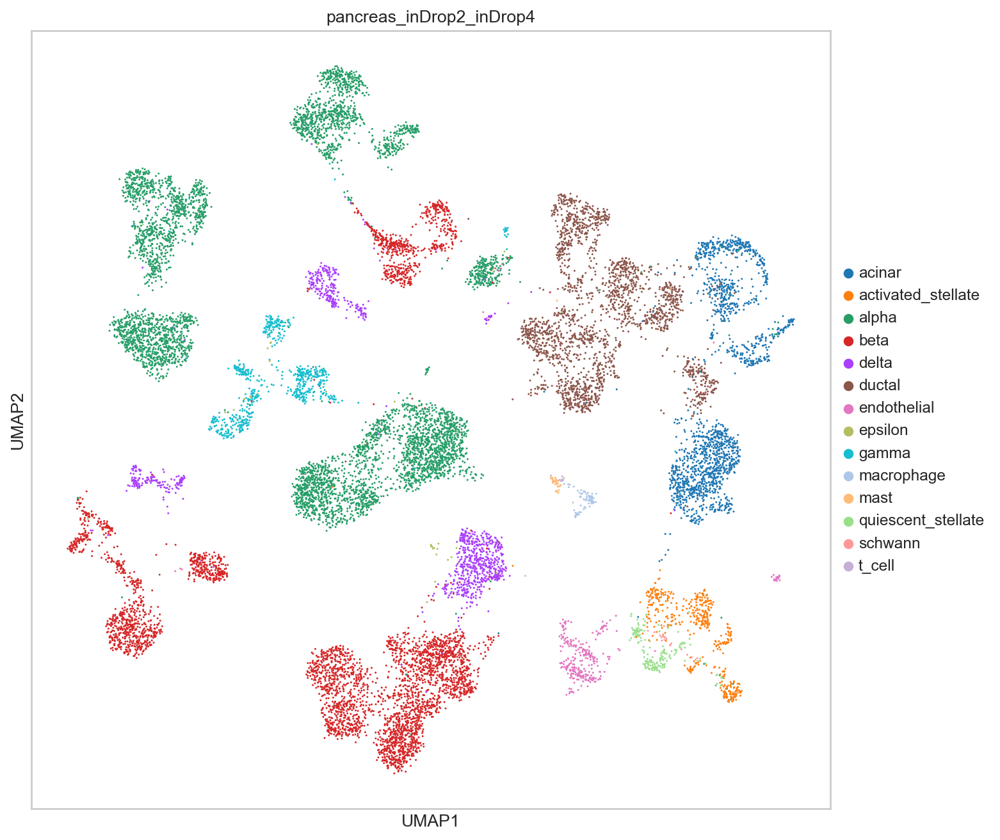

In [51]:
print(" ⦿ Plotting scatterplots for each dataset...")
for data_i in multiple_batches:
    scanpy.pp.neighbors(multiple_batches[data_i])
    scanpy.tl.umap(multiple_batches[data_i])
    scanpy.pl.umap(multiple_batches[data_i],title="{}_{}".format(data_type,pair),color=batch_key)
    plt.show()
    scanpy.pl.umap(multiple_batches[data_i],title="{}_{}".format(data_type,pair),color=label_key)
    plt.show()
    

### 5.3 Integratiing datasets

#### 5.3.1  Seurat

‣ Running Seurat------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running Seurat for all_batches
   • Convert from R object to Python.... 
   • The integration of all_batches has been completed by Seurat in 326.61 seconds.
 ✔️ The integration of all tasks has been completed by Seurat in 326.61 seconds.
 ⦿ Evaluating the results...
   • Visualize 'all_batches' after integration
Seurat_default_parameters_[pancreas_all_batches]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


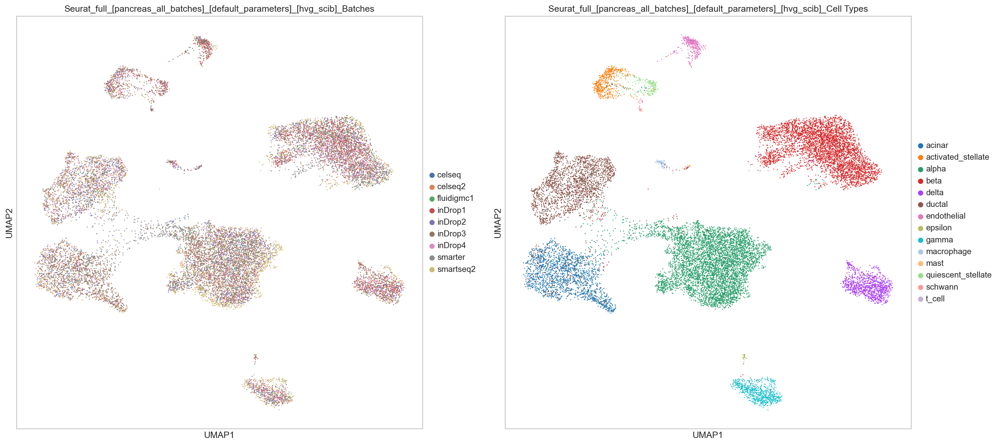

   • The scatterplot of all_batches's was generated in 24.34 seconds.


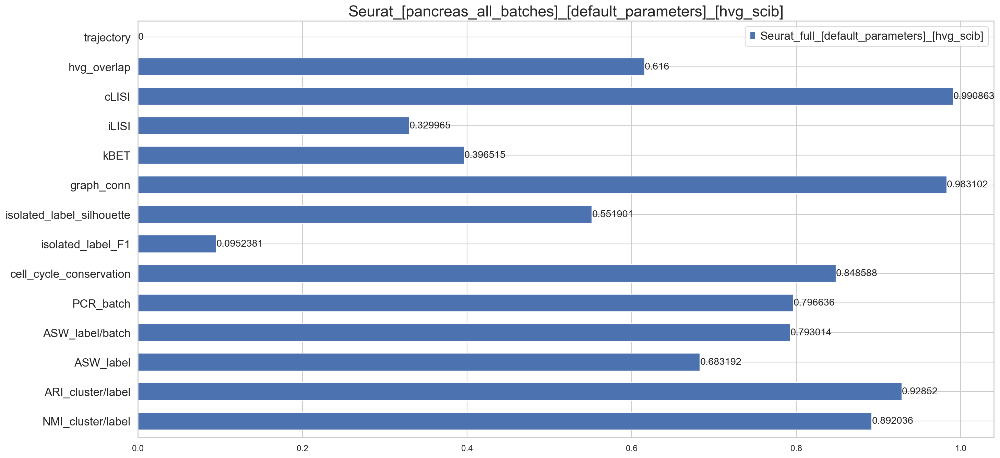

   • The metrics evaluation of all_batches's was completed in 200.62 seconds.


In [52]:
print("‣ Running Seurat------ ")
print("‣‣‣ Using Default Prameters------ ")

kwargs={
        'method':"Seurat",
        'label_key':label_key,
        'running_type':"default",
        'data_type':data_type,
        'data_ids':list(multiple_batches),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"Seurat"),
        'r_input_dir':r_input_dir,
        
        #Seurat parameters
        "k_filter":200, # How many neighbors (k) to use when filtering anchors
        'hvg':2000, # 
        'scale_seurat':True, #
        'l2_norm':True, #
        'max_features':200,# equivalent to max.features
        'eps':0, #  Error bound on the neighbor finding algorithm (from RANN/Annoy)
        'k_anchor':5,# How many neighbors (k) to use when picking anchors
        'k_score':30,# How many neighbors (k) to use when scoring anchors
        'k_weight':100, # Number of neighbors to consider when weighting anchors
        'reduction':"cca", # Dimensional reduction
        #####################################
        # please update this variable
        'custom_title':"default_parameters".format(hvg_type), #title to be displayed in figures and output's filename to distinguish betweeen differnt versions of your runnings
        #####################################
        'verbose':False #
}
seurat_corrected_datasets_mb=Seurat (**kwargs).corrected_datasets
run_evaluation(seurat_corrected_datasets_mb,multiple_batches,**kwargs)
logger (**kwargs)

***Comments:***

- According to the benchmarking studies, "The poorest performing methods are predominantly deep learning approaches".

- In the Seurat UMAP plots, we observed a good batch effect removal and a broad conservation of all cell types.

#### 5.3.2 Harmony

‣ Running Harmony------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running Harmony for all_batches
[1] 0.05
   • Convert from R object to Python.... 
   • The integration of all_batches has been completed by Harmony in 44.5 seconds.
 ✔️ The integration of all tasks has been completed by Harmony in 44.5 seconds.
 ⦿ Evaluating the results...
   • Visualize 'all_batches' after integration
Harmony_default_parameters_[pancreas_all_batches]_[hvg_scib_features]


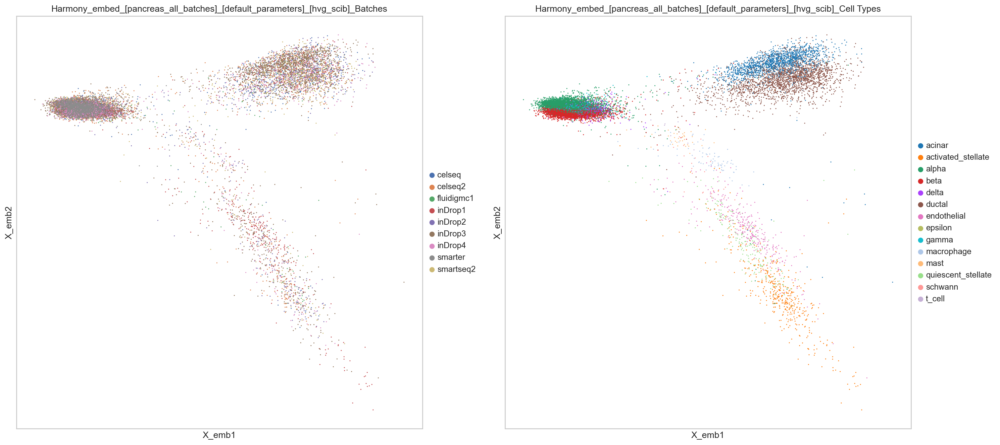

   • The scatterplot of all_batches's was generated in 14.99 seconds.


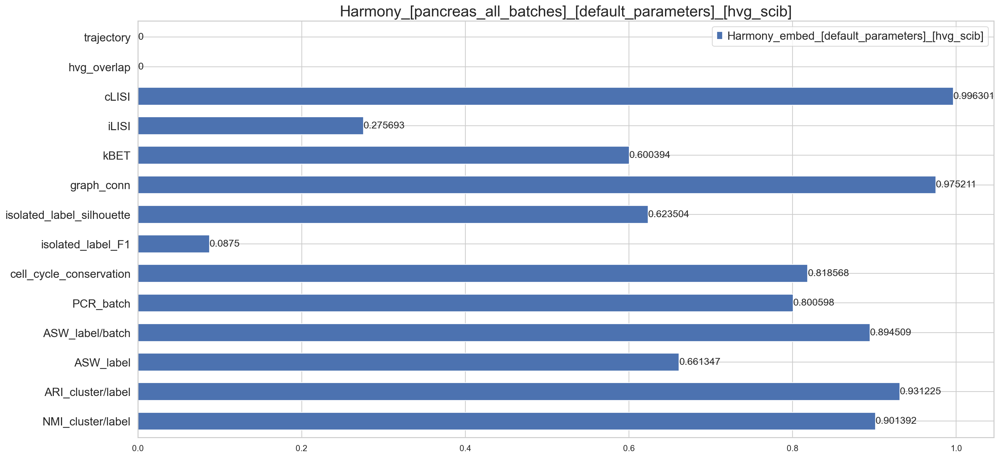

   • The metrics evaluation of all_batches's was completed in 181.76 seconds.


In [53]:
print("‣ Running Harmony------ ")
print("‣‣‣ Using Default Prameters------ ")
running_type="default"
kwargs={
        'method':"Harmony",
        'label_key':label_key,
        'running_type':running_type,
        'data_type':data_type,
        'data_ids':list(multiple_batches),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"Harmony"),
        'r_input_dir':r_input_dir,
        
        #Harmony parameters
        'block_size' :0.05, #
        'max_iter_harmony' : 10, #
        'max_iter_cluster' : 20, #
        'epsilon_cluster' : 1e-05, #
        'epsilon_harmony' : 1e-04, #
        'sigma' : 0.1, #
        'nclust':-1, # -1 equivalent to NULL in R
        'lambda_':-1, # -1 equivalent to NULL in R
        'theta':-1, # -1 equivalent to NULL in R
        #####################################
        # please update this variable
        'custom_title':"default_parameters",
        #####################################

}
harmony_integrated_datasets_mb=Harmony(**kwargs).corrected_datasets
run_evaluation(harmony_integrated_datasets_mb,multiple_batches,**kwargs)
logger (**kwargs)

#### 5.3.3 fastMNN

‣ Running fastMNN------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running fastMNN for all_batches
   • Convert from R object to Python.... 
   • The integration of all_batches has been completed by fastMNN in 56.72 seconds.
 ✔️ The integration of all tasks has been completed by fastMNN in 56.72 seconds.
 ⦿ Evaluating the results...
   • Visualize 'all_batches' after integration
fastMNN_default_parameters_[pancreas_all_batches]_[hvg_scib_features]
         Falling back to preprocessing with `sc.pp.pca` and default params.


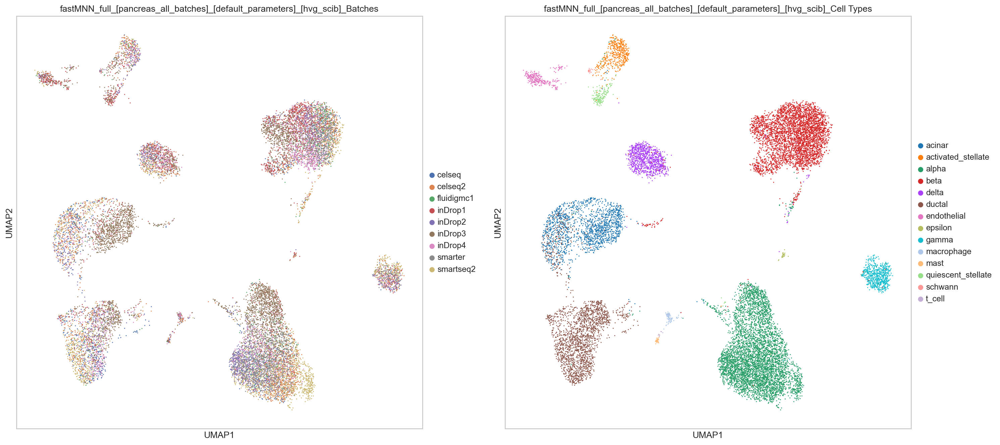

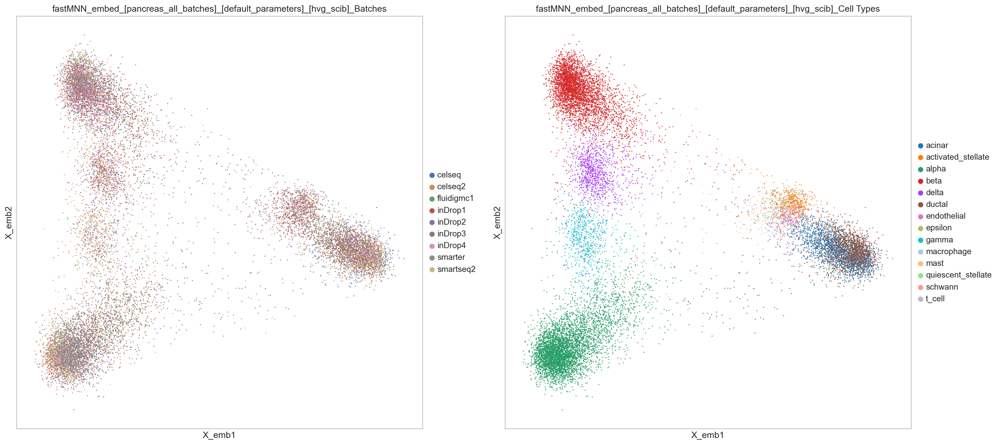

   • The scatterplot of all_batches's was generated in 24.27 seconds.


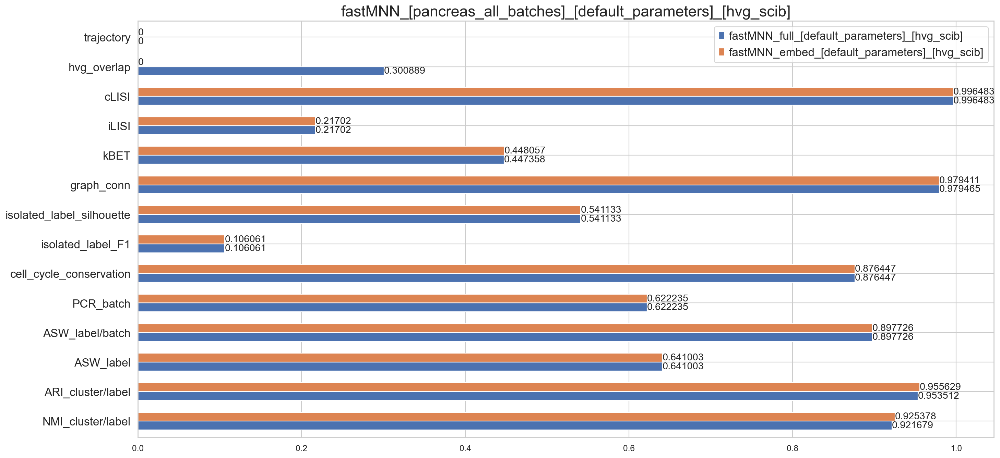

   • The metrics evaluation of all_batches's was completed in 354.0 seconds.


In [54]:
print("‣ Running fastMNN------ ")
print("‣‣‣ Using Default Prameters------ ")
kwargs={
        'method':"fastMNN",
        'label_key':label_key,
        'running_type':"default",
        'data_type':data_type,
        'data_ids':list(multiple_batches),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"fastMNN"),
        'r_input_dir':r_input_dir,
        
        #fastMNN parameters
        'prop_k': -1, #
        'restrict': -1,
        'cos_norm': True,
        'ndist': 3,
        'd': 50,
        'deferred': True,
        'weights': -1,
        'get_variance': False,
        'merge_order': -1,
        'auto_merge': False,
        'min_batch_skip': 0,
        'subset_row': -1,
        'correct_all': False,
        'assay_type': "logcounts",
        #####################################
        # please update this variable
        'custom_title':"default_parameters",
        #####################################

    }
fastMNN_integrated_datasets_mb=fastMNN(**kwargs).corrected_datasets
run_evaluation(fastMNN_integrated_datasets_mb,multiple_batches,**kwargs)
logger (**kwargs)

#### 5.3.4 Scanorama

‣ Running scanorama------ 
‣‣‣ Changing Default Prameters------ 
 ⦿ Running scanorama for all_batches
Found 2000 genes among all datasets
   • The integration of all_batches has been completed by scanorama in 53.24 seconds.
 ✔️ The integration of all tasks has been completed by scanorama in 53.24 seconds.
 ⦿ Evaluating the results...
   • Visualize 'all_batches' after integration
scanorama_default_parameters_[pancreas_all_batches]_[hvg_scib_features]


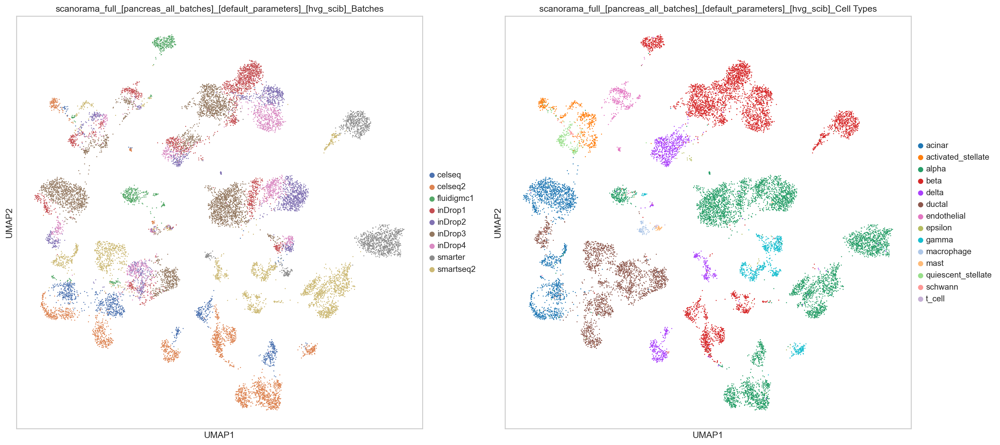

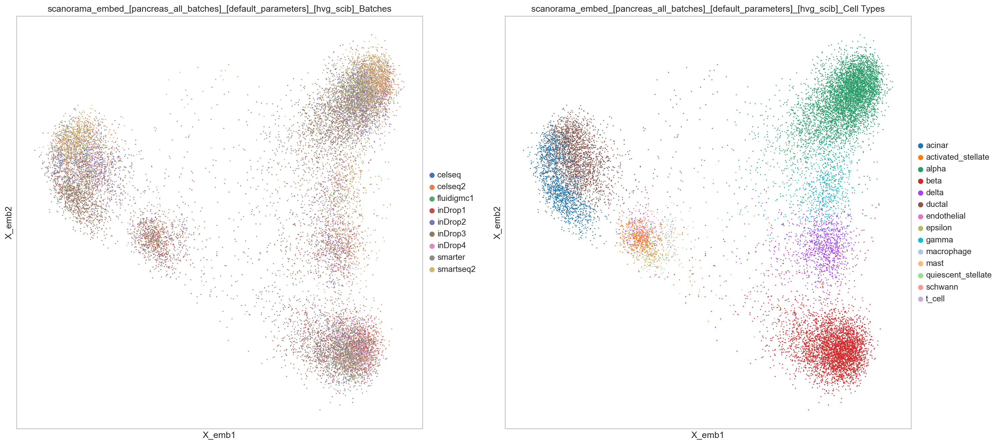

   • The scatterplot of all_batches's was generated in 17.6 seconds.


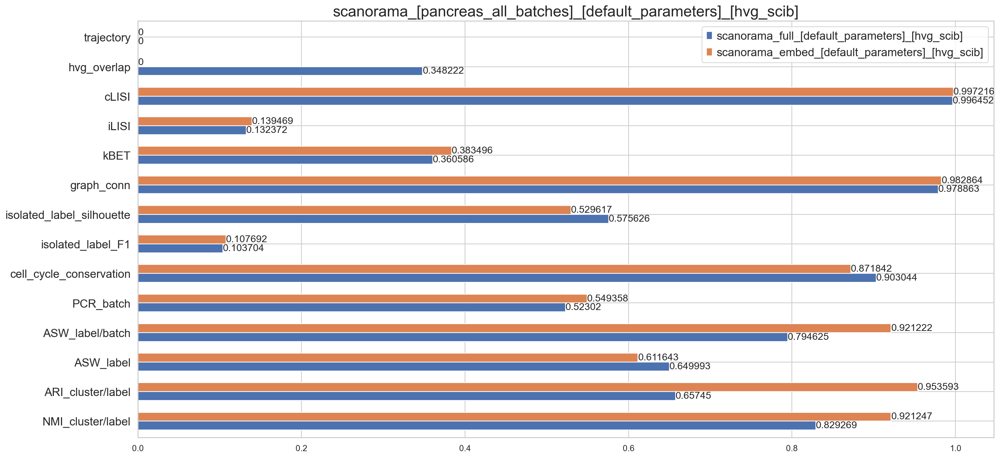

   • The metrics evaluation of all_batches's was completed in 357.51 seconds.


In [55]:
print("‣ Running scanorama------ ")
print("‣‣‣ Changing Default Prameters------ ")

running_type="default"
kwargs={
    'label_key':label_key,
    'method':"scanorama",
    'running_type':running_type,
    'data_type':data_type,
    'data_ids':list(multiple_batches),
    'adata':multiple_batches,
    'batch_key':batch_key,
    'hvg_type': hvg_type,
    'scale': scale,
    'output_dir':"{}/{}/".format(output_dir,"scanorama"),
    'r_input_dir':r_input_dir,
     # Default parameters.
    'scanorama_parameters':{
   
        'return_dimred':True, 
        'ds_names':None, #`list` of `string`, optional When `verbose=True`, reports data set names in logging output.
        'return_dense':False, #bool`, optional (default: `False`). Return `numpy.ndarray` matrices instead of `scipy.sparse.csr_matrix`.
        'hvg':None,  #`int`, optional (default: None). Use this number of top highly variable genes based on dispersion.
        'union':False, # 
        'seed':0, # `int`, optional (default: 0). Random seed to use.
        'alpha' : 0.10, # `float`, optional (default: 0.10). Alignment score minimum cutoff.
        'approx' : True, #`bool`, optional (default: `True`). Use approximate nearest neighbors, greatly speeds up matching runtime.
        'batch_size' : 5000, # `int`, optional (default: `5000`).The batch size used in the alignment vector computation. Useful whencorrecting very large (>100k samples) data sets. Set to large value that runs within available memory.
        'dimred' : 100, # `int`, optional (default: 100). Dimensionality of integrated embedding.
        'knn' : 20, #`int`, optional (default: 20). Number of nearest neighbors to use for matching.
        'sigma' : 15, #`float`, optional (default: 15). Correction smoothing parameter on Gaussian kernel.
        'verbose' : 0},
    #####################################
    # please update this variable
    'custom_title':"default_parameters",
    #####################################
}

scanorama_integrated_datasets_mb=scanorama(**kwargs).corrected_datasets
run_evaluation(scanorama_integrated_datasets_mb,**kwargs)
logger (**kwargs)

#### 5.3.5 scANVI

‣ Running scANVI------ 
‣‣‣ Using Default Prameters------ 
 ⦿ Running scANVI for all_batches


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 400/400: 100%|█████████████████████████████████████████████████████████████████████| 400/400 [29:10<00:00,  4.38s/it, loss=1.5e+03, v_num=1]
INFO     Training for 10 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs


Epoch 10/10: 100%|████████████████████████████████████████████████████████████████████████| 10/10 [01:18<00:00,  7.89s/it, loss=1.53e+03, v_num=1]
   • The integration of all_batches has been completed by scANVI in 1833.6 seconds.
 ✔️ The integration of all tasks has been completed by scANVI in 1833.6 seconds.
 ⦿ Evaluating the results...
   • Visualize 'all_batches' after integration
scANVI_default_parameters_[pancreas_all_batches]_[hvg_scib_features]


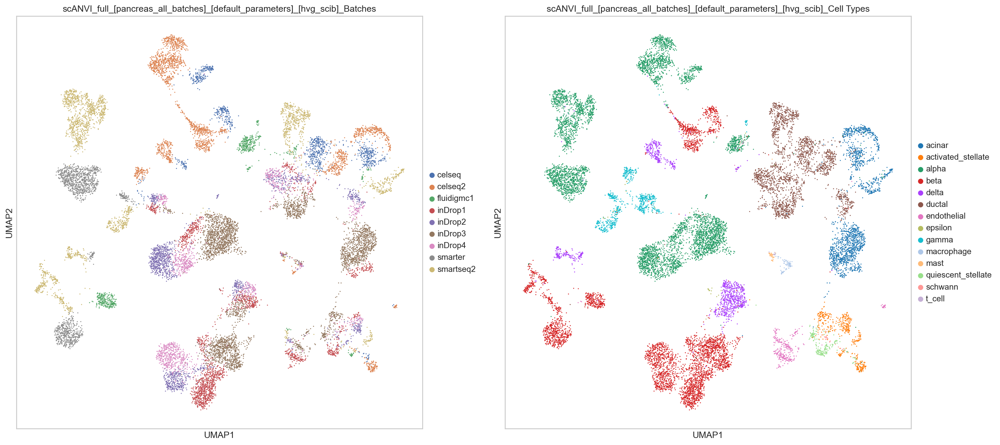

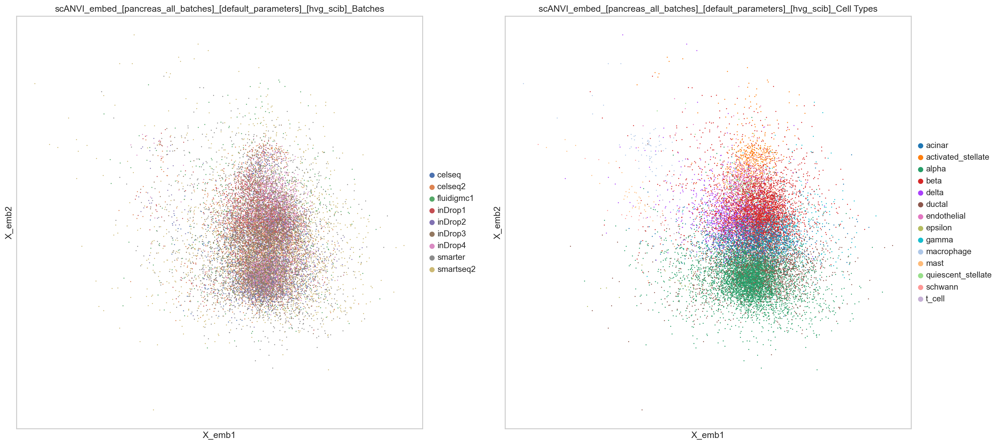

   • The scatterplot of all_batches's was generated in 17.02 seconds.


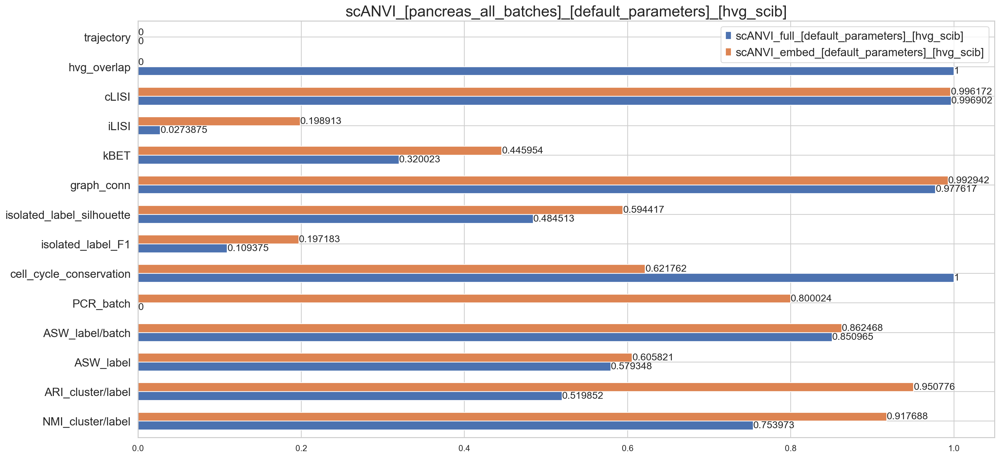

   • The metrics evaluation of all_batches's was completed in 337.49 seconds.


In [56]:
print("‣ Running scANVI------ ")
print("‣‣‣ Using Default Prameters------ ")
scanvi_corrected_datasets_mb={}
st_scanvi= time.time()
for data_id in multiple_batches:
    st_scanvi_d= time.time()
    print(" ⦿ Running {} for {}".format("scANVI",data_id))
    
    kwargs={
        
        'method':"scANVI",
        'label_key':label_key,
        'running_type':running_type,
        'data_type':data_type,
        'data_ids':list(multiple_batches),
        'batch_key':batch_key,
        'hvg_type': hvg_type,
        'scale': scale,
        'output_dir':"{}/{}/".format(output_dir,"scANVI"),
        'r_input_dir':r_input_dir,
        

        "data":multiple_batches[data_id], 
        "batch":batch_key, 
        "celltype":label_key, 
        "hvg_type":hvg_type,
        "hvgs":None, 
        "max_epochs":None,
        'n_latent' : 30,
        'n_hidden' : 128,
        'n_layers' : 2,
        "return_model":True,
        "custom_title":"default_parameters"
        

    }
    try:
        os.mkdir(kwargs["output_dir"])
    except:
        pass
    scanvi_corrected_datasets_mb[data_id]=scanvi(**kwargs)
    et_scanvi_d= time.time()
    print("   • The integration of {} has been completed by {} in {} seconds.".format(data_id,kwargs["method"],round((et_scanvi_d-st_scanvi_d),2)))
    
et_scanvi= time.time()
print(" ✔️ The integration of all tasks has been completed by {} in {} seconds.".format(kwargs["method"],round((et_scanvi-st_scanvi),2)))

run_evaluation(scanvi_corrected_datasets_mb,multiple_batches,**kwargs)
logger (**kwargs)

### 5.4 Let's create some plots....

In [57]:
'''
The goal of this cell is to construct a dataframe for each data (pair of batches)
rows: represent metrics
columns: represent methods
'''
s_plot_all_methods=time.time() #timer
results_mb={} #dict that stores all scores: methods vs. scores
for method in full_metrics:
    for data_i in full_metrics[method]: #for each data i
        if data_i in multiple_batches:
            if data_i not in results_mb:
                results_mb[data_i]=full_metrics[method][data_i]
            else:
                results_mb[data_i]=pd.concat([results_mb[data_i],full_metrics[method][data_i]],axis=1)

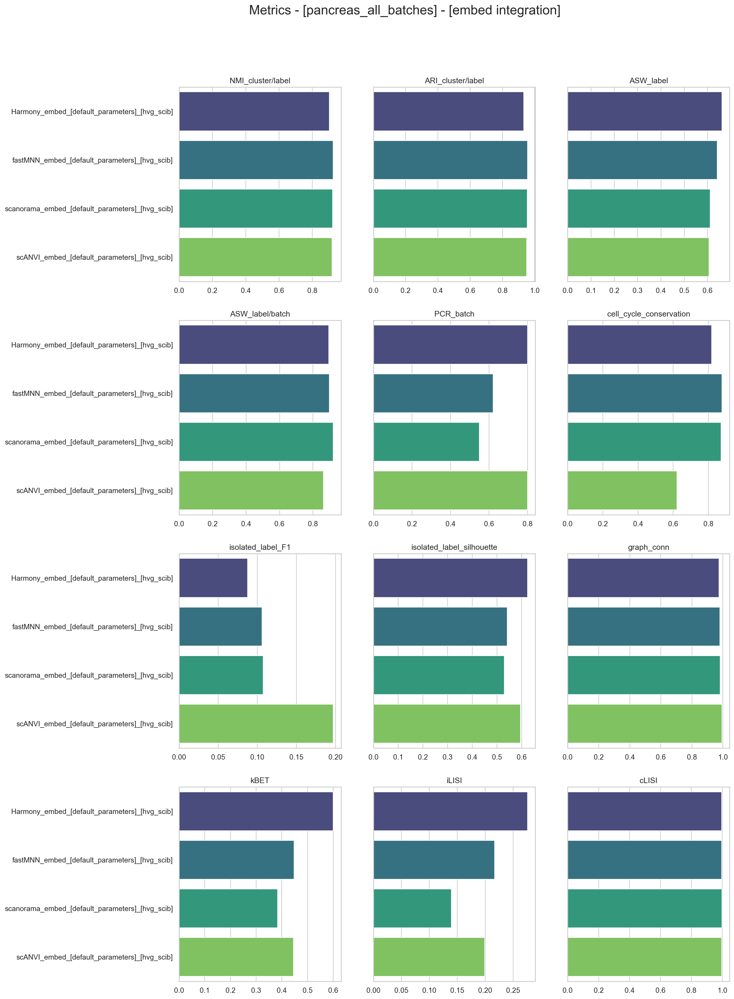

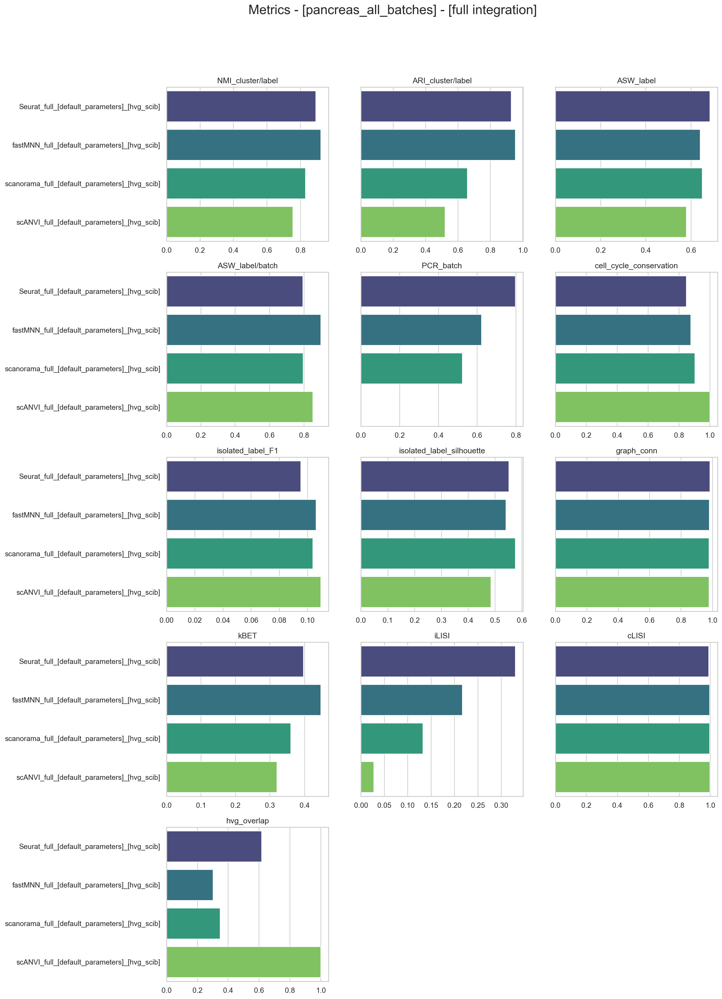

In [58]:
#for each dataset, and for each metric, plot a figure of a metric vs. methods.
for data_ in results_mb:
    for integration_type in ["embed","full"]: #split dataframes, so we compare the embedded-based versions and features-based versions
        full_scores=results_mb[data_].T.loc[[i for i in results_mb[data_].T.index if i.split("_")[1]==integration_type]].dropna(axis=1)

        numberof_methods=math.ceil(full_scores.columns.values.size/3)

        fig, axes = plt.subplots(numberof_methods, 3, figsize=(15, 25), sharey=True)
        fig.suptitle('Metrics - [{}_{}] - [{} integration]'.format(data_type,data_,integration_type),fontsize=20)

        axes_counter_x=0
        axes_counter_y=0
        sns.set_theme(style='whitegrid')

        for i in range(full_scores.columns.values.size):
            if(axes_counter_x!=0 and axes_counter_x%3==0):
                axes_counter_y+=1
                axes_counter_x=0
            sns.barplot(ax=axes[axes_counter_y,axes_counter_x], y = full_scores.index.values,
                    x = full_scores.iloc[:,i], palette='viridis')
            axes[axes_counter_y,axes_counter_x].set_title(full_scores.columns.values[i])
            axes[axes_counter_y,axes_counter_x].set(xlabel=None)
            axes_counter_x+=1

        #delete empty subplots
        del_empty_plot=3-axes_counter_x
        for i in range(del_empty_plot,axes_counter_x-1,-1):
            axes[axes_counter_y,i].set_axis_off()
        plt.show()
        print("\n\n\n\n")

# 6. Visualization of Pre-Computed Results for Multiple Batches

In [105]:
pre_computed_res_dir="output/{}/workshop/pre-computed_results/".format(data_type) #the folder where we store the results of the pre-integrated data
pre_computed_metrics={}
for m_i in os.listdir(pre_computed_res_dir): #list methods
    print("Load {}'s results: ".format(m_i))
    if ".DS_Store" in m_i:
        continue
    
    for object_i in os.listdir("{}/{}/".format(pre_computed_res_dir,m_i)):
        dt=re.findall(r'\[.*?\]', object_i)[0].replace("[","").replace("]",'')
        #If the file contains the metrics or scores obtained after evaluating the method
        if object_i[-12:] == "_metrics.csv":
            scores=pd.read_csv("{}/{}/{}".format(pre_computed_res_dir,m_i,object_i),sep=",",index_col=0)
            if dt not in pre_computed_metrics:
                pre_computed_metrics[dt]=scores
            else:
                pre_computed_metrics[dt]=pd.concat([pre_computed_metrics[dt],scores],axis=1)
    

Load scanorama's results: 
Load .DS_Store's results: 
Load Harmony's results: 
Load fastMNN's results: 
Load scANVI's results: 
Load Seurat's results: 


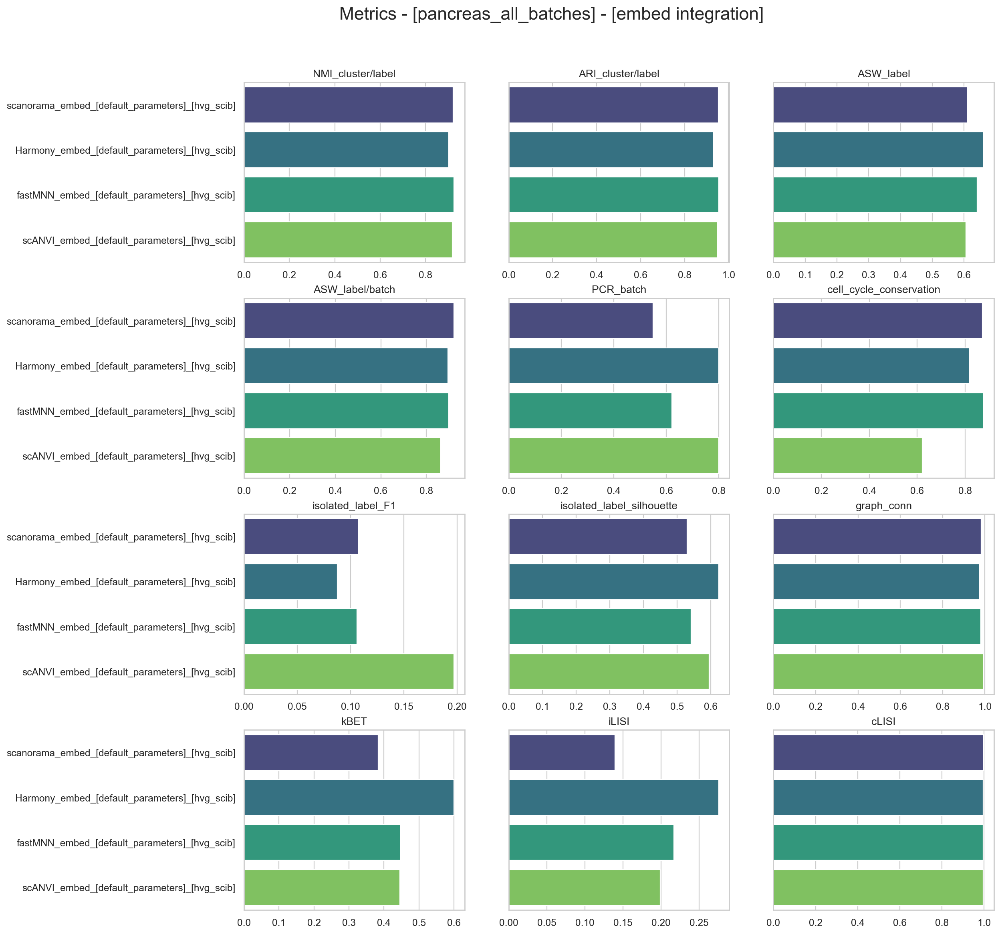

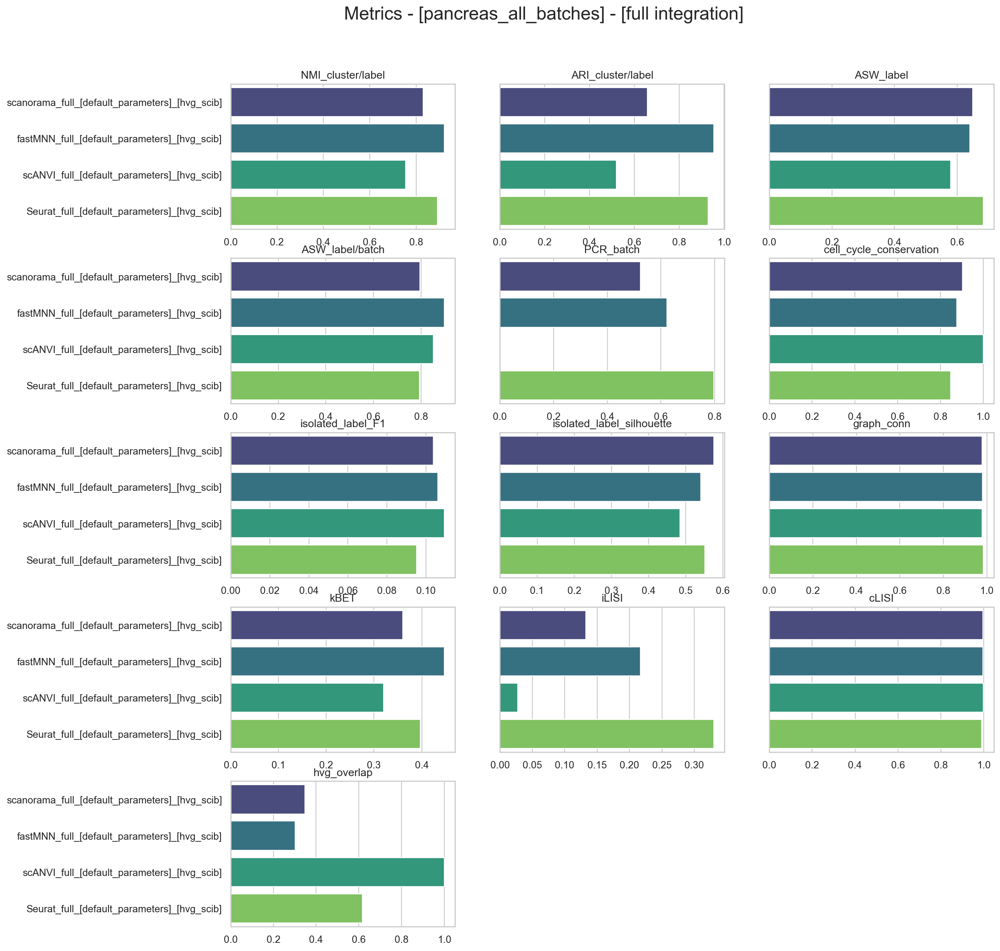

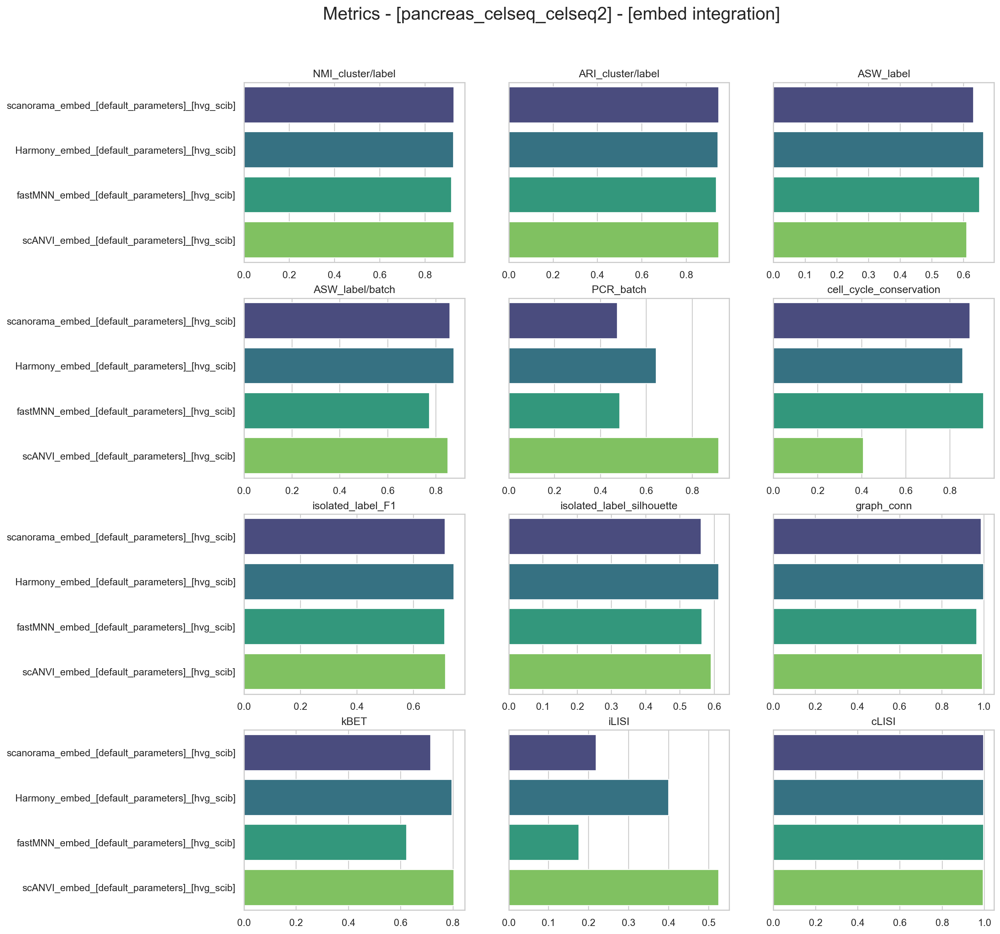

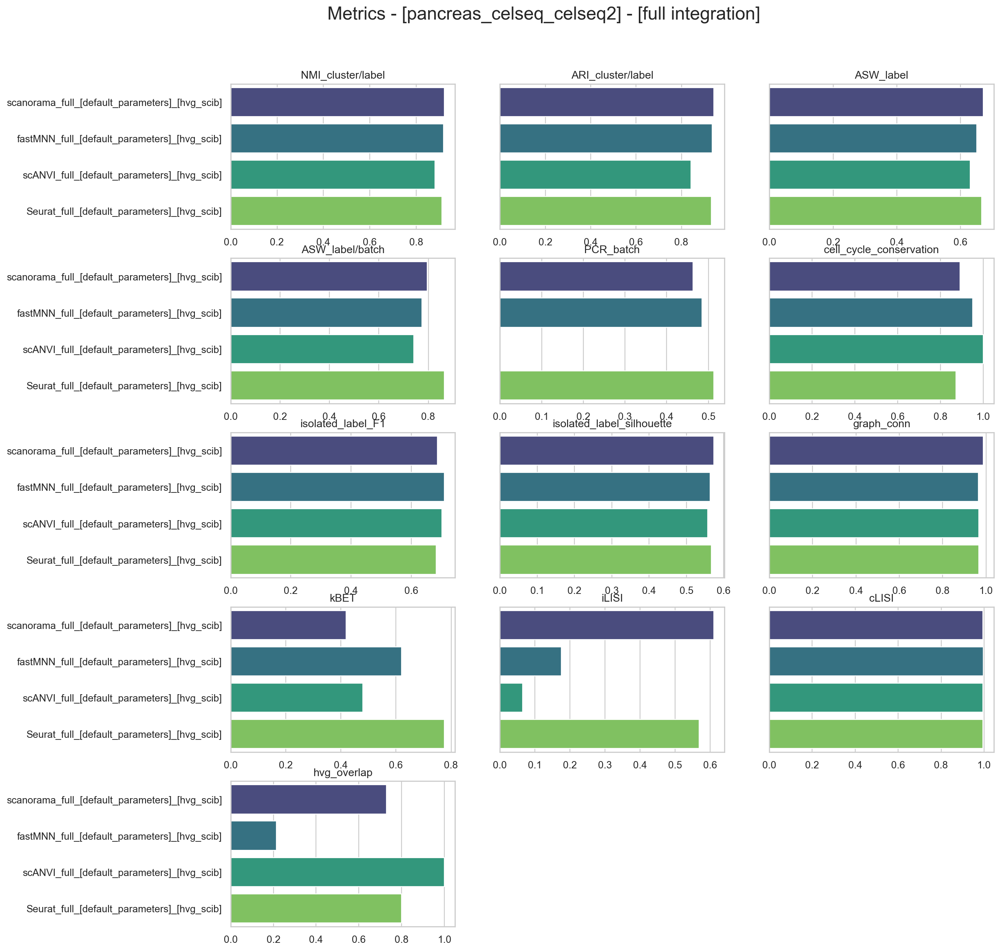

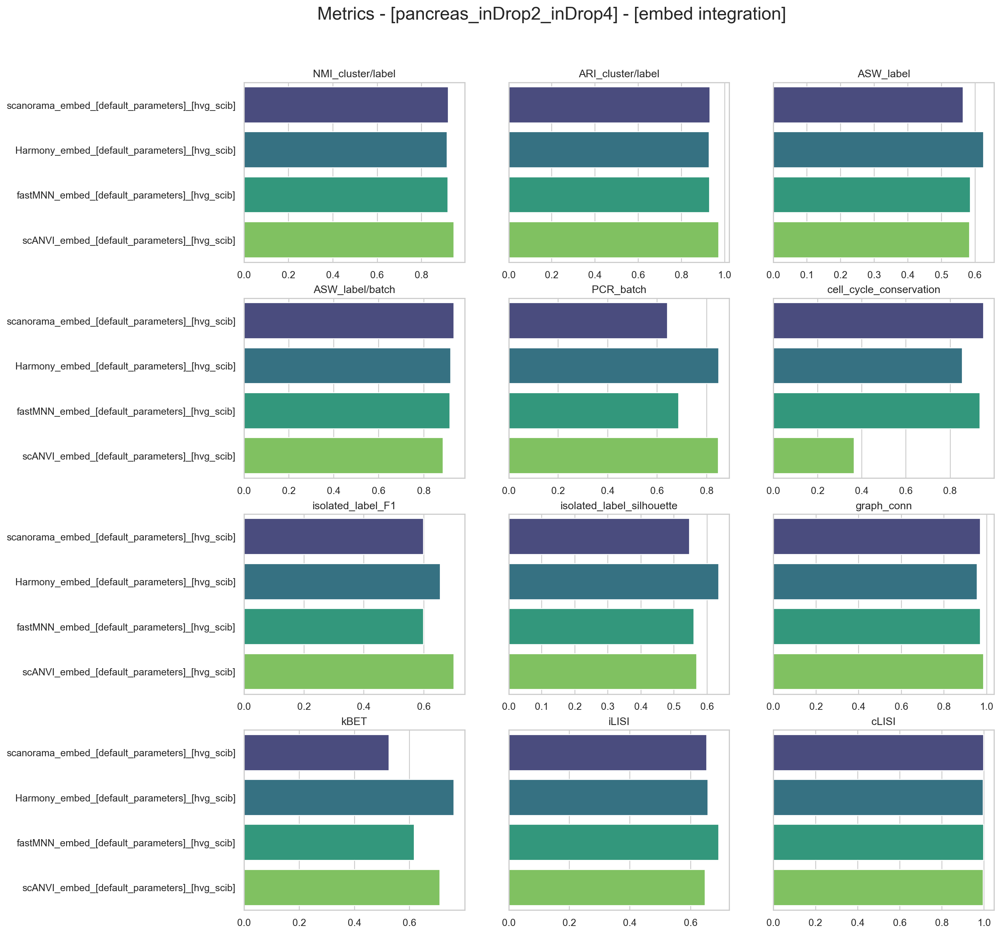

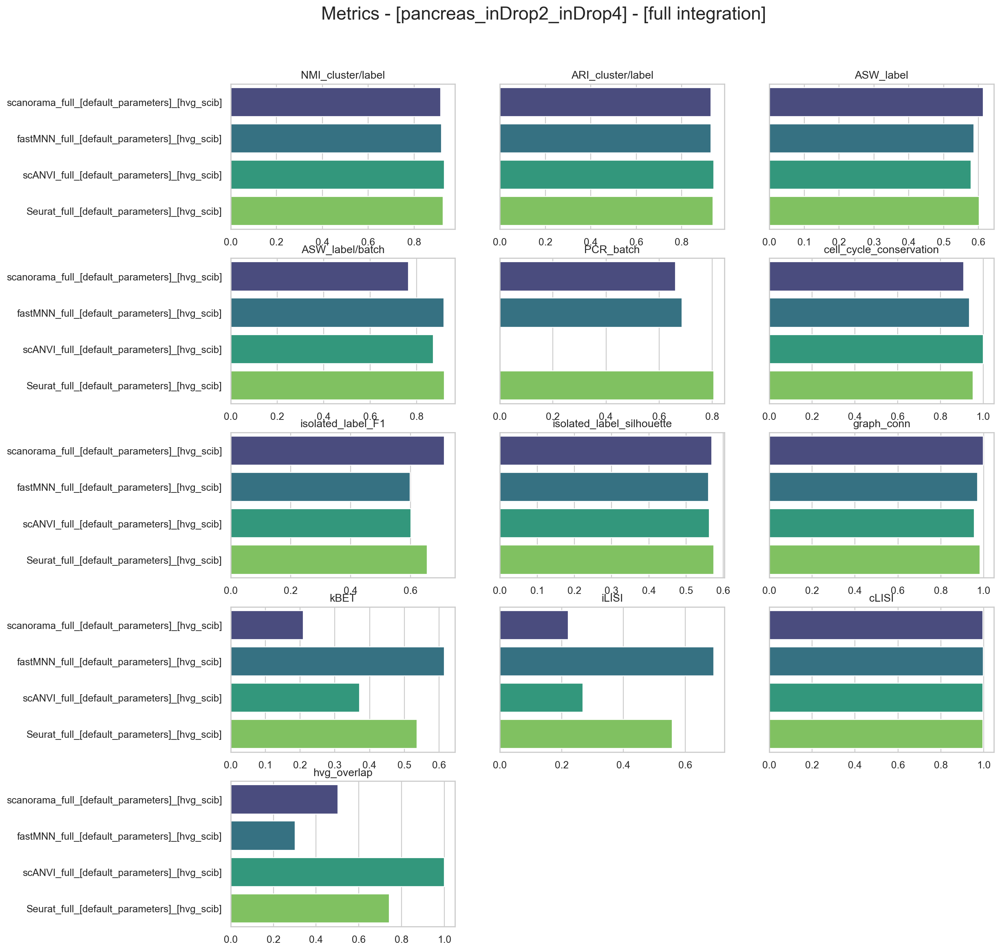

In [144]:
#for each dataset, and for each metric, plot a figure of a metric vs. methods.
for data_ in pre_computed_metrics:
    for integration_type in ["embed","full"]: #split dataframes, so we compare the embedded-based versions and features-based versions
        full_scores=pre_computed_metrics[data_].T.loc[[i for i in pre_computed_metrics[data_].T.index if i.split("_")[1]==integration_type]].dropna(axis=1)

        numberof_methods=math.ceil(full_scores.columns.values.size/3)

        fig, axes = plt.subplots(numberof_methods, 3, figsize=(15, 17), sharey=True)
        fig.suptitle('Metrics - [{}] - [{} integration]'.format(data_,integration_type),fontsize=20)

        axes_counter_x=0
        axes_counter_y=0
        sns.set_theme(style='whitegrid')

        for i in range(full_scores.columns.values.size):
            if(axes_counter_x!=0 and axes_counter_x%3==0):
                axes_counter_y+=1
                axes_counter_x=0
            sns.barplot(ax=axes[axes_counter_y,axes_counter_x], y = full_scores.index.values,
                    x = full_scores.iloc[:,i], palette='viridis')
            axes[axes_counter_y,axes_counter_x].set_title(full_scores.columns.values[i])
            axes[axes_counter_y,axes_counter_x].set(xlabel=None)
            axes_counter_x+=1

        #delete empty subplots
        del_empty_plot=3-axes_counter_x
        for i in range(del_empty_plot,axes_counter_x-1,-1):
            axes[axes_counter_y,i].set_axis_off()
        plt.show()
        print("\n\n\n\n")